In [93]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import math

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, GridSearchCV, validation_curve,learning_curve
from sklearn.metrics import confusion_matrix,roc_curve,auc
from sklearn.metrics import accuracy_score, classification_report
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import KMeans
from keras.models import Sequential
from keras.layers import Dense
from sklearn.base import BaseEstimator,TransformerMixin
from typing import Optional

import warnings
warnings.filterwarnings('ignore')

## DATA-PREPROCESSING

In [42]:
df= pd.read_csv("drug_consumption.data", sep=",",encoding='utf-8',float_precision='round_trip', header=None)
#We name the column with this : https://archive.ics.uci.edu/dataset/373/drug+consumption+quantified
df.columns=df_col = ['ID', 'Age', 'Gender', 'Education', 'Country', 'Ethnicity', 'Nscore', 'Escore', 'Oscore', 'Ascore', 'Cscore', 'Impulsive', 'SS', 'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth','Mushrooms', 'Nicotine', 'Semer', 'VSA']
df_mod=df.copy()
df

,ID,Age,Gender,Education,Country,Ethnicity,Nscore,Escore,Oscore,Ascore,...,Ecstasy,Heroin,Ketamin,Legalh,LSD,Meth,Mushrooms,Nicotine,Semer,VSA
0,1,0.49788,0.48246,-0.05921,0.96082,0.12600,0.31287,-0.57545,-0.58331,-0.91699,...,CL0,CL0,CL0,CL0,CL0,CL0,CL0,CL2,CL0,CL0
1,2,-0.07854,-0.48246,1.98437,0.96082,-0.31685,-0.67825,1.93886,1.43533,0.76096,...,CL4,CL0,CL2,CL0,CL2,CL3,CL0,CL4,CL0,CL0
2,3,0.49788,-0.48246,-0.05921,0.96082,-0.31685,-0.46725,0.80523,-0.84732,-1.62090,...,CL0,CL0,CL0,CL0,CL0,CL0,CL1,CL0,CL0,CL0
3,4,-0.95197,0.48246,1.16365,0.96082,-0.31685,-0.14882,-0.80615,-0.01928,0.59042,...,CL0,CL0,CL2,CL0,CL0,CL0,CL0,CL2,CL0,CL0
4,5,0.49788,0.48246,1.98437,0.96082,-0.31685,0.73545,-1.63340,-0.45174,-0.30172,...,CL1,CL0,CL0,CL1,CL0,CL0,CL2,CL2,CL0,CL0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1880,1884,-0.95197,0.48246,-0.61113,-0.57009,-0.31685,-1.19430,1.74091,1.88511,0.76096,...,CL0,CL0,CL0,CL3,CL3,CL0,CL0,CL0,CL0,CL5
1881,1885,-0.95197,-0.48246,-0.61113,-0.57009,-0.31685,-0.24649,1.74091,0.58331,0.76096,...,CL2,CL0,CL0,CL3,CL5,CL4,CL4,CL5,CL0,CL0
1882,1886,-0.07854,0.48246,0.45468,-0.57009,-0.31685,1.13281,-1.37639,-1.27553,-1.77200,...,CL4,CL0,CL2,CL0,CL2,CL0,CL2,CL6,CL0,CL0
1883,1887,-0.95197,0.48246,-0.61113,-0.57009,-0.31685,0.91093,-1.92173,0.29338,-1.62090,...,CL3,CL0,CL0,CL3,CL3,CL0,CL3,CL4,CL0,CL0


In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1885 entries, 0 to 1884
Data columns (total 32 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         1885 non-null   int64  
 1   Age        1885 non-null   float64
 2   Gender     1885 non-null   float64
 3   Education  1885 non-null   float64
 4   Country    1885 non-null   float64
 5   Ethnicity  1885 non-null   float64
 6   Nscore     1885 non-null   float64
 7   Escore     1885 non-null   float64
 8   Oscore     1885 non-null   float64
 9   Ascore     1885 non-null   float64
 10  Cscore     1885 non-null   float64
 11  Impulsive  1885 non-null   float64
 12  SS         1885 non-null   float64
 13  Alcohol    1885 non-null   object 
 14  Amphet     1885 non-null   object 
 15  Amyl       1885 non-null   object 
 16  Benzos     1885 non-null   object 
 17  Caff       1885 non-null   object 
 18  Canabis    1885 non-null   object 
 19  Choc       1885 non-null   object 
 20  Coke    

In [44]:
df.isnull().sum()

ID           0
Age          0
Gender       0
Education    0
Country      0
Ethnicity    0
Nscore       0
Escore       0
Oscore       0
Ascore       0
Cscore       0
Impulsive    0
SS           0
Alcohol      0
Amphet       0
Amyl         0
Benzos       0
Caff         0
Canabis      0
Choc         0
Coke         0
Crack        0
Ecstasy      0
Heroin       0
Ketamin      0
Legalh       0
LSD          0
Meth         0
Mushrooms    0
Nicotine     0
Semer        0
VSA          0
dtype: int64

In [45]:
df.drop(df.columns[[0]], axis=1, inplace=True)
df

,Age,Gender,Education,Country,Ethnicity,Nscore,Escore,Oscore,Ascore,Cscore,...,Ecstasy,Heroin,Ketamin,Legalh,LSD,Meth,Mushrooms,Nicotine,Semer,VSA
0,0.49788,0.48246,-0.05921,0.96082,0.12600,0.31287,-0.57545,-0.58331,-0.91699,-0.00665,...,CL0,CL0,CL0,CL0,CL0,CL0,CL0,CL2,CL0,CL0
1,-0.07854,-0.48246,1.98437,0.96082,-0.31685,-0.67825,1.93886,1.43533,0.76096,-0.14277,...,CL4,CL0,CL2,CL0,CL2,CL3,CL0,CL4,CL0,CL0
2,0.49788,-0.48246,-0.05921,0.96082,-0.31685,-0.46725,0.80523,-0.84732,-1.62090,-1.01450,...,CL0,CL0,CL0,CL0,CL0,CL0,CL1,CL0,CL0,CL0
3,-0.95197,0.48246,1.16365,0.96082,-0.31685,-0.14882,-0.80615,-0.01928,0.59042,0.58489,...,CL0,CL0,CL2,CL0,CL0,CL0,CL0,CL2,CL0,CL0
4,0.49788,0.48246,1.98437,0.96082,-0.31685,0.73545,-1.63340,-0.45174,-0.30172,1.30612,...,CL1,CL0,CL0,CL1,CL0,CL0,CL2,CL2,CL0,CL0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1880,-0.95197,0.48246,-0.61113,-0.57009,-0.31685,-1.19430,1.74091,1.88511,0.76096,-1.13788,...,CL0,CL0,CL0,CL3,CL3,CL0,CL0,CL0,CL0,CL5
1881,-0.95197,-0.48246,-0.61113,-0.57009,-0.31685,-0.24649,1.74091,0.58331,0.76096,-1.51840,...,CL2,CL0,CL0,CL3,CL5,CL4,CL4,CL5,CL0,CL0
1882,-0.07854,0.48246,0.45468,-0.57009,-0.31685,1.13281,-1.37639,-1.27553,-1.77200,-1.38502,...,CL4,CL0,CL2,CL0,CL2,CL0,CL2,CL6,CL0,CL0
1883,-0.95197,0.48246,-0.61113,-0.57009,-0.31685,0.91093,-1.92173,0.29338,-1.62090,-2.57309,...,CL3,CL0,CL0,CL3,CL3,CL0,CL3,CL4,CL0,CL0


In [46]:
df= pd.read_csv("drug_consumption.data", sep=",",encoding='utf-8',float_precision='round_trip', header=None)
df.columns=df_col = ['ID', 'Age', 'Gender', 'Education', 'Country', 'Ethnicity', 'Nscore', 'Escore', 'Oscore', 'Ascore', 'Cscore', 'Impulsive', 'SS', 'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth','Mushrooms', 'Nicotine', 'Semer', 'VSA']
df_users=df.copy()

age_mapping = {-0.95197: "18-24", -0.07854: "25-34", 0.49788: "35-40", 1.09449: "45-54", 1.82213: "55-64", 2.59171: "65+"}
gender_mapping = {-0.48246: "M", 0.48246: "F"}
education_mapping = {-2.43591: "Left school before 16 years", -1.73790: "Left school at 16 years", -1.43719: "Left school at 17 years", -1.22751: "Left school at 18 years", -0.61113: "Some college or university, no certificate or degree", -0.05921: "Professional certificate/diploma", 0.45468: "University degree", 1.16365: "Masters degree", 1.98437: "Doctorate degree"}
country_mapping = {-0.09765: "Australia", 0.24923: "Canada", -0.46841: "New Zealand", -0.28519: "Other", 0.21128: "Republic of Ireland", 0.96082: "UK", -0.57009: "USA"}
ethnicity_mapping = {-0.50212: "Asian", -1.10702: "Black", 1.90725: "Mixed Black/Asian", 0.12600: "Mixed White/Asian", -0.22166: "Mixed White/Black", 0.11440: "Other", -0.31685: "White"}

df['Age'] = df['Age'].map(age_mapping)
df['Gender'] = df['Gender'].map(gender_mapping)
df['Education'] = df['Education'].map(education_mapping)
df['Country'] = df['Country'].map(country_mapping)
df['Ethnicity'] = df['Ethnicity'].map(ethnicity_mapping)
df_uu=df.copy()
#Drugs
for i in range (0, len(df.columns)):
    df.iloc[:, i] = df.iloc[:, i].replace(['CL0'],'Never')
    df.iloc[:, i] = df.iloc[:, i].replace(['CL1'],'Decade Ago')
    df.iloc[:, i] = df.iloc[:, i].replace(['CL2'],'Last Decade')
    df.iloc[:, i] = df.iloc[:, i].replace(['CL3'],'Last Year')
    df.iloc[:, i] = df.iloc[:, i].replace(['CL4'],'Last Month')
    df.iloc[:, i] = df.iloc[:, i].replace(['CL5'],'Last Week')
    df.iloc[:, i] = df.iloc[:, i].replace(['CL6'],'Last Day')


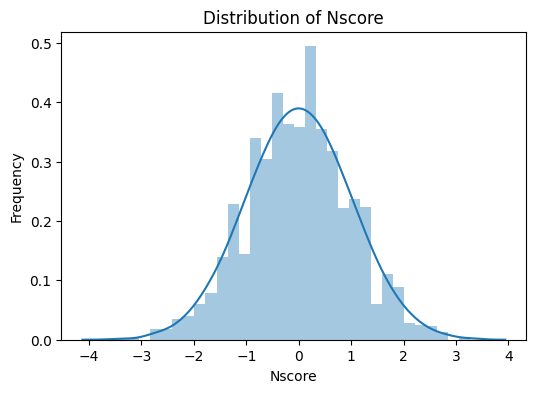

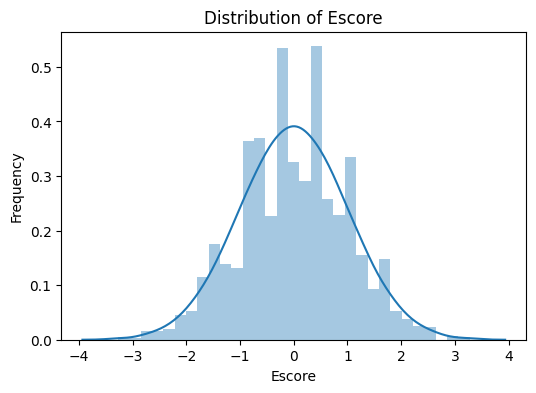

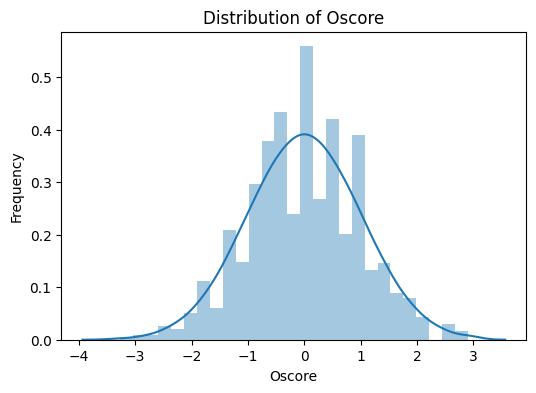

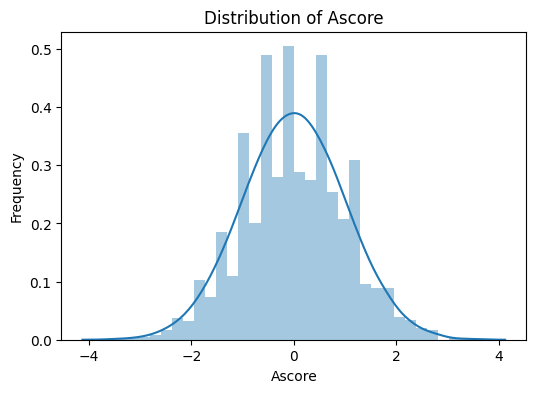

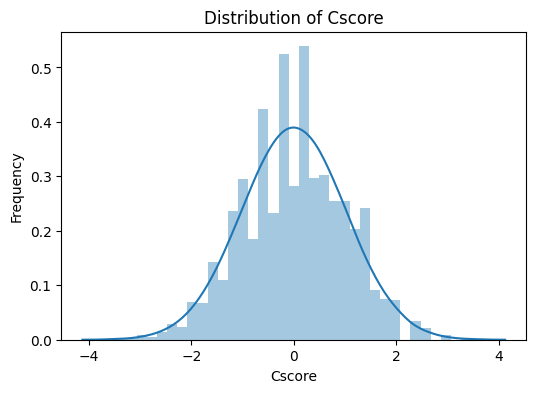

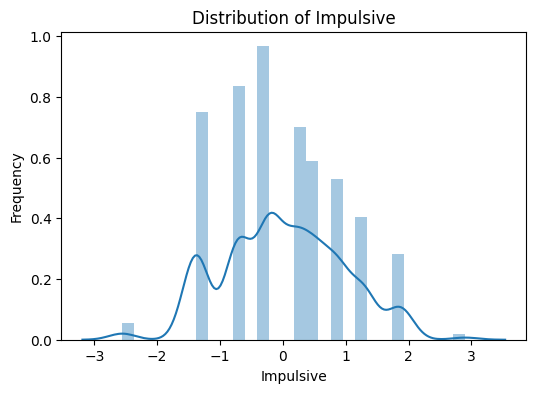

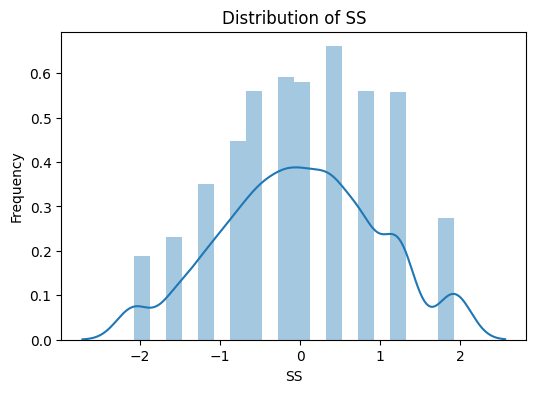

In [47]:
#Let's chek if the scores are normalized
k=0
for i in df:
    if k>5 and k<13:
        fig = plt.figure(figsize=(6,4))
        sns.distplot(df[i])
        plt.title(f"Distribution of {i}")

        plt.ylabel("Frequency")
        plt.show()
    k+=1

In [97]:
#Encoding
class CustomOneHotEncoder(BaseEstimator,TransformerMixin):
    def __init__(self, columns : list = None, top_categories : Optional[int] = None):
        self.columns = columns
        self.top_categories = top_categories

    def fit(self, X: pd.DataFrame, y: Optional[pd.Series]= None):

        columns = (
            X.select_dtypes(['object', 'category']).columns
            if self.columns is None else
            self.columns
        )
        self.encoder_onehot = {}

        for var in columns:
            if self.top_categories:
                self.encoder_onehot[var] = [
                    x
                    for x in X[var]
                    .value_counts()
                    .sort_values(ascending=False)
                    .head(self.top_categories)
                    .index
                ]
                #Sort back the order
                self.encoder_onehot = {col:sorted(self.encoder_onehot[col]) for col in self.encoder_onehot.keys()}
            else:
                category_ls = list(X[var].unique())
                self.encoder_onehot[var] = category_ls

        self.variables_binary_ = [var for var in columns if X[var].nunique() == 2]

        return self
    
    def transform(self, X: pd.DataFrame) -> pd.DataFrame:
        for feature in self.columns:
            for category in self.encoder_onehot[feature]:
                X[f"{feature}_{category}"] = np.where(X[feature] == category, 1, 0)

        # drop the original non-encoded variables.
        X.drop(labels=self.columns, axis=1, inplace=True)

        return X

In [98]:
df_enc = df.copy()

X = df_enc.iloc[:, df_enc.columns != 'Heroin']
y = df_enc[['Heroin']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=50)

encoder = CustomOneHotEncoder(columns=['Age', 'Gender', 'Education', 'Country'])
encoder.fit(X_train, y_train)

X_train = encoder.transform(X_train)
X_test = encoder.transform(X_test)


print(X_train.head())

        ID Ethnicity   Nscore   Escore   Oscore   Ascore   Cscore  Impulsive  \
19      20     White -0.34799 -1.76250 -2.39883 -1.92595  0.75830   -1.37983   
313    316     White -0.79151  0.80523  0.58331 -0.01729  0.41594   -0.71126   
1363  1367     White  0.13606 -0.30033 -0.01928 -1.77200 -2.18109    1.29221   
1883  1887     White  0.91093 -1.92173  0.29338 -1.62090 -2.57309    1.29221   
456    459     White  0.62967  0.00332  0.14143  0.59042  0.12331   -0.21712   

           SS     Alcohol  ... Education_Masters degree  \
19   -2.07848  Last Month  ...                        0   
313  -0.52593   Last Week  ...                        0   
1363  0.40148    Last Day  ...                        0   
1883  1.22470   Last Week  ...                        0   
456   0.07987    Last Day  ...                        0   

     Education_Left school at 17 years Education_Left school before 16 years  \
19                                   0                                     0   
313 

## DATA VISUALIZATION

In [48]:
df.columns

Index(['ID', 'Age', 'Gender', 'Education', 'Country', 'Ethnicity', 'Nscore',
       'Escore', 'Oscore', 'Ascore', 'Cscore', 'Impulsive', 'SS', 'Alcohol',
       'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack',
       'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms',
       'Nicotine', 'Semer', 'VSA'],
      dtype='object')

First, let's see how the data is distributed.

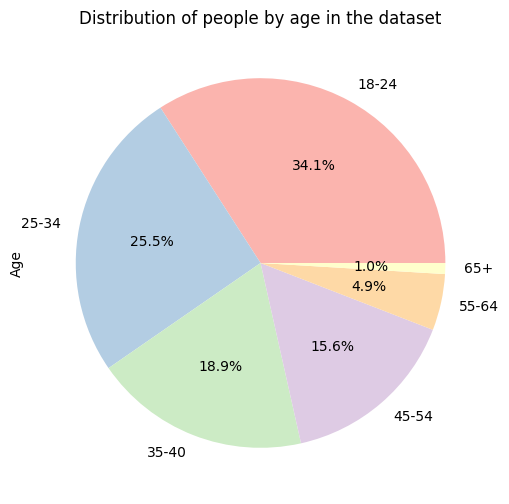

In [49]:
age_counts = df["Age"].value_counts()

plt.figure(figsize=(6, 6))
age_counts.plot.pie(autopct='%1.1f%%', colors=plt.cm.Pastel1.colors)

plt.title("Distribution of people by age in the dataset")

plt.show()

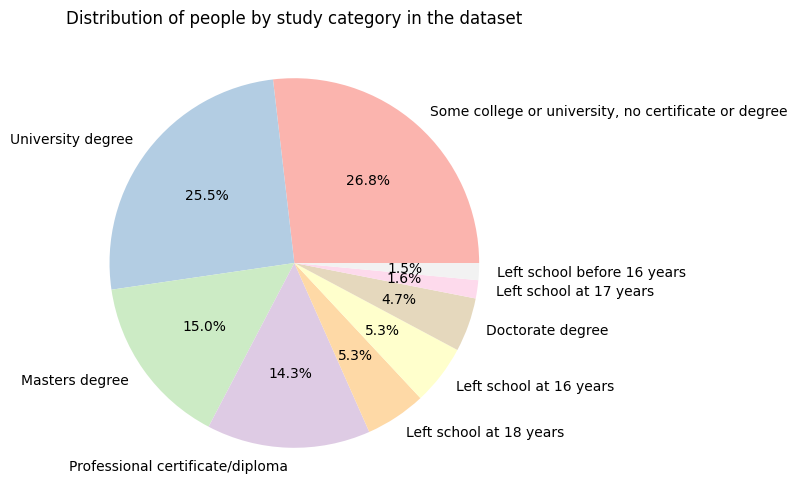

In [50]:
education_counts = df["Education"].value_counts()

plt.figure(figsize=(6, 6))
education_counts.plot.pie(autopct='%1.1f%%', colors=plt.cm.Pastel1.colors)

plt.title("Distribution of people by study category in the dataset")
plt.ylabel("")

plt.show()

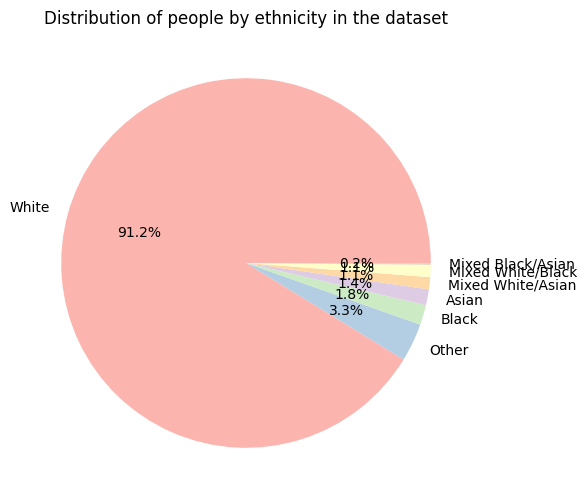

In [51]:
education_counts = df["Ethnicity"].value_counts()

plt.figure(figsize=(6, 6))
education_counts.plot.pie(autopct='%1.1f%%', colors=plt.cm.Pastel1.colors)

plt.title("Distribution of people by ethnicity in the dataset")
plt.ylabel("")

plt.show()

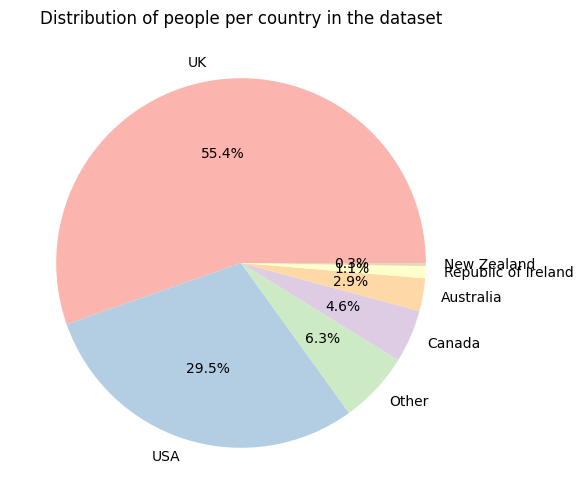

In [52]:
country_counts = df["Country"].value_counts()

plt.figure(figsize=(6, 6))
country_counts.plot.pie(autopct='%1.1f%%', colors=plt.cm.Pastel1.colors)

plt.title("Distribution of people per country in the dataset")
plt.ylabel("")

plt.show()

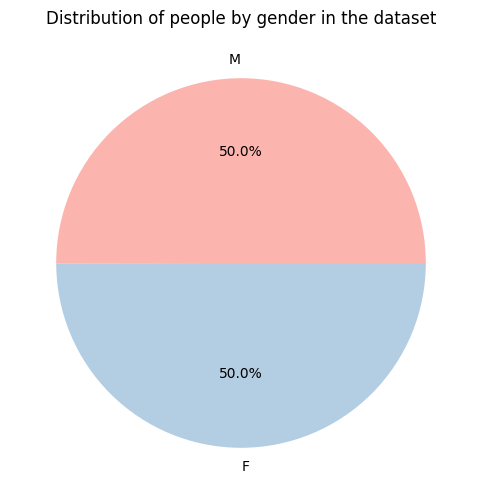

In [53]:
gender_counts = df["Gender"].value_counts()

plt.figure(figsize=(6, 6))
gender_counts.plot.pie(autopct='%1.1f%%', colors=plt.cm.Pastel1.colors)

plt.title("Distribution of people by gender in the dataset")
plt.ylabel("")

plt.show()

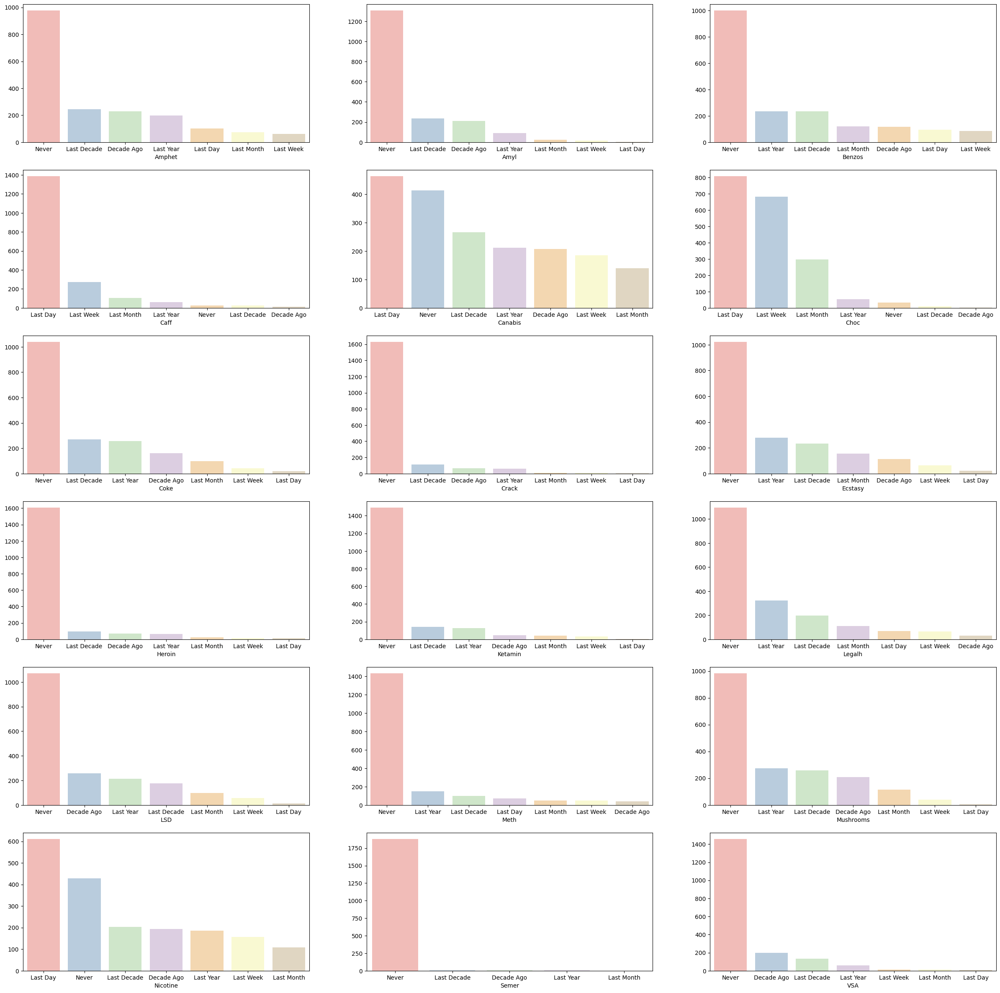

In [54]:
# To see the proportion for each category
k=14
columns=df_col[13:]
fig, axs=plt.subplots(6,3,figsize=(30,30))
for i in range (6):
    for j in range (3):
        a=df.value_counts(df.iloc[:,k])
        sns.barplot(x=a.index,y =a,ax=axs[i][j], palette=plt.cm.Pastel1.colors)
        k+=1
plt.show()

Now, let's see the drug consumption according to certain groups of people.

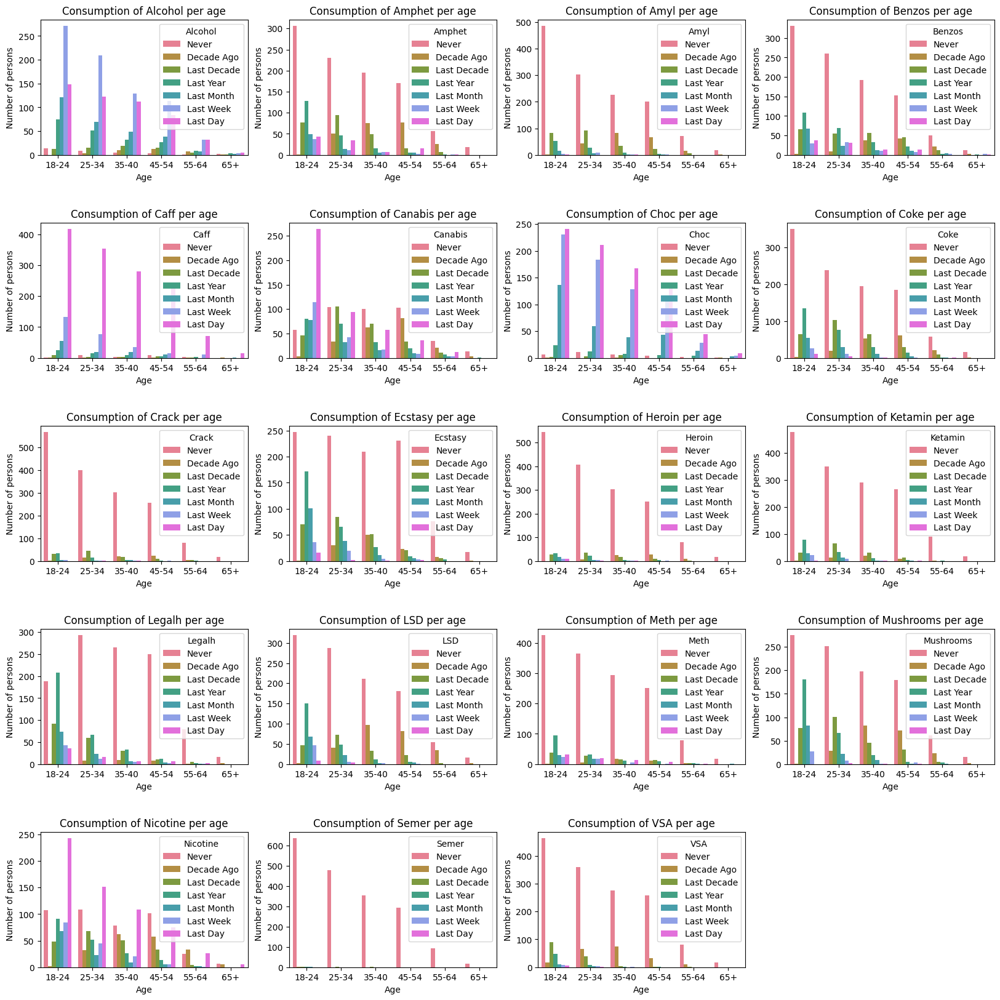

In [55]:
drogues = ['Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack',
           'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']

age_order = ['18-24', '25-34', '35-40','45-54', '55-64','65+']
df['Age'] = pd.Categorical(df['Age'], categories=age_order, ordered=True)

consommation_order = ['Never', 'Decade Ago', 'Last Decade', 'Last Year', 'Last Month', 'Last Week', 'Last Day']

fig, axs = plt.subplots(5, 4, figsize=(20, 20))
colors = sns.color_palette('husl', n_colors=len(consommation_order))

plt.subplots_adjust(hspace=0.5)

for i, drogue in enumerate(drogues):
    hue_order = pd.Categorical(df[drogue], categories=consommation_order, ordered=True)
    
    sns.countplot(x='Age', hue=hue_order, data=df, order=age_order, palette=colors, ax=axs[i // 4, i % 4])
    
    axs[i // 4, i % 4].set_title(f'Consumption of {drogue} per age')
    axs[i // 4, i % 4].set_xlabel('Age')
    axs[i // 4, i % 4].set_ylabel('Number of persons')
    axs[i // 4, i % 4].legend(title=drogue, loc='upper right')

if len(drogues) % 2 == 1:
    axs[-1, -1].axis('off')
    
plt.show()

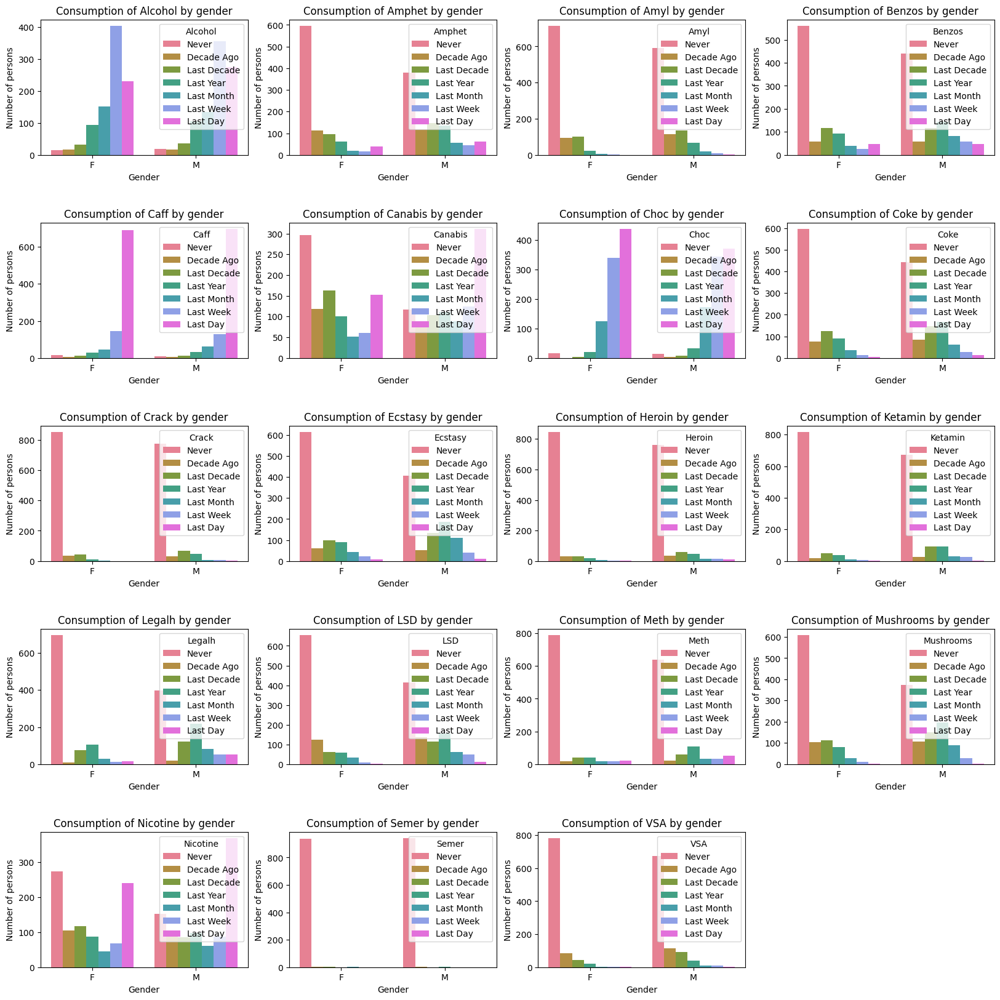

In [56]:
fig, axs = plt.subplots(5, 4, figsize=(20, 20))
plt.subplots_adjust(hspace=0.5)

for i, drogue in enumerate(drogues):
    hue_order = pd.Categorical(df[drogue], categories=consommation_order, ordered=True)
    
    sns.countplot(x='Gender', hue=hue_order, data=df, palette=colors, ax=axs[i // 4, i % 4])
    
    axs[i // 4, i % 4].set_title(f'Consumption of {drogue} by gender')
    axs[i // 4, i % 4].set_xlabel('Gender')
    axs[i // 4, i % 4].set_ylabel('Number of persons')
    axs[i // 4, i % 4].legend(title=drogue, loc='upper right')
    
if len(drogues) % 2 == 1:
    axs[-1, -1].axis('off')

plt.show()

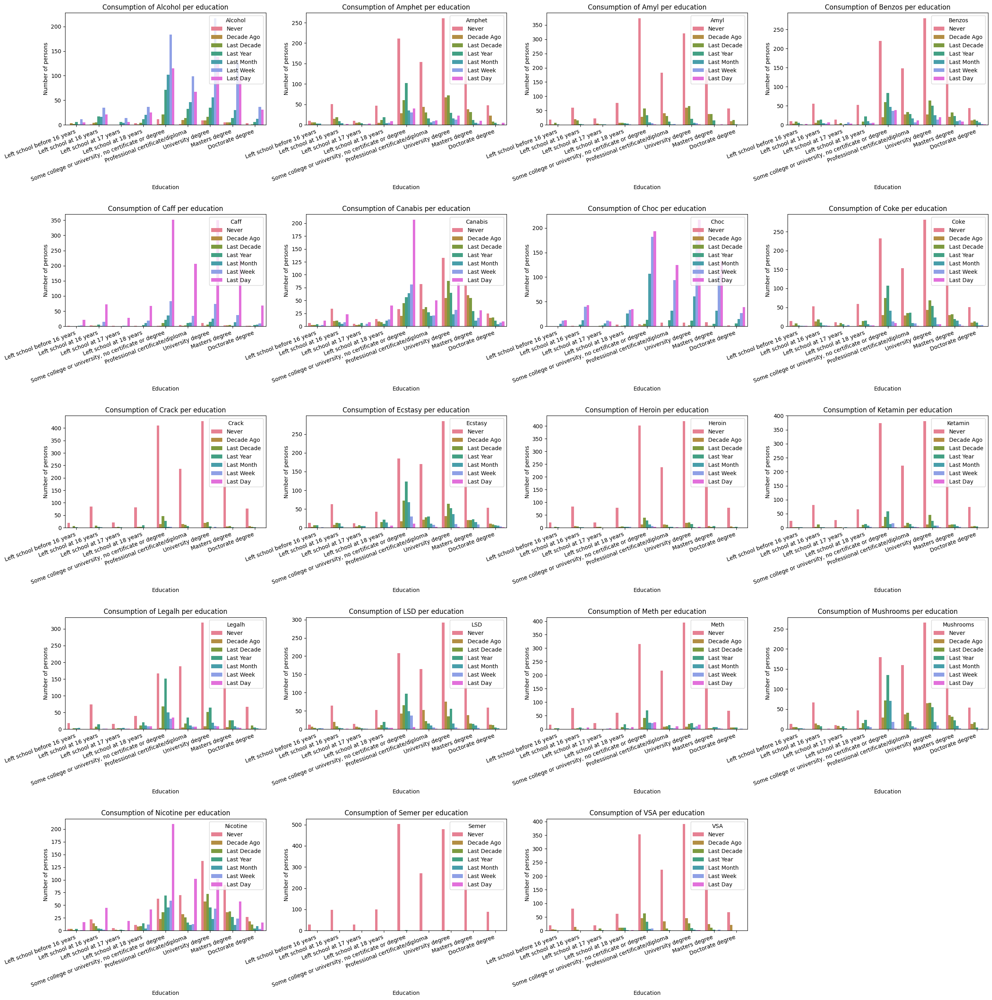

In [57]:
education_order=["Left school before 16 years", "Left school at 16 years","Left school at 17 years", 
                        "Left school at 18 years","Some college or university, no certificate or degree",
                        "Professional certificate/diploma","University degree","Masters degree","Doctorate degree"]

fig, axs = plt.subplots(5, 4, figsize=(30, 30))
plt.subplots_adjust(hspace=0.8)

for i, drogue in enumerate(drogues):
    hue_order = pd.Categorical(df[drogue], categories=consommation_order, ordered=True)
    
    sns.countplot(x='Education', hue=hue_order, data=df, order=education_order, palette=colors, ax=axs[i // 4, i % 4])
    
    axs[i // 4, i % 4].set_title(f'Consumption of {drogue} per education')
    axs[i // 4, i % 4].set_xlabel('Education')
    axs[i // 4, i % 4].set_ylabel('Number of persons')
    axs[i // 4, i % 4].legend(title=drogue, loc='upper right')
    
    axs[i // 4, i % 4].set_xticklabels(axs[i // 4, i % 4].get_xticklabels(), rotation=20, ha='right')

if len(drogues) % 2 == 1:
    axs[-1, -1].axis('off')

plt.show()

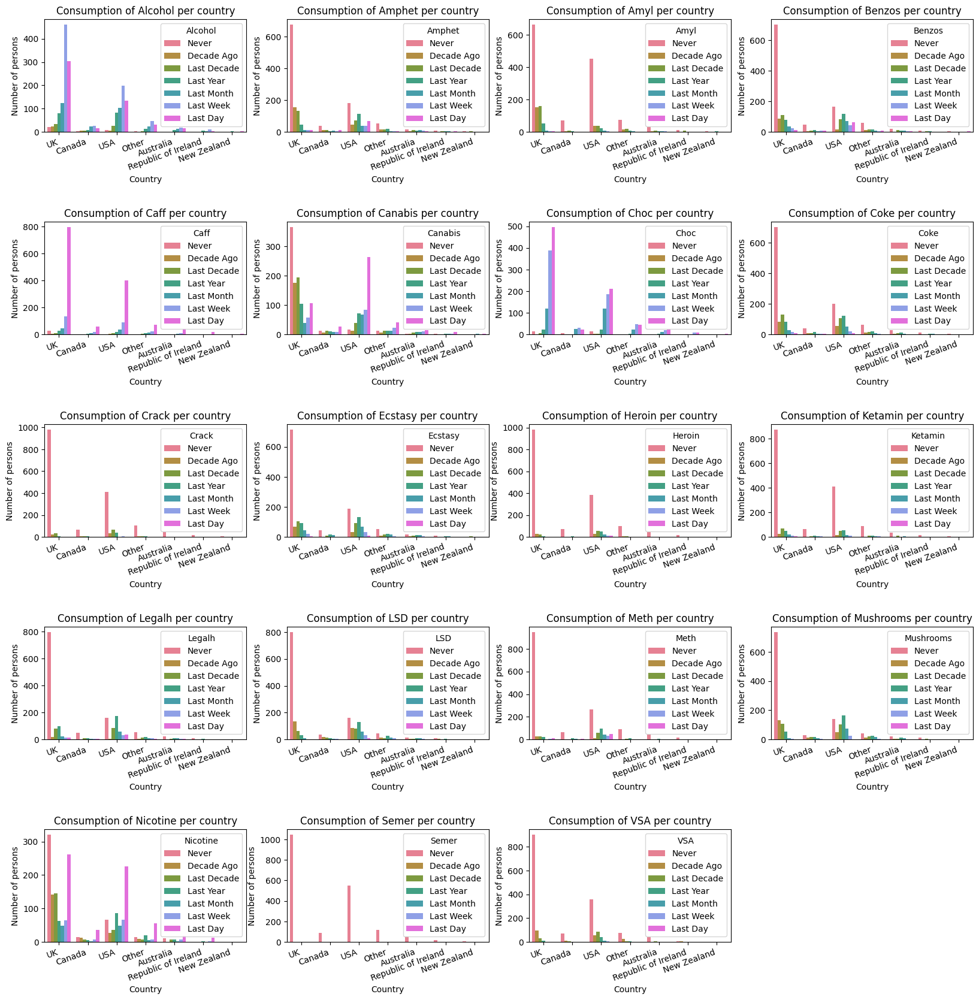

In [58]:
fig, axs = plt.subplots(5, 4, figsize=(20, 20))
plt.subplots_adjust(hspace=0.8)

for i, drogue in enumerate(drogues):
    hue_order = pd.Categorical(df[drogue], categories=consommation_order, ordered=True)
    
    sns.countplot(x='Country', hue=hue_order, data=df, palette=colors, ax=axs[i // 4, i % 4])
    
    axs[i // 4, i % 4].set_title(f'Consumption of {drogue} per country')
    axs[i // 4, i % 4].set_xlabel('Country')
    axs[i // 4, i % 4].set_ylabel('Number of persons')
    axs[i // 4, i % 4].legend(title=drogue, loc='upper right')
    axs[i // 4, i % 4].set_xticklabels(axs[i // 4, i % 4].get_xticklabels(), rotation=20, ha='right')

if len(drogues) % 2 == 1:
    axs[-1, -1].axis('off')

plt.show()

In [59]:
#New dataframe in order to distinguish users and non-users
for i in range (0, 32):
    #CL0=Never
    #CL1=Decade Ago
    #CL2=Last Decade
    #CL3=Last Year
    #CL4=Last Month
    #CL5=Last Week
    #CL6=Last Day
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL0'], 0)
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL1'], 0) 
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL2'], 1)
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL3'], 1)
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL4'], 1)
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL4'], 1)
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL5'], 1)
    df_users.iloc[:, i]=df_users.iloc[:, i].replace(['CL6'], 1)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL0'], 0)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL1'], 0) 
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL2'], 1)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL3'], 1)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL4'], 1)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL4'], 1)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL5'], 1)
    df_uu.iloc[:, i]=df_uu.iloc[:, i].replace(['CL6'], 1)
    


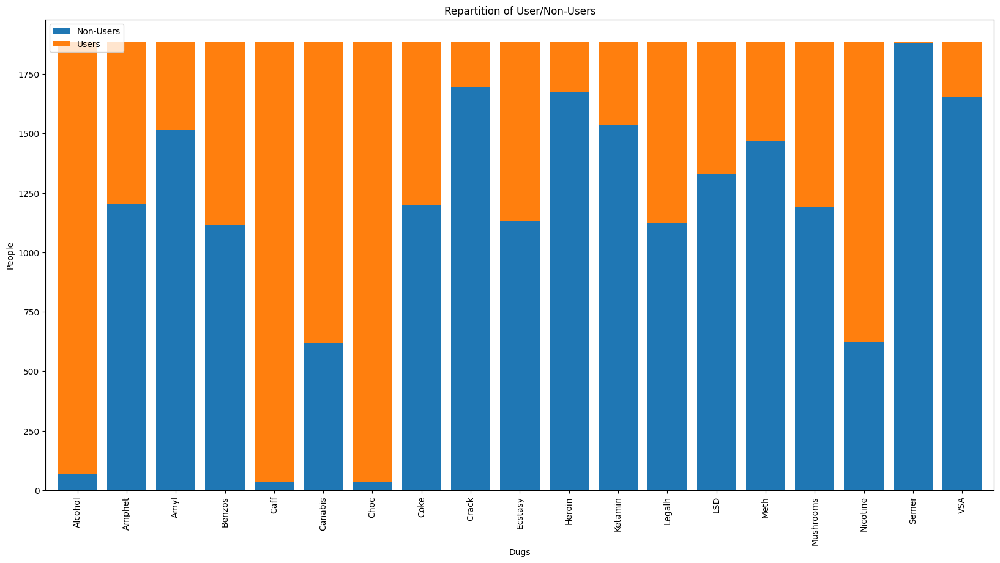

In [60]:
totals=df_users.iloc[:, 13:].apply(pd.Series.value_counts).fillna(0).astype(int).T
totals.columns=['Non-Users','Users']
ax=totals.plot(kind='bar',stacked=True,width=0.8,figsize=(20, 10))
plt.title('Repartition of User/Non-Users')
plt.xlabel('Dugs')
plt.ylabel('People')
plt.show()

In [61]:
df_users["User"] = df_users[drogues].sum(axis=1)
df_users.head()

,ID,Age,Gender,Education,Country,Ethnicity,Nscore,Escore,Oscore,Ascore,...,Heroin,Ketamin,Legalh,LSD,Meth,Mushrooms,Nicotine,Semer,VSA,User
0,1,0.49788,0.48246,-0.05921,0.96082,0.12600,0.31287,-0.57545,-0.58331,-0.91699,...,0,0,0,0,0,0,1,0,0,6
1,2,-0.07854,-0.48246,1.98437,0.96082,-0.31685,-0.67825,1.93886,1.43533,0.76096,...,0,1,0,1,1,0,1,0,0,12
2,3,0.49788,-0.48246,-0.05921,0.96082,-0.31685,-0.46725,0.80523,-0.84732,-1.62090,...,0,0,0,0,0,0,0,0,0,4
3,4,-0.95197,0.48246,1.16365,0.96082,-0.31685,-0.14882,-0.80615,-0.01928,0.59042,...,0,1,0,0,0,0,1,0,0,8
4,5,0.49788,0.48246,1.98437,0.96082,-0.31685,0.73545,-1.63340,-0.45174,-0.30172,...,0,0,0,0,0,1,1,0,0,6


In [62]:
df_users1=df_users.copy()
df_users_base=df_users.copy()
df_users0711=df_users.copy()
df_users.loc[(df_users['Gender']==-0.48246),'Gender']="M"
df_users.loc[(df_users['Gender']==0.48246),'Gender']="F"
df_users = df_users.groupby(['Gender']).sum()
df_users.head()

,ID,Age,Education,Country,Ethnicity,Nscore,Escore,Oscore,Ascore,Cscore,...,Heroin,Ketamin,Legalh,LSD,Meth,Mushrooms,Nicotine,Semer,VSA,User
Gender,,,,,,,,,,,,,,,,,,,,,
F,877386,123.87880,172.56874,477.63592,-291.81175,70.24575,54.23012,-123.49240,206.29213,172.42188,...,66,106,237,165,135,231,561,4,75,6147
M,904495,-58.63904,-179.74322,192.56107,-291.74128,-70.15790,-54.53700,122.48506,-206.75389,-173.14962,...,146,244,525,392,282,463,703,2,155,8572


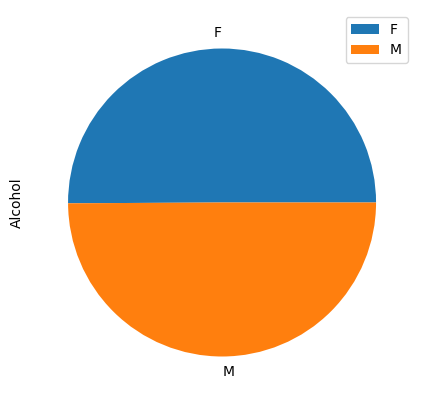

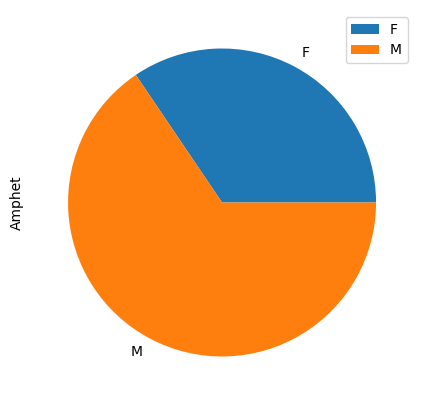

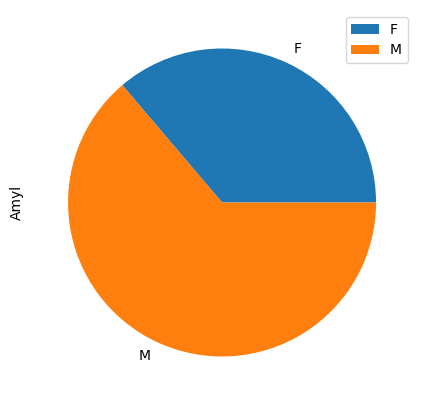

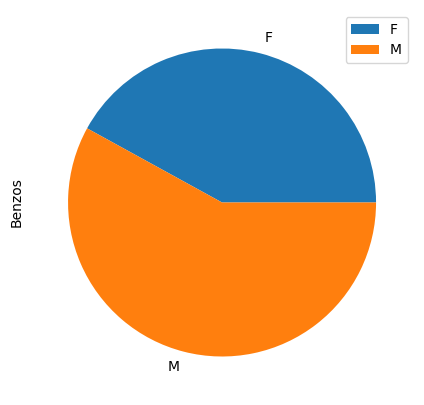

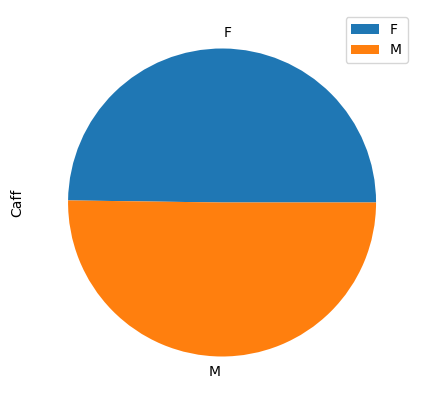

...

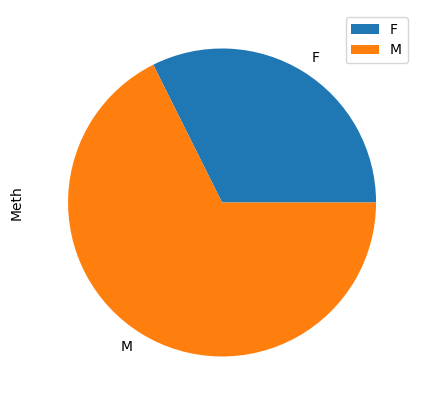

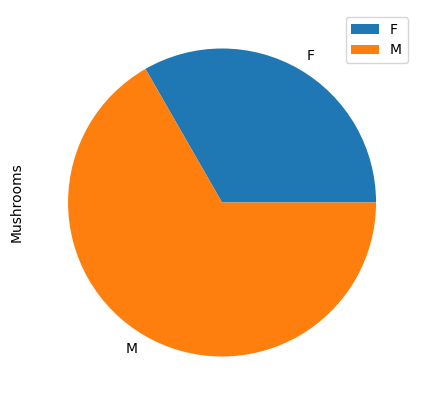

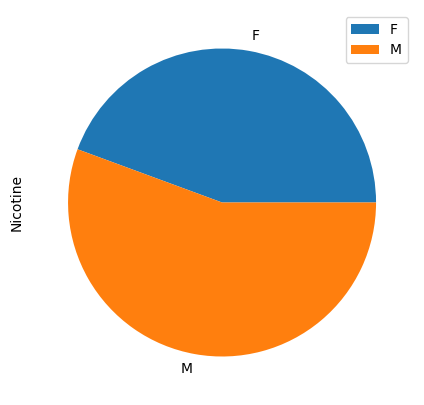

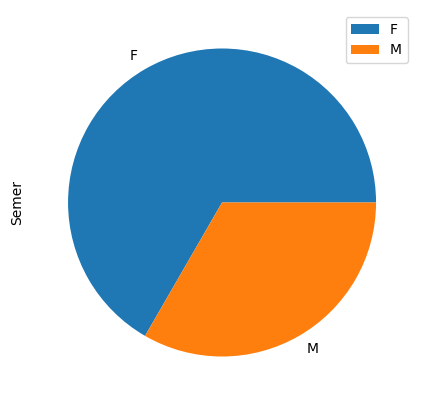

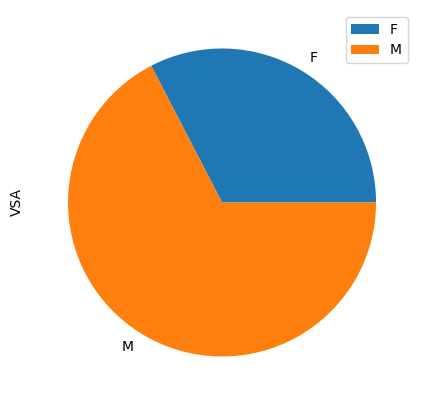

In [63]:
for i in range(len(drogues)):
    plot = df_users.plot.pie(y=drogues[i], figsize=(5, 5))

In [64]:
df_users2=df_users1.copy()
df_users2.loc[(df_users2['Education'] ==  -2.43591), 'Education'] = "Left school before 16 years"  
df_users2.loc[(df_users2['Education'] ==  -1.73790), 'Education'] = "Left school at 16 years"
df_users2.loc[(df_users2['Education'] ==  -1.43719), 'Education'] = "Left school at 17 years"
df_users2.loc[(df_users2['Education'] ==  -1.22751 ), 'Education'] ="Left school at 18 years"
df_users2.loc[(df_users2['Education'] ==  -0.61113), 'Education'] = "Some college or university, no certificate or degree"
df_users2.loc[(df_users2['Education'] ==  -0.05921 ), 'Education'] = "Professional certificate/diploma"
df_users2.loc[(df_users2['Education'] ==  0.45468), 'Education'] = "University degree"
df_users2.loc[(df_users2['Education'] ==  1.16365), 'Education'] = "Masters degree"
df_users2.loc[(df_users2['Education'] ==  1.98437), 'Education'] = "Doctorate degree"
df_users2 = df_users2.groupby(['Education']).sum()


df_users2.head()

,ID,Age,Gender,Country,Ethnicity,Nscore,Escore,Oscore,Ascore,Cscore,...,Heroin,Ketamin,Legalh,LSD,Meth,Mushrooms,Nicotine,Semer,VSA,User
Education,,,,,,,,,,,,,,,,,,,,,
Doctorate degree,81038,41.65216,12.06150,55.27898,-26.64321,-26.95169,18.43331,22.18232,17.22102,43.38512,...,6,11,20,18,15,22,44,0,1,575
Left school at 16 years,70545,51.53431,-6.27198,66.60347,-29.96761,2.85947,-16.00056,-62.42720,-3.21061,-6.42701,...,10,15,24,15,18,18,63,1,5,678
Left school at 17 years,29191,-0.88538,-0.96492,7.14685,-8.54781,16.90176,-12.33847,-8.23359,-11.99263,-12.50508,...,6,2,13,9,8,12,23,0,9,266
Left school at 18 years,94685,-35.69167,-12.54396,14.61581,-30.02175,5.79051,-13.42872,-7.78527,-15.93604,-30.35556,...,17,33,59,43,39,50,81,0,27,941
Left school before 16 years,22762,14.32088,-1.92984,13.42179,-8.87180,-2.00415,-4.76242,-9.74255,3.95926,-1.64359,...,7,3,10,9,10,10,22,0,4,244


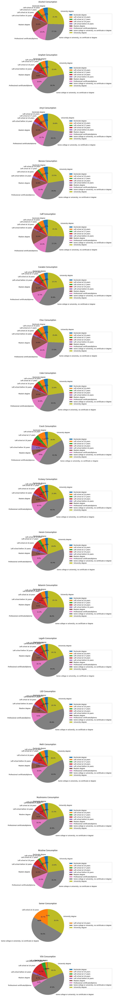

In [65]:
num_drogues = len(drogues)
num_subplot_rows = num_drogues  # Un graphique par ligne
num_subplot_cols = 1  # Une seule colonne

fig, axes = plt.subplots(nrows=num_subplot_rows, ncols=num_subplot_cols, figsize=(8, 5 * num_subplot_rows))

for i, drogue in enumerate(drogues):
    ax = axes[i]
    df_users2[drogue].plot.pie(ax=ax, autopct='%1.1f%%', startangle=90)
    ax.set_title(f'{drogue} Consumption')
    ax.set_ylabel('')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))  # Placer la légende à droite du graphique

plt.tight_layout()
plt.show()

In [66]:
df_users3=df_users1.copy()
df_users3.loc[(df_users3['Ethnicity'] == -0.50212), 'Ethnicity'] = "Asian"
df_users3.loc[(df_users3['Ethnicity'] == -1.10702), 'Ethnicity'] = "Black"
df_users3.loc[(df_users3['Ethnicity'] == 1.90725), 'Ethnicity'] = "Mixed Black/Asian"
df_users3.loc[(df_users3['Ethnicity'] ==  0.12600), 'Ethnicity'] = "Mixed White/Asian"
df_users3.loc[(df_users3['Ethnicity'] ==  -0.22166), 'Ethnicity'] =  "Mixed White/Black"
df_users3.loc[(df_users3['Ethnicity'] ==  0.11440), 'Ethnicity'] = "Other"
df_users3.loc[(df_users3['Ethnicity'] == -0.31685), 'Ethnicity'] = "White"
df_users3 = df_users3.groupby(['Ethnicity']).sum()
df_users3.head()



,ID,Age,Gender,Education,Country,Nscore,Escore,Oscore,Ascore,Cscore,...,Heroin,Ketamin,Legalh,LSD,Meth,Mushrooms,Nicotine,Semer,VSA,User
Ethnicity,,,,,,,,,,,,,,,,,,,,,
Asian,22448,-2.60551,1.92984,16.48466,16.83810,1.17418,5.32550,-4.83745,-0.99317,1.42310,...,1,2,4,3,0,4,11,1,3,123
Black,27104,5.54899,0.48246,7.77906,19.74468,-9.65485,1.55118,-15.57884,4.24422,9.42464,...,1,2,7,1,1,3,12,0,0,140
Mixed Black/Asian,3354,-1.98248,0.48246,-0.76758,-1.42537,2.01263,1.06308,1.16098,-3.15034,-2.71528,...,0,0,1,2,1,2,2,0,1,24
Mixed White/Asian,18231,-6.37557,0.96492,1.45279,2.48412,7.87227,4.32910,3.30685,-1.12394,-0.14674,...,6,4,10,10,7,11,15,0,5,194
Mixed White/Black,20263,-5.78155,0.96492,2.49865,6.40064,0.80458,4.00818,-1.10283,2.38580,2.12598,...,3,4,8,6,5,8,15,0,3,167


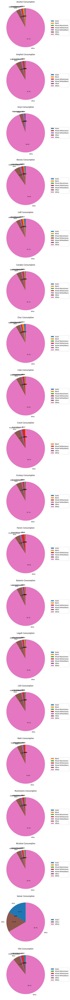

In [67]:
num_drogues = len(drogues)
num_subplot_rows = num_drogues  # Un graphique par ligne
num_subplot_cols = 1  # Une seule colonne

fig, axes = plt.subplots(nrows=num_subplot_rows, ncols=num_subplot_cols, figsize=(8, 5 * num_subplot_rows))

for i, drogue in enumerate(drogues):
    ax = axes[i]
    df_users3[drogue].plot.pie(ax=ax, autopct='%1.1f%%', startangle=90, fontsize='small')
    ax.set_title(f'{drogue} Consumption')
    ax.set_ylabel('')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))  

plt.tight_layout()
plt.show()

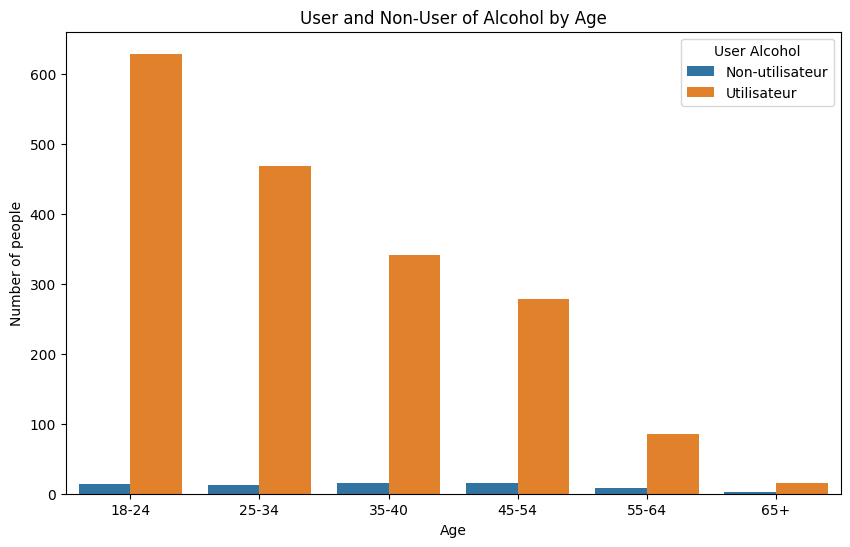

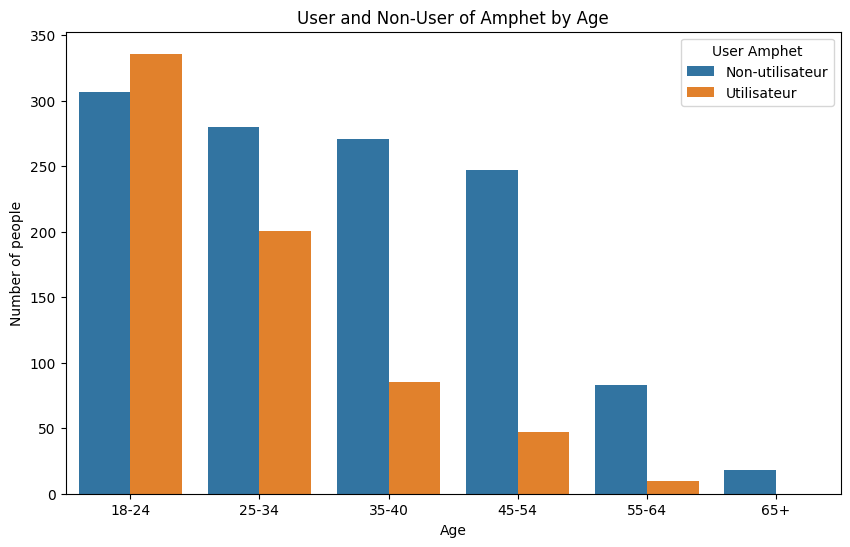

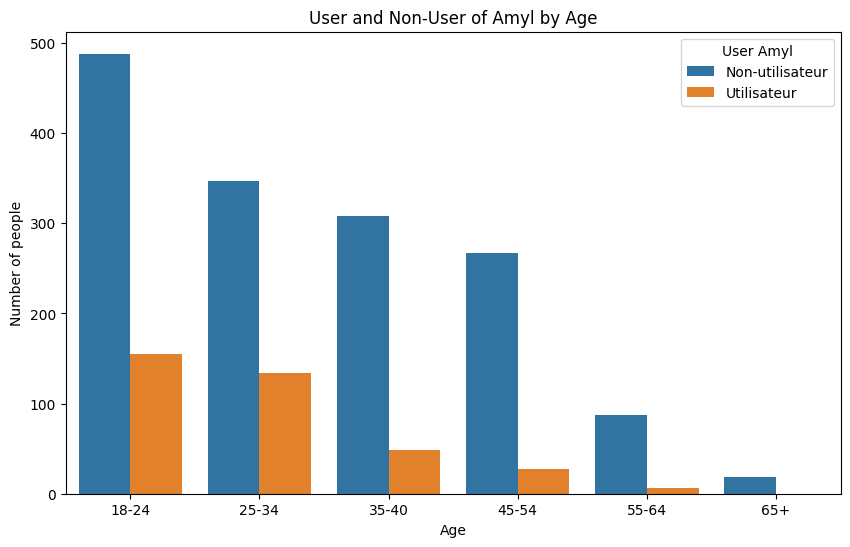

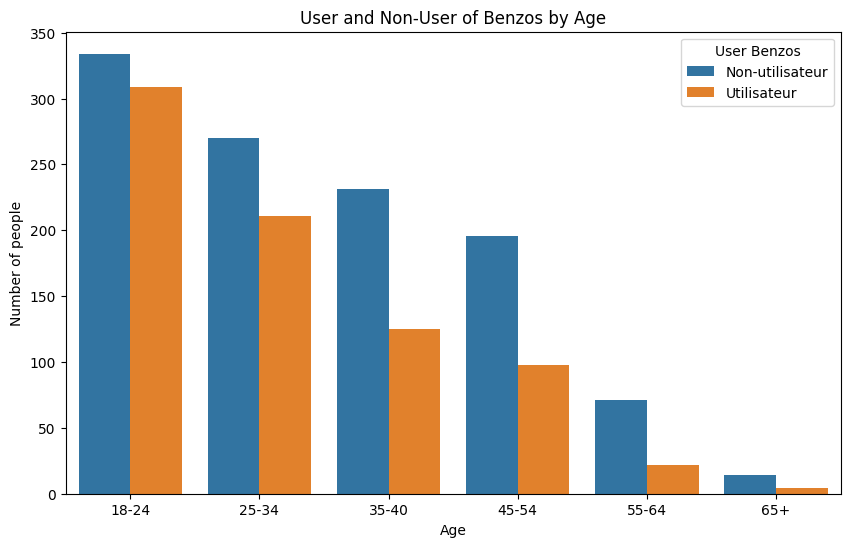

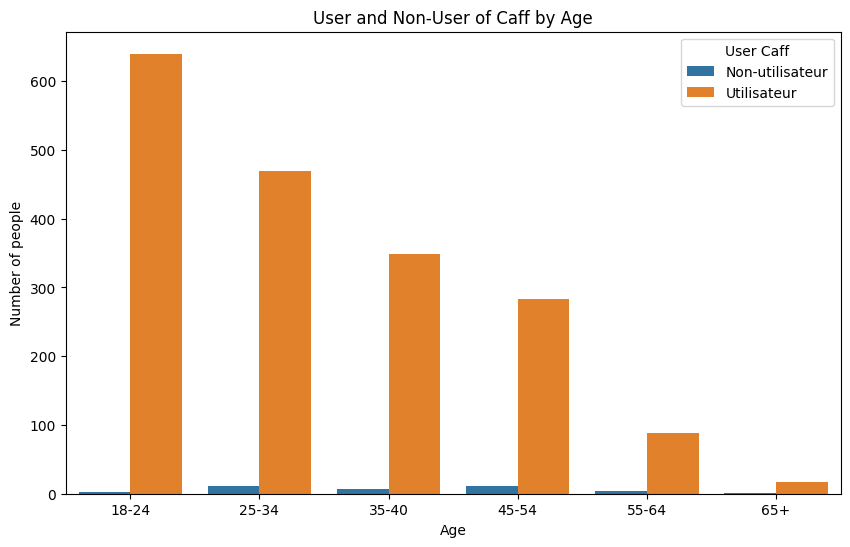

...

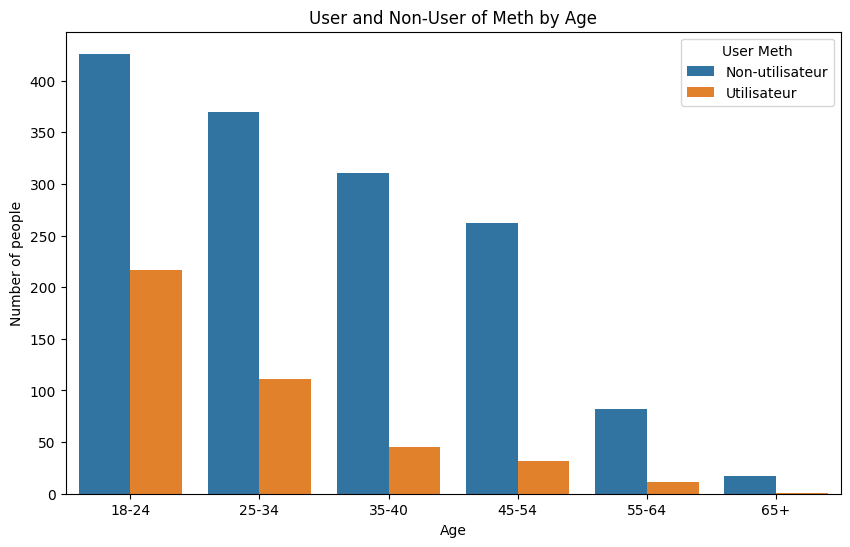

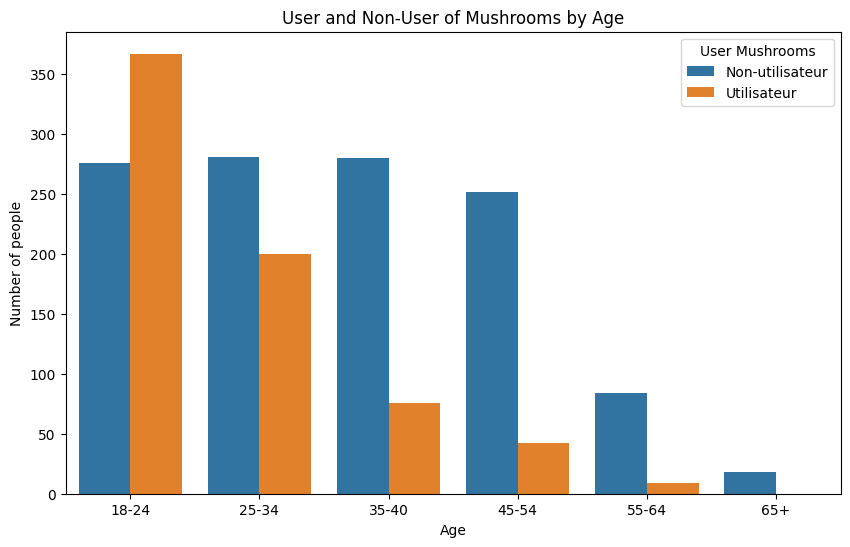

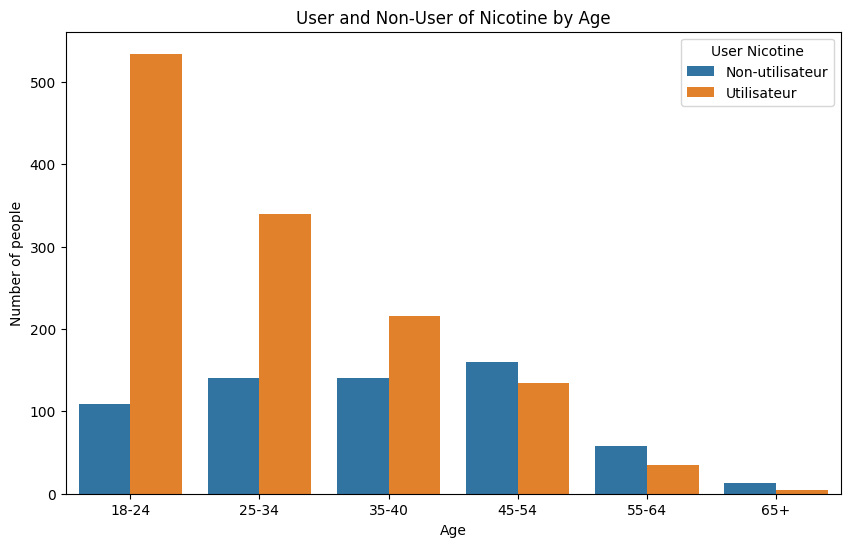

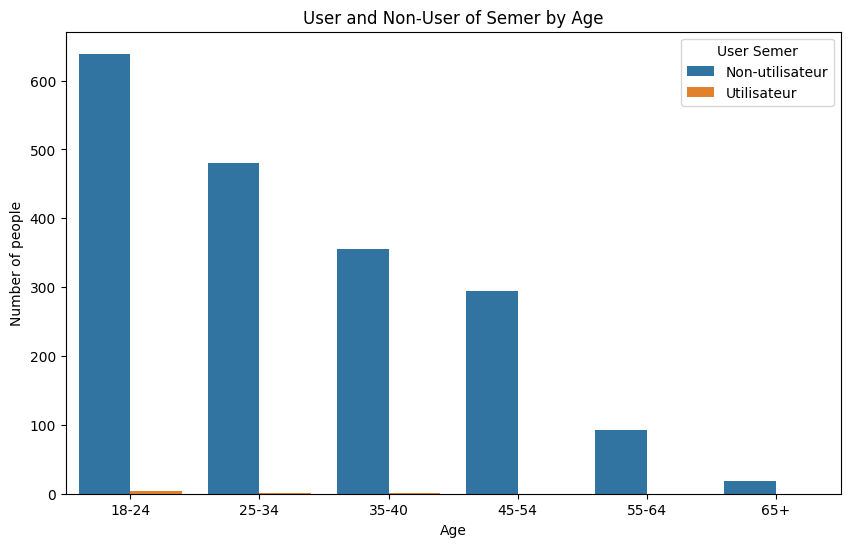

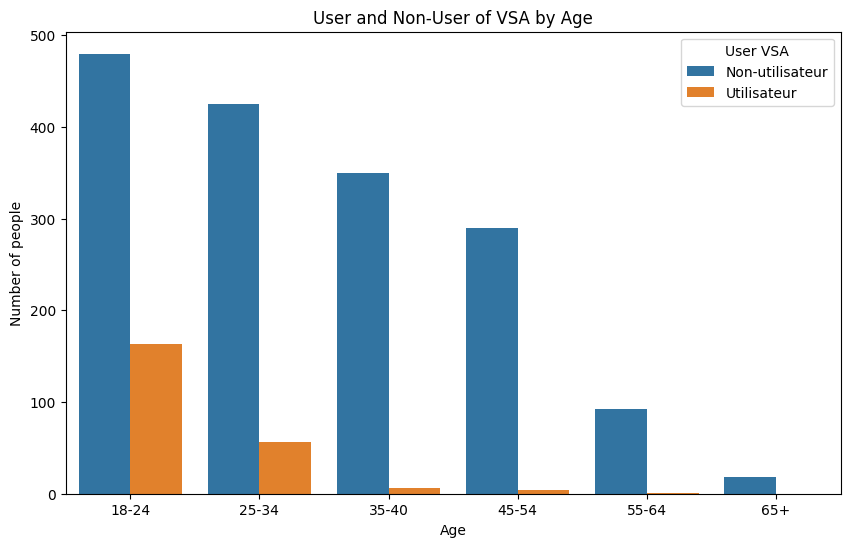

In [68]:
substances = [
    'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke',
    'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth',
    'Mushrooms', 'Nicotine', 'Semer', 'VSA'
]


age_order = ['18-24','25-34',"35-40","45-54","55-64","65+"] 

for substance in substances:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_uu, x='Age', hue=substance,order=age_order)
    plt.xlabel('Age')
    plt.ylabel('Number of people')
    plt.title(f'User and Non-User of {substance} by Age')
    plt.legend(title=f'User {substance}', labels=['Non-utilisateur', 'Utilisateur'])
    plt.xticks(rotation=0)
    plt.show()


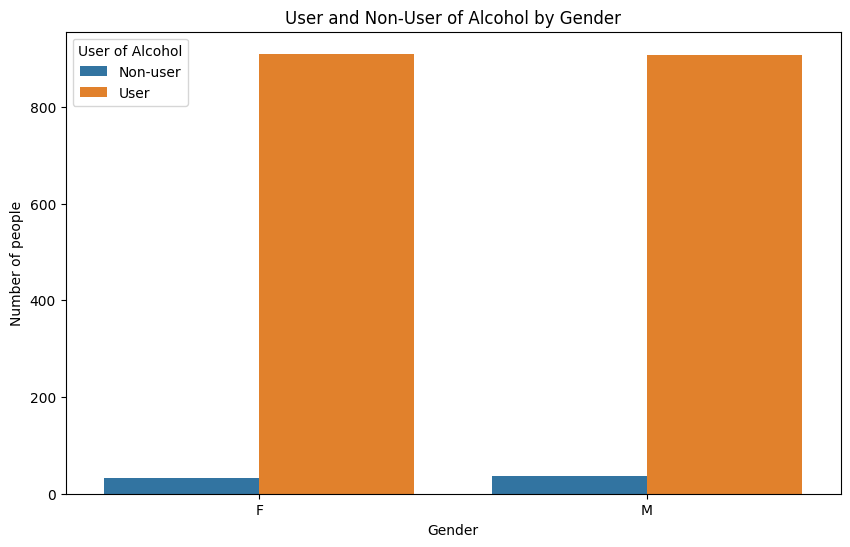

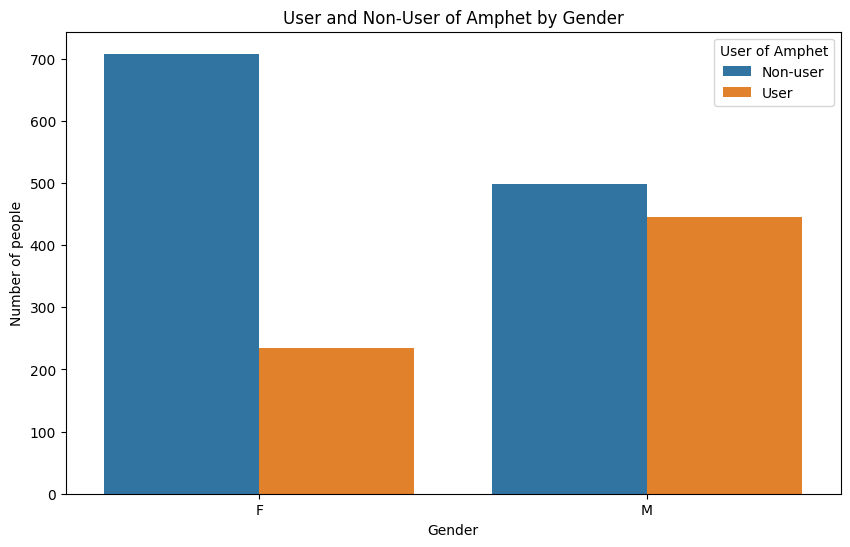

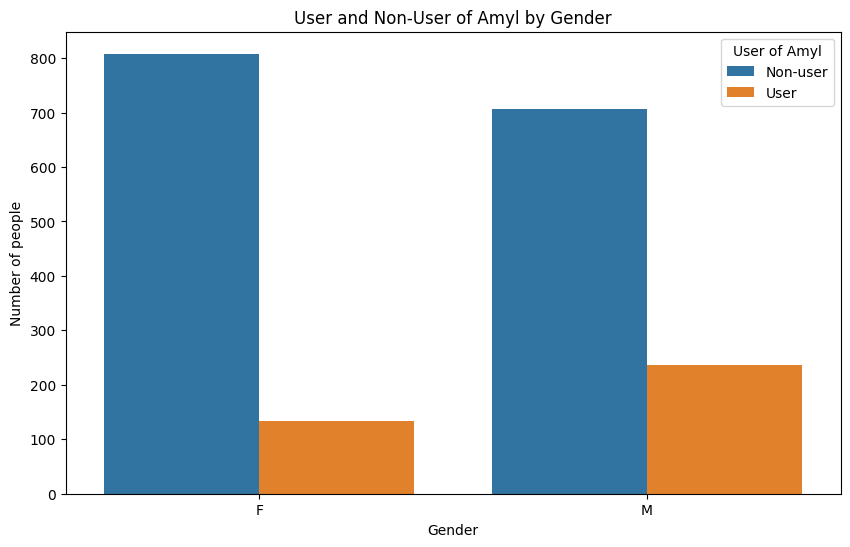

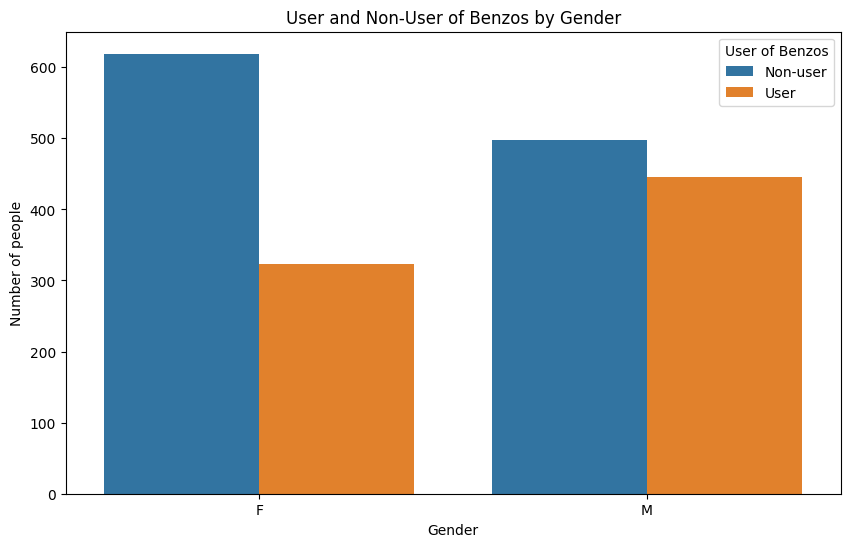

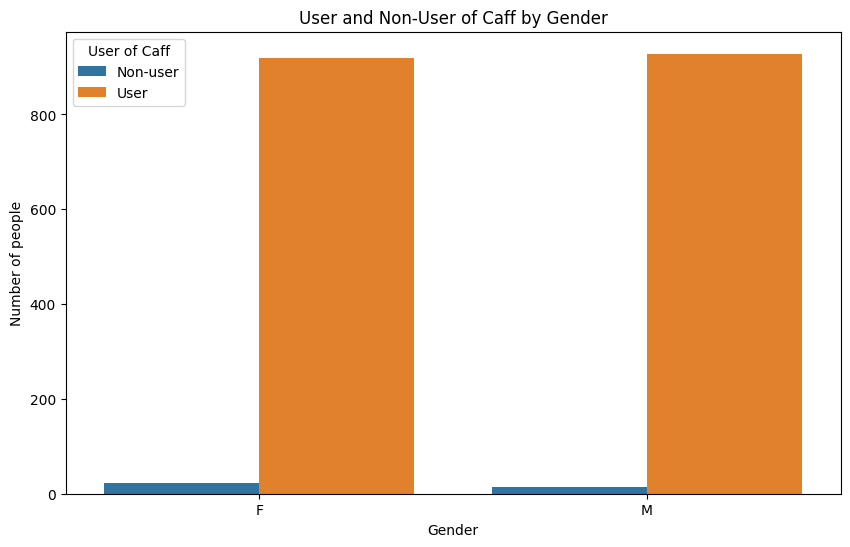

...

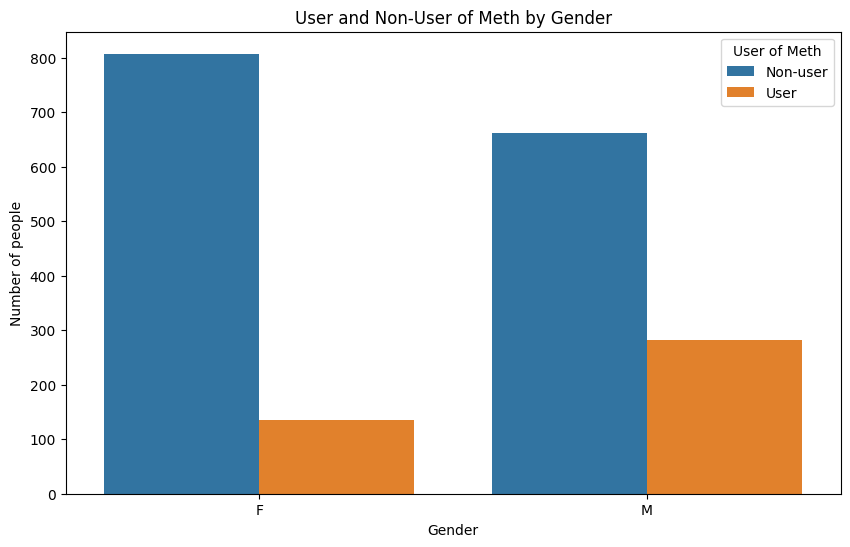

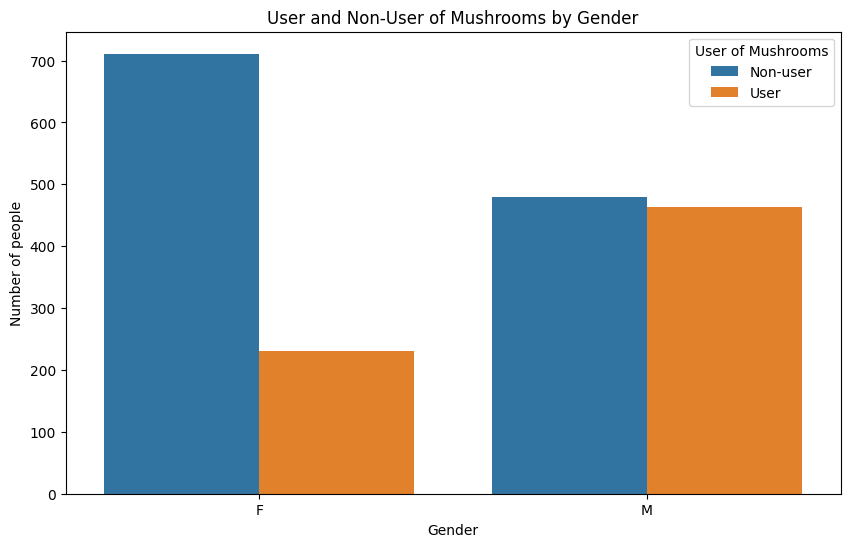

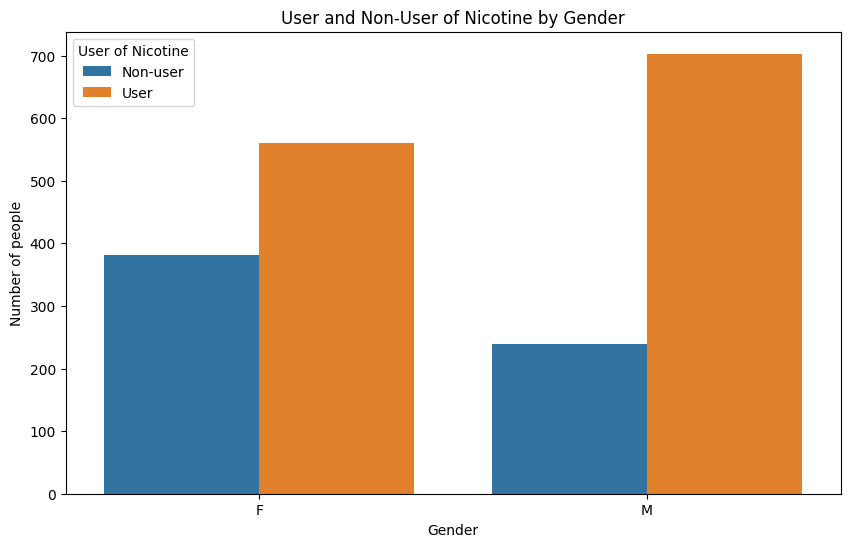

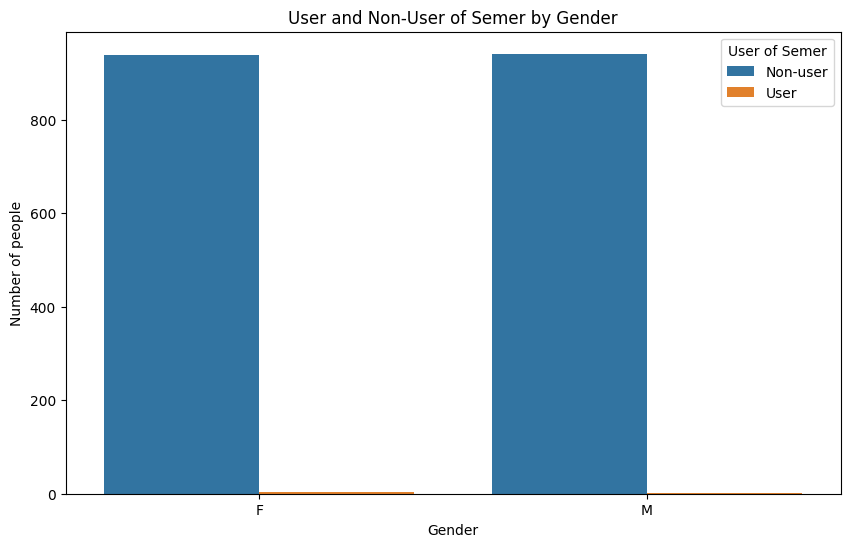

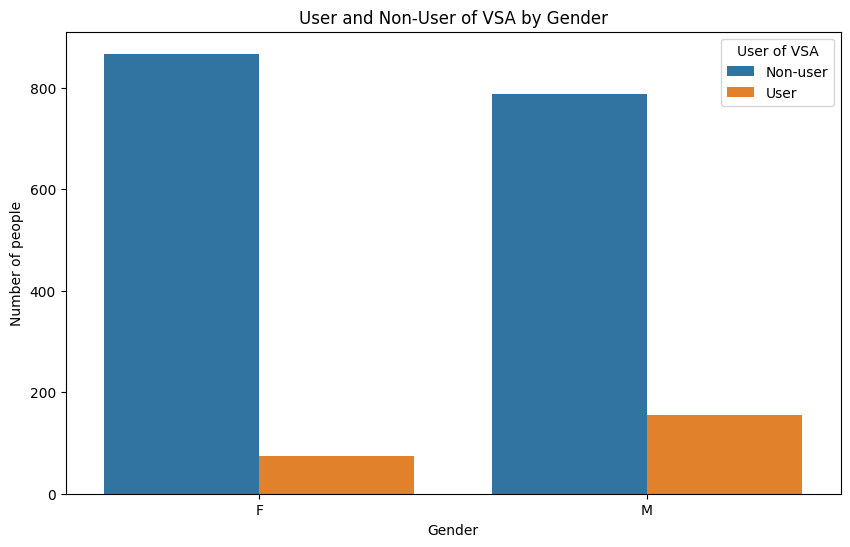

In [69]:
substances = [
    'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke',
    'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth',
    'Mushrooms', 'Nicotine', 'Semer', 'VSA'
]


gender_order = ['F','M'] 

for substance in substances:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_uu, x='Gender', hue=substance,order=gender_order)
    plt.xlabel('Gender')
    plt.ylabel('Number of people')
    plt.title(f'User and Non-User of {substance} by Gender')
    plt.legend(title=f'User of {substance}', labels=['Non-user', 'User'])
    plt.xticks(rotation=0)
    plt.show()


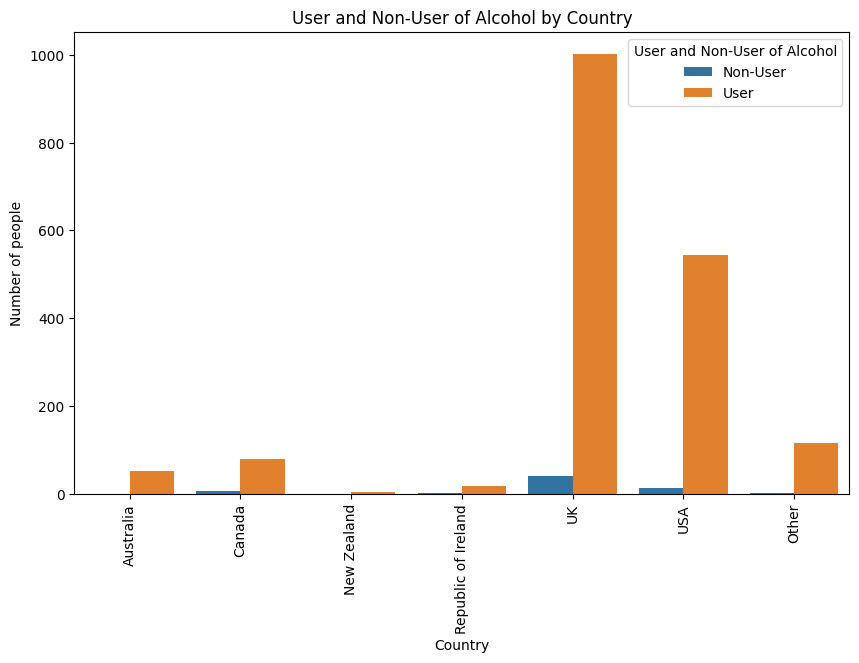

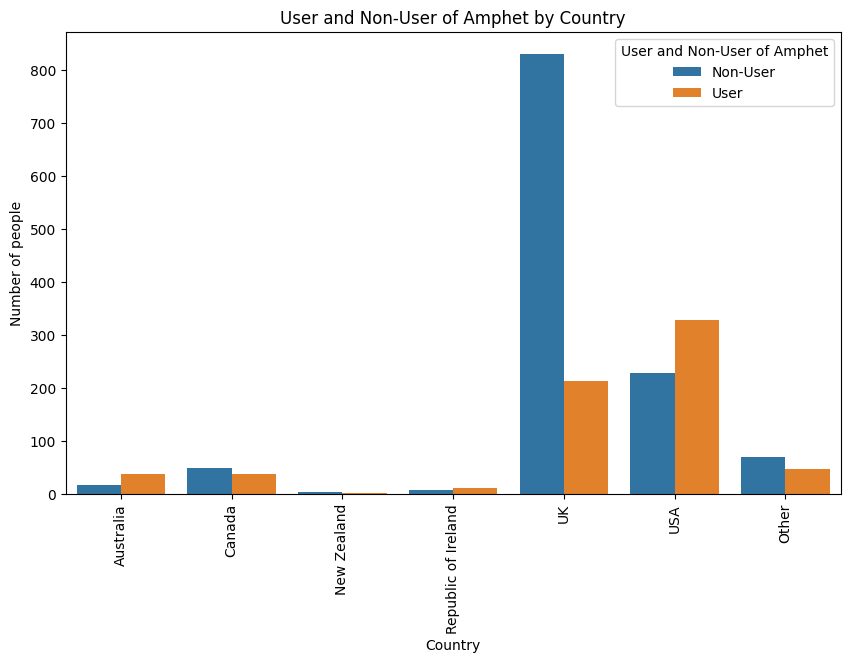

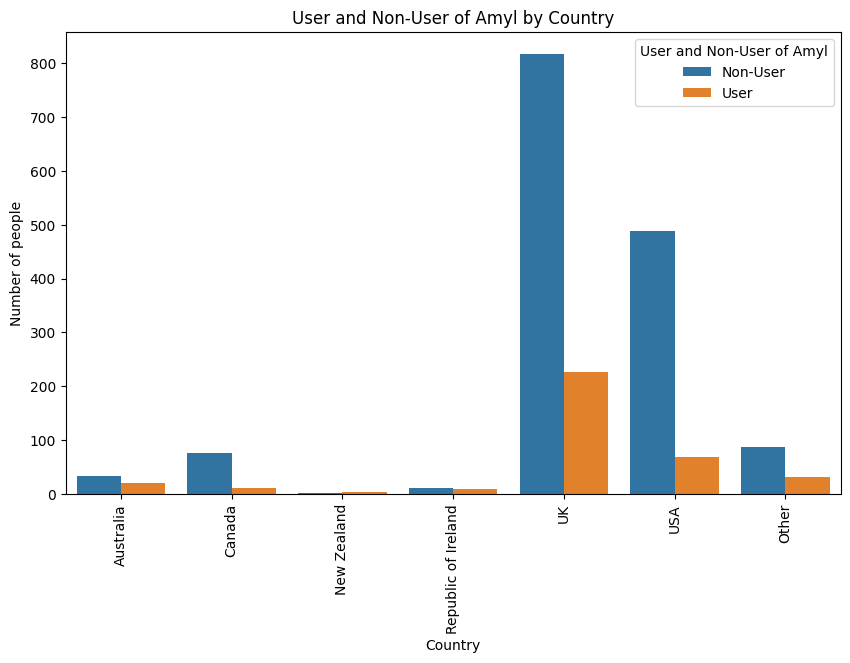

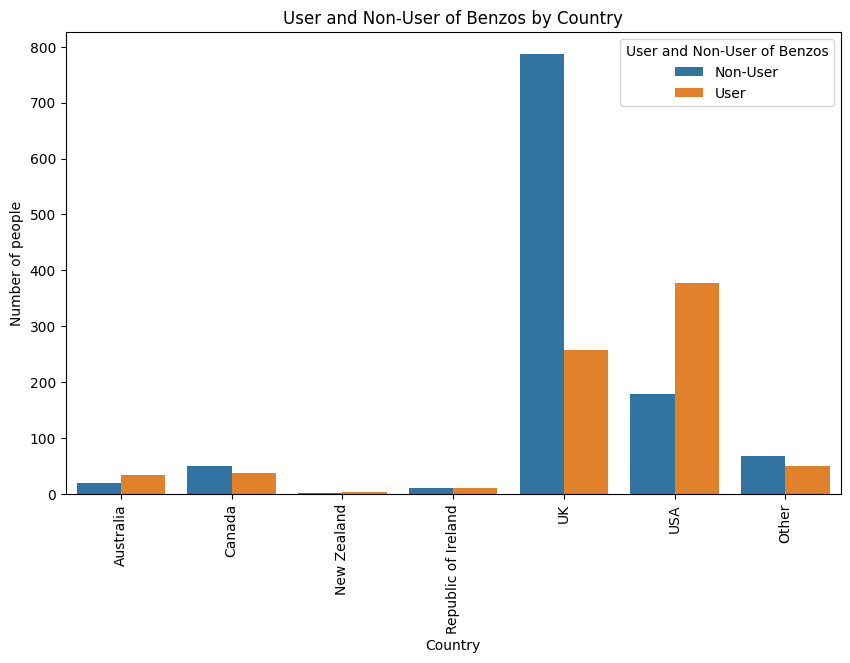

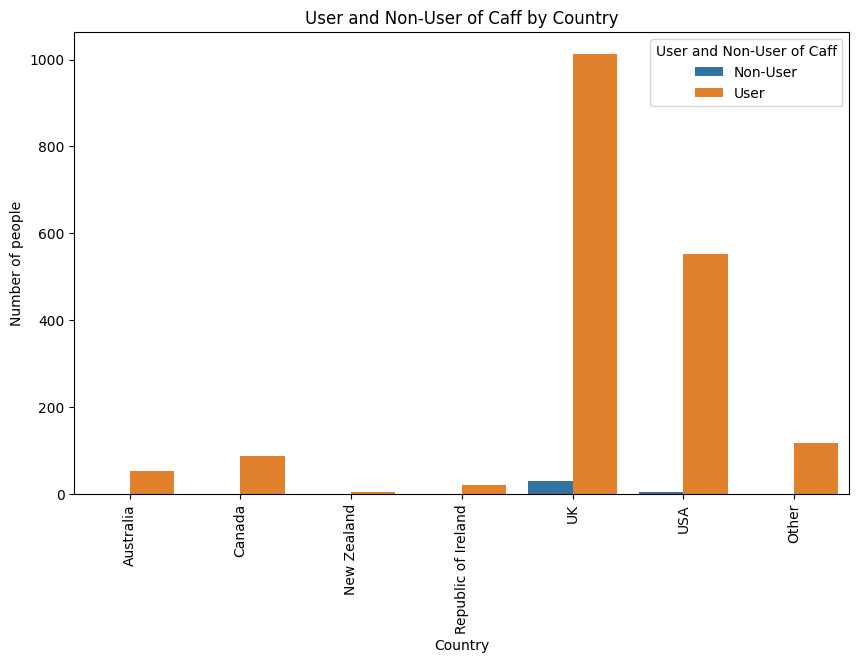

...

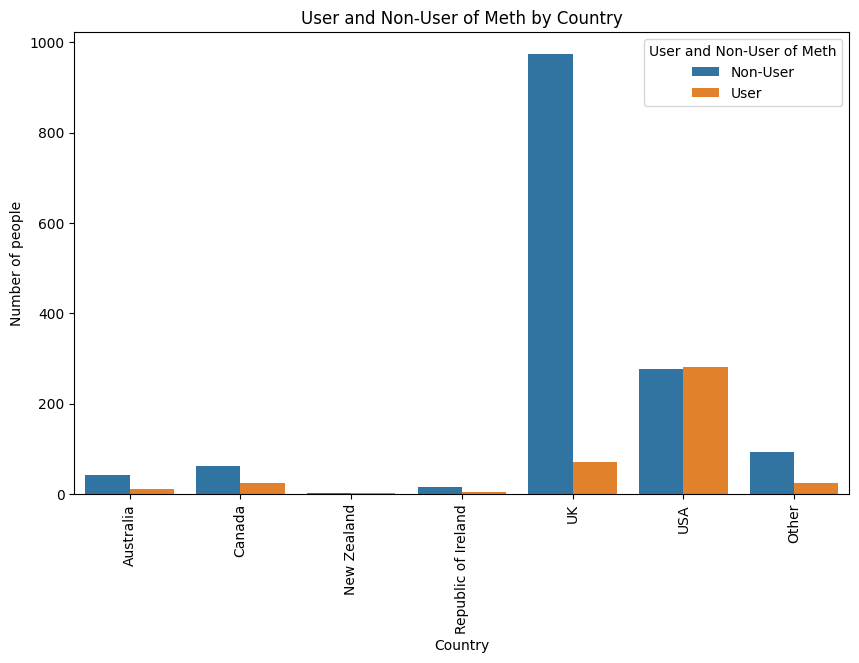

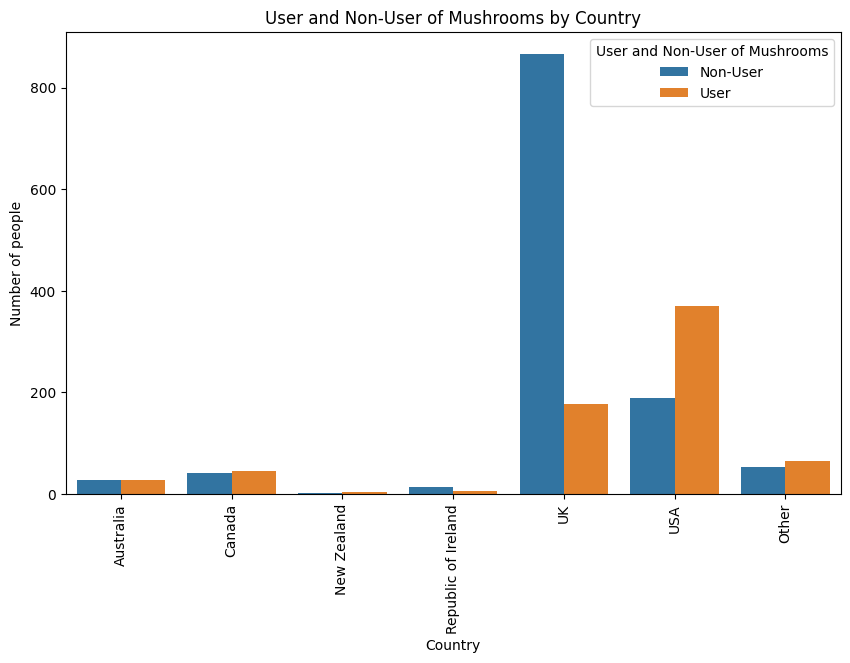

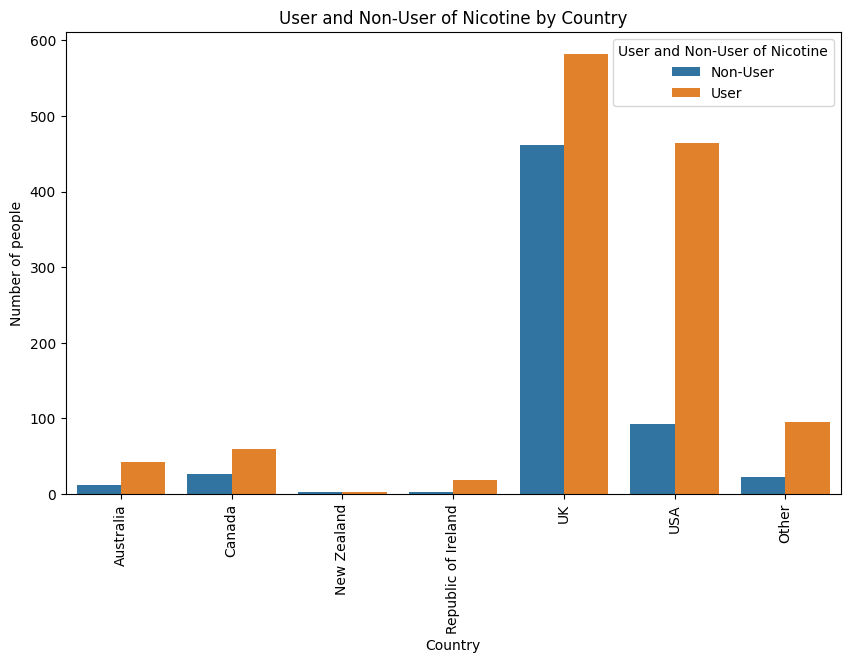

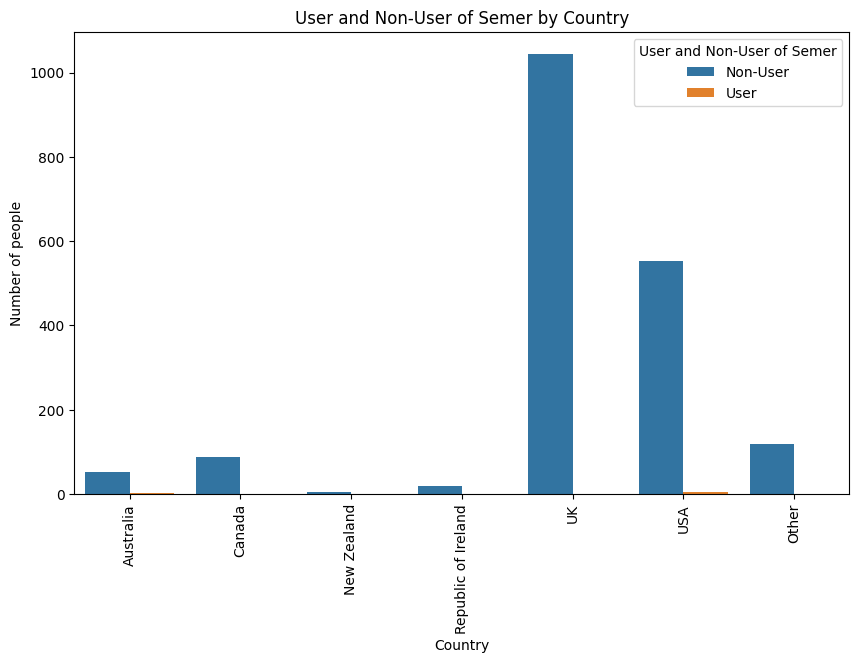

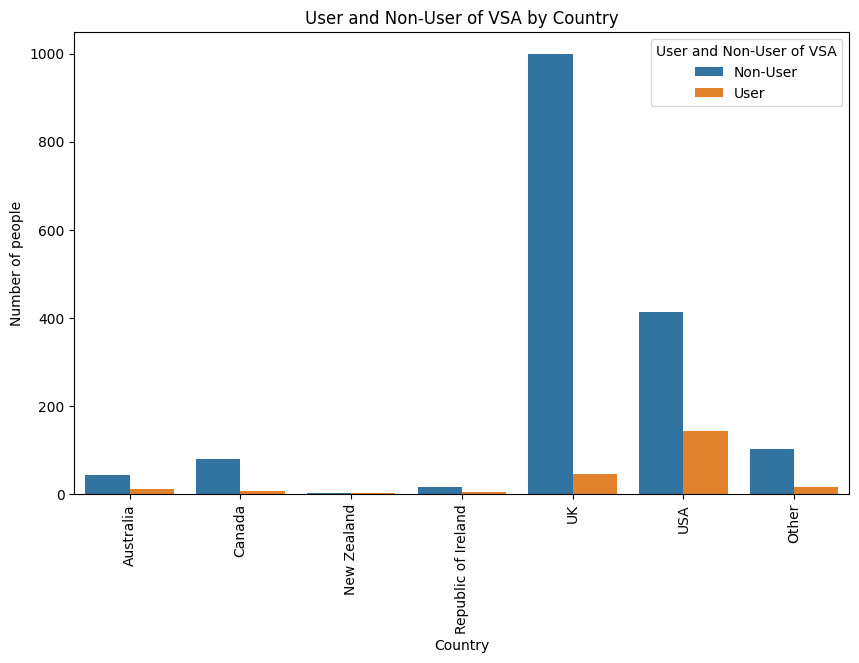

In [70]:
substances = [
    'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke',
    'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth',
    'Mushrooms', 'Nicotine', 'Semer', 'VSA'
]


country_order = ["Australia","Canada","New Zealand","Republic of Ireland","UK","USA","Other"] 


for substance in substances:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_uu, x='Country', hue=substance,order=country_order)
    plt.xlabel('Country')
    plt.ylabel('Number of people')
    plt.title(f'User and Non-User of {substance} by Country')
    plt.legend(title=f'User and Non-User of {substance}', labels=['Non-User', 'User'])
    plt.xticks(rotation=90)
    plt.show()

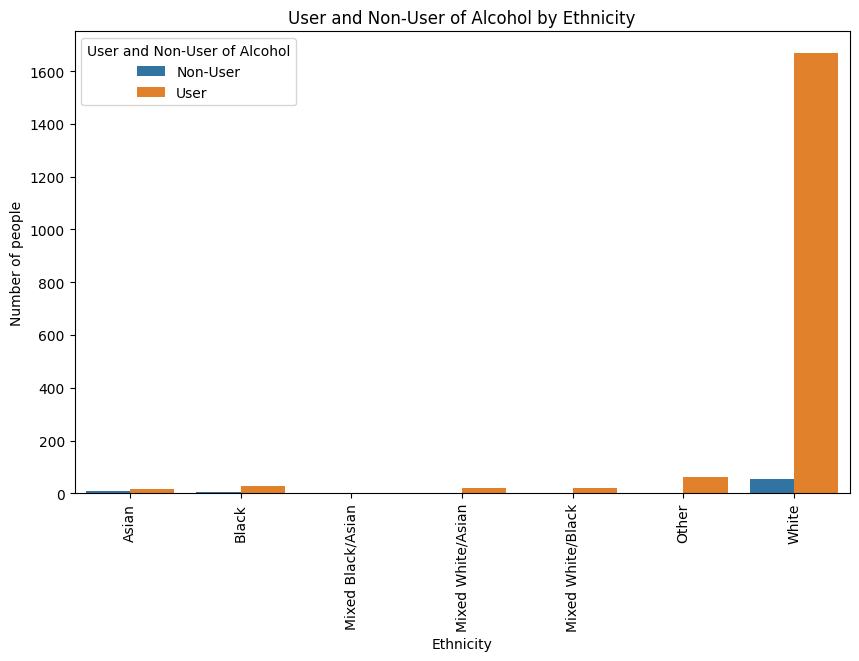

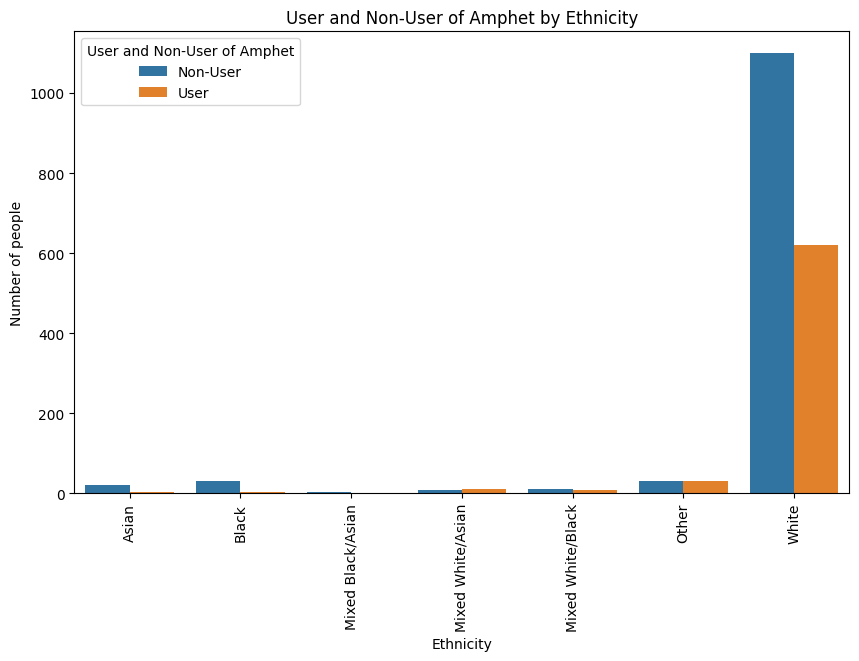

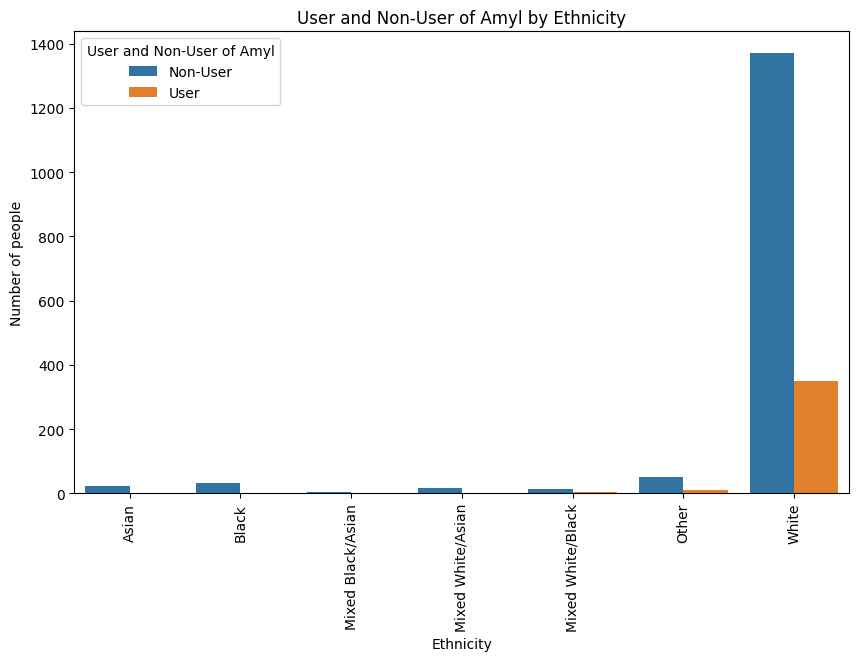

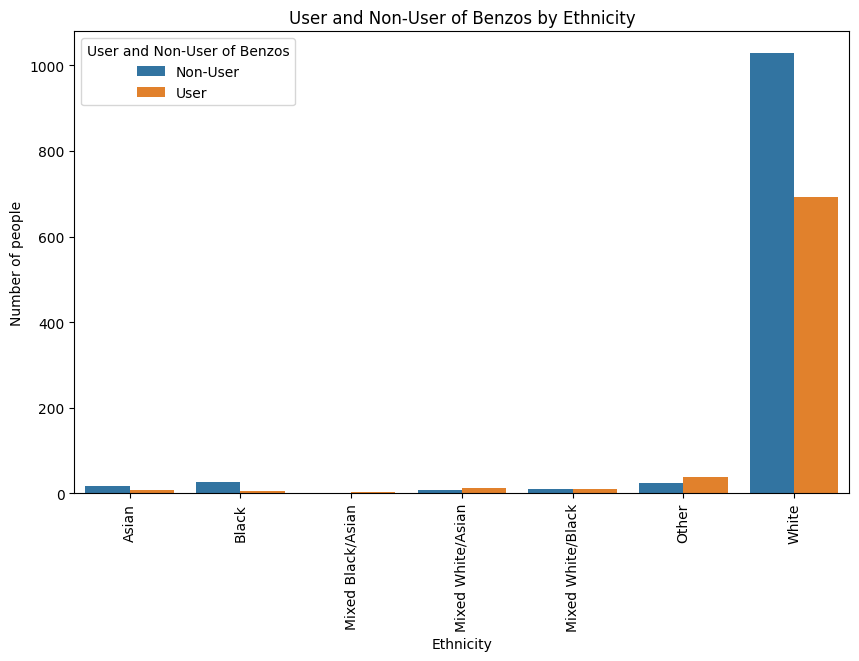

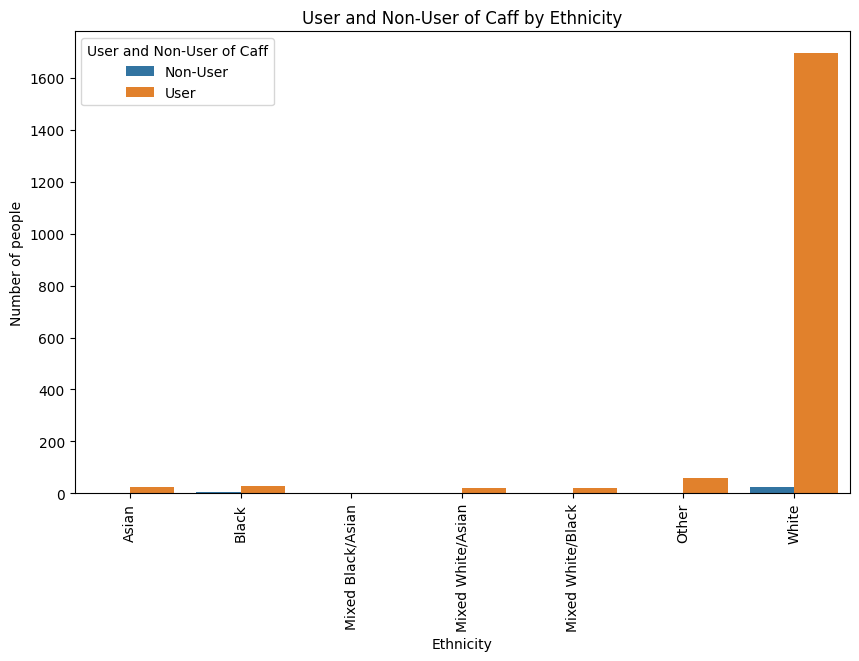

...

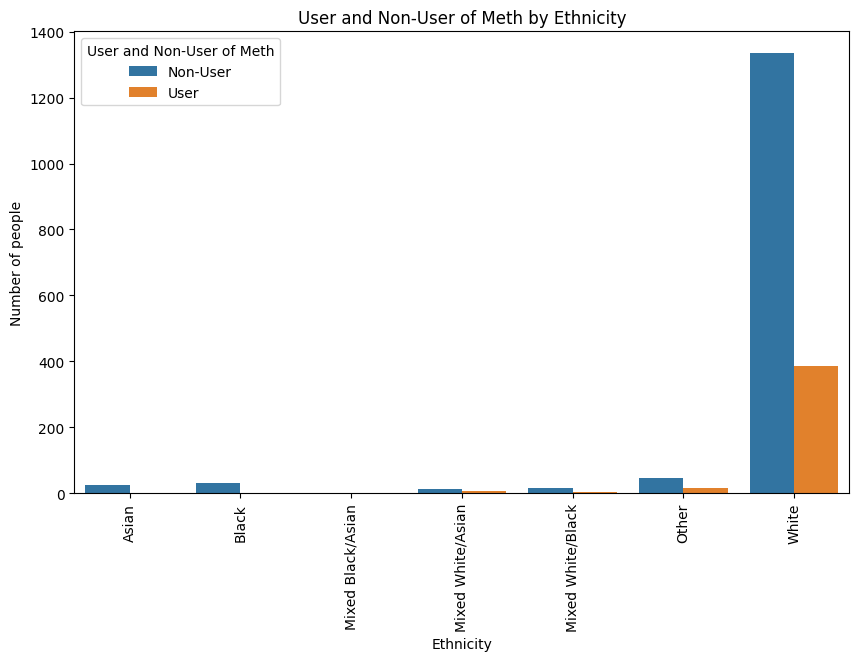

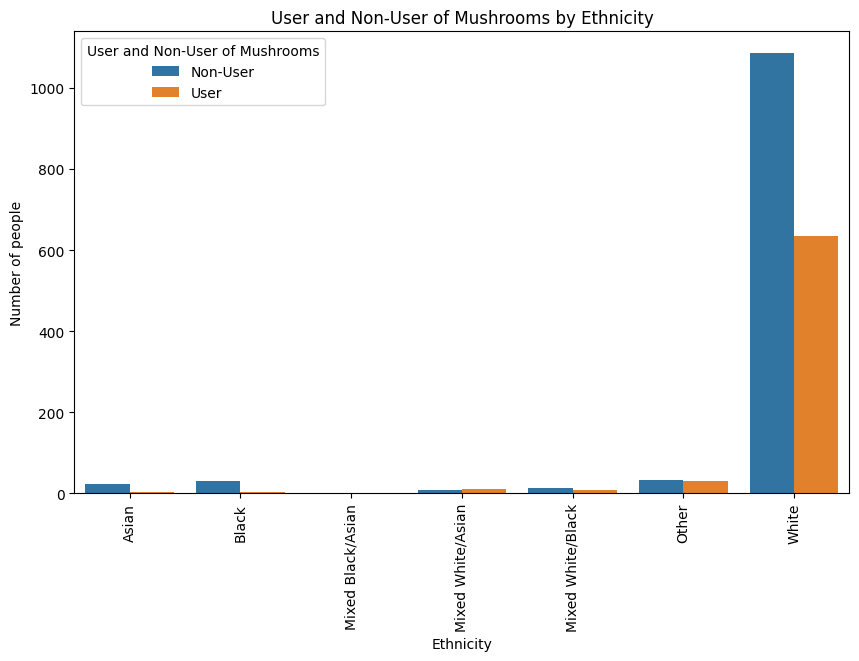

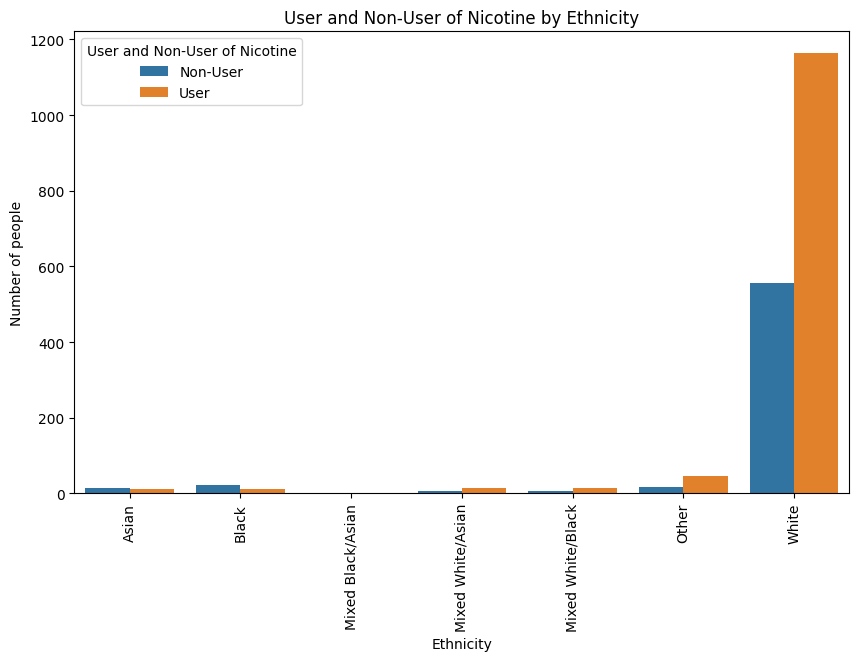

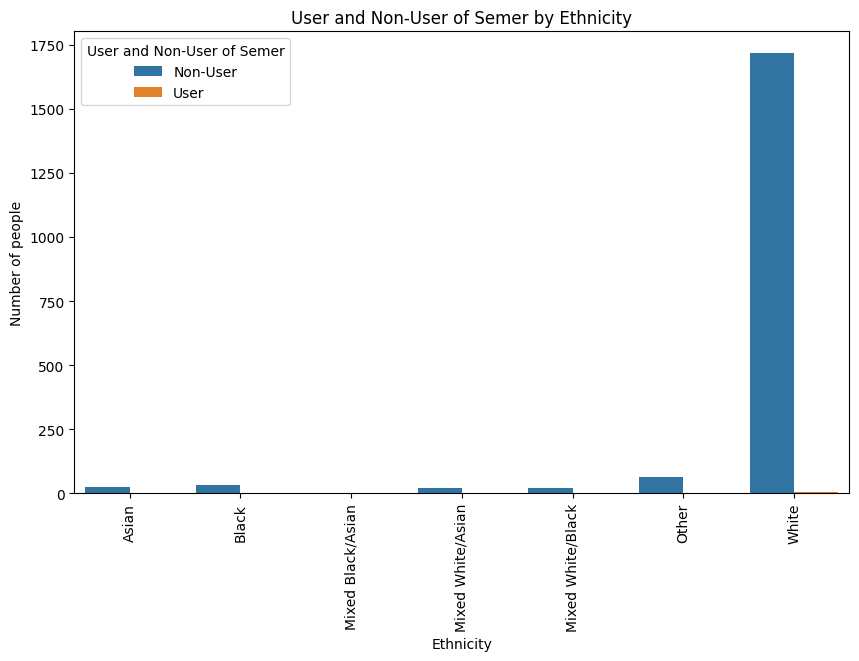

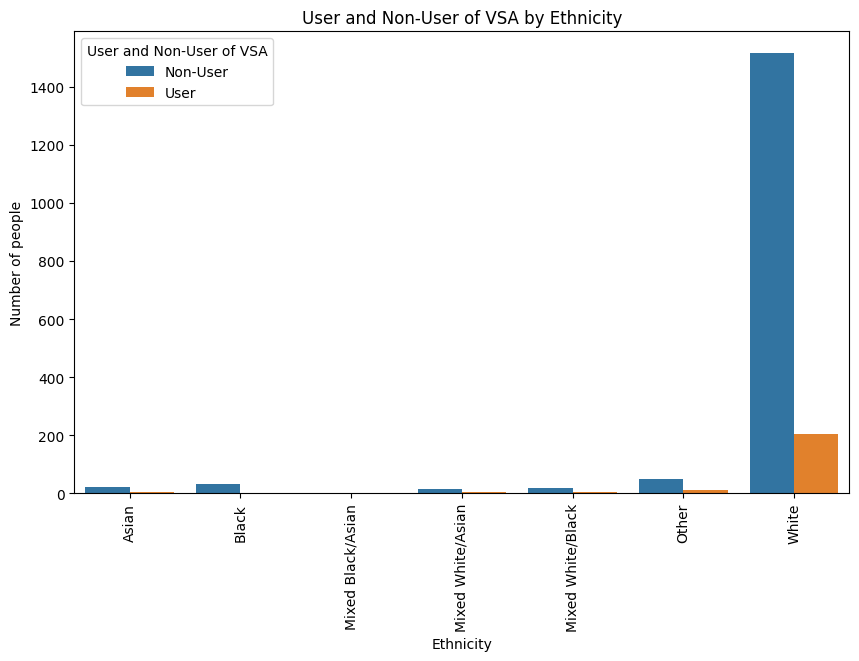

In [71]:
substances = [
    'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke',
    'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth',
    'Mushrooms', 'Nicotine', 'Semer', 'VSA'
]


ethnicity_order = ["Asian","Black","Mixed Black/Asian","Mixed White/Asian","Mixed White/Black","Other","White"] 


for substance in substances:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_uu, x='Ethnicity', hue=substance,order=ethnicity_order)
    plt.xlabel('Ethnicity')
    plt.ylabel('Number of people')
    plt.title(f'User and Non-User of {substance} by Ethnicity')
    plt.legend(title=f'User and Non-User of {substance}', labels=['Non-User', 'User'])
    plt.xticks(rotation=90)
    plt.show()

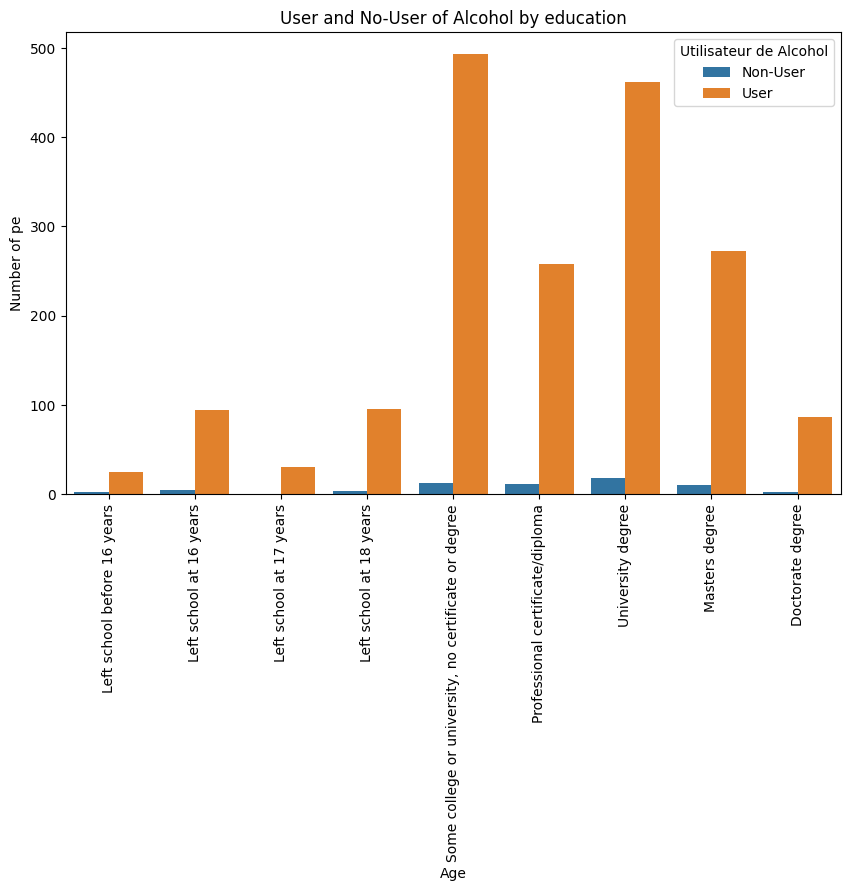

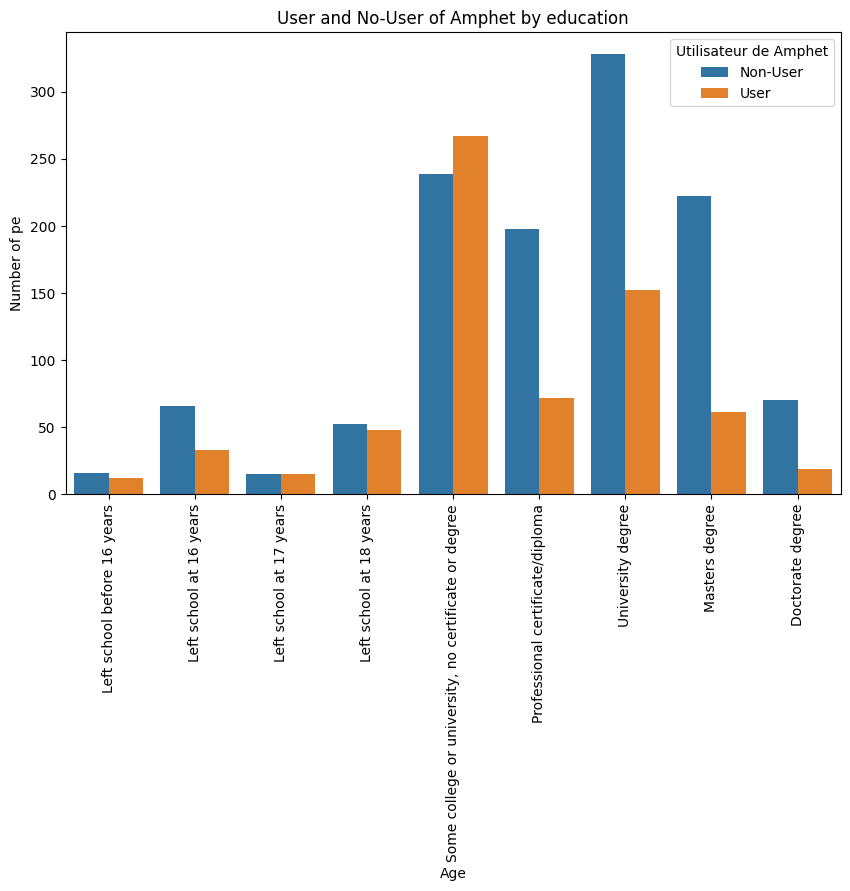

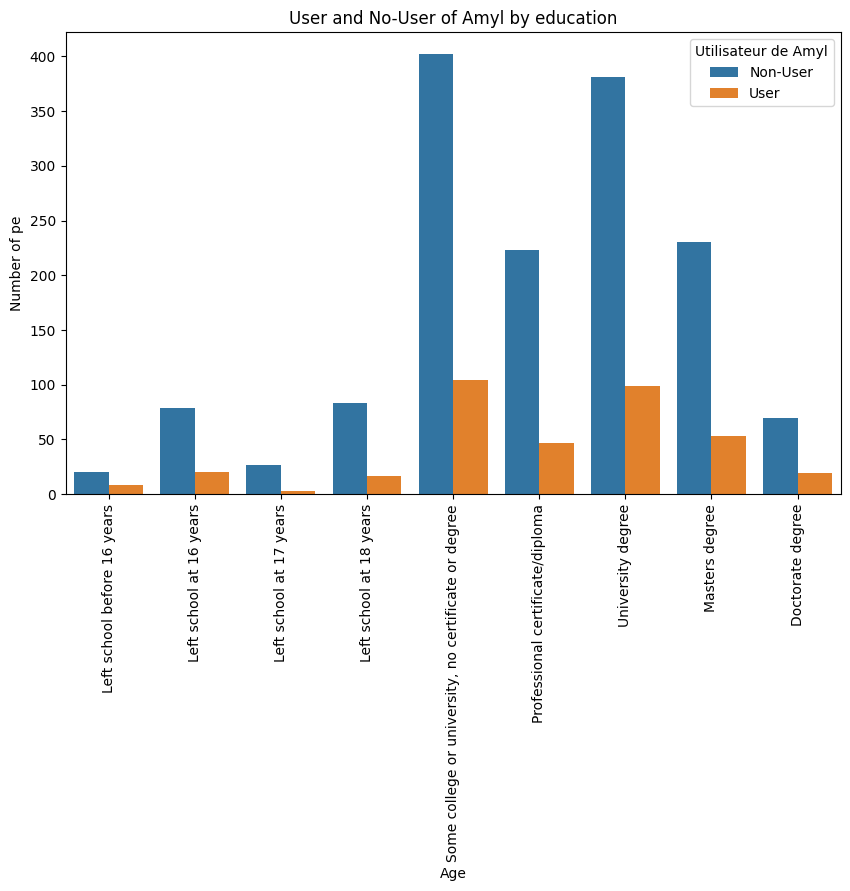

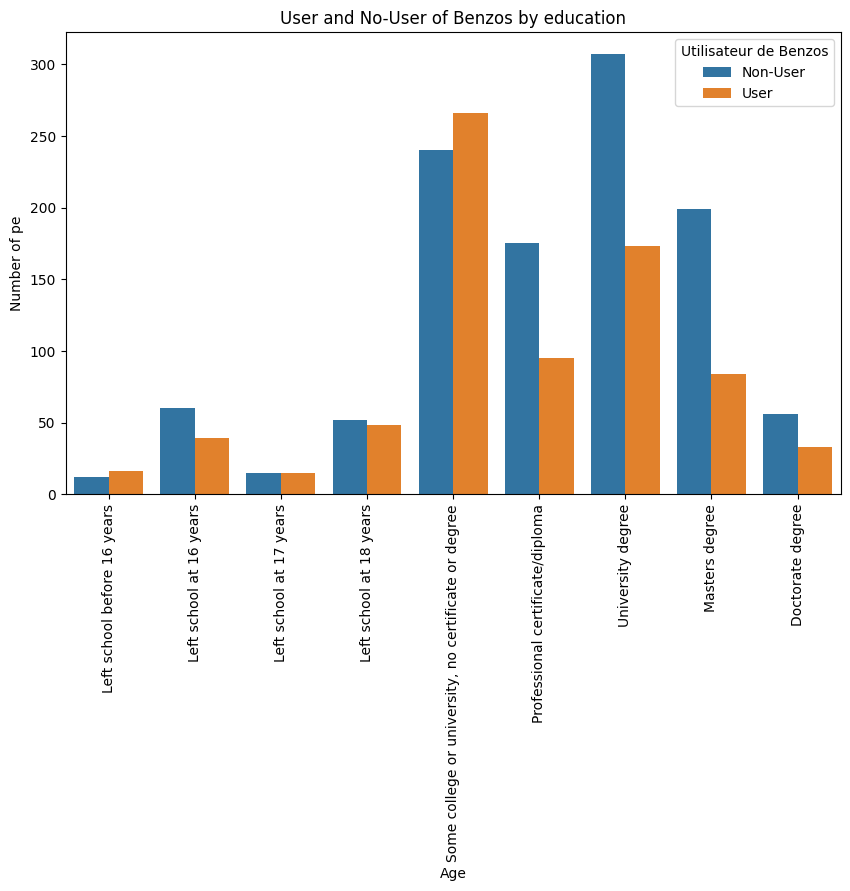

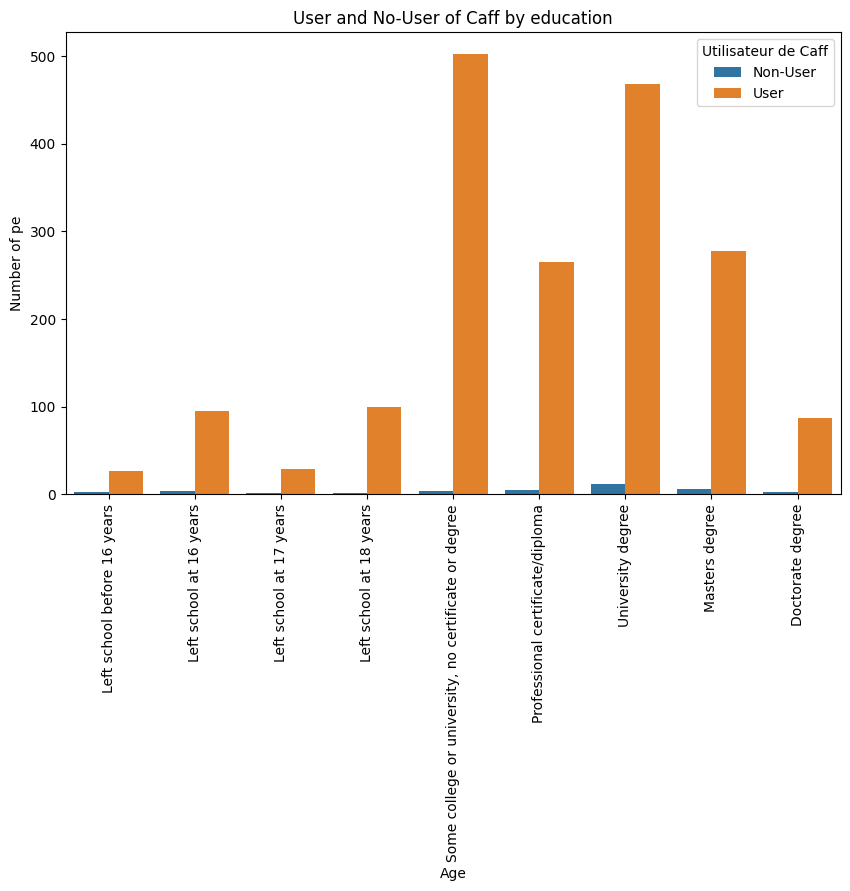

...

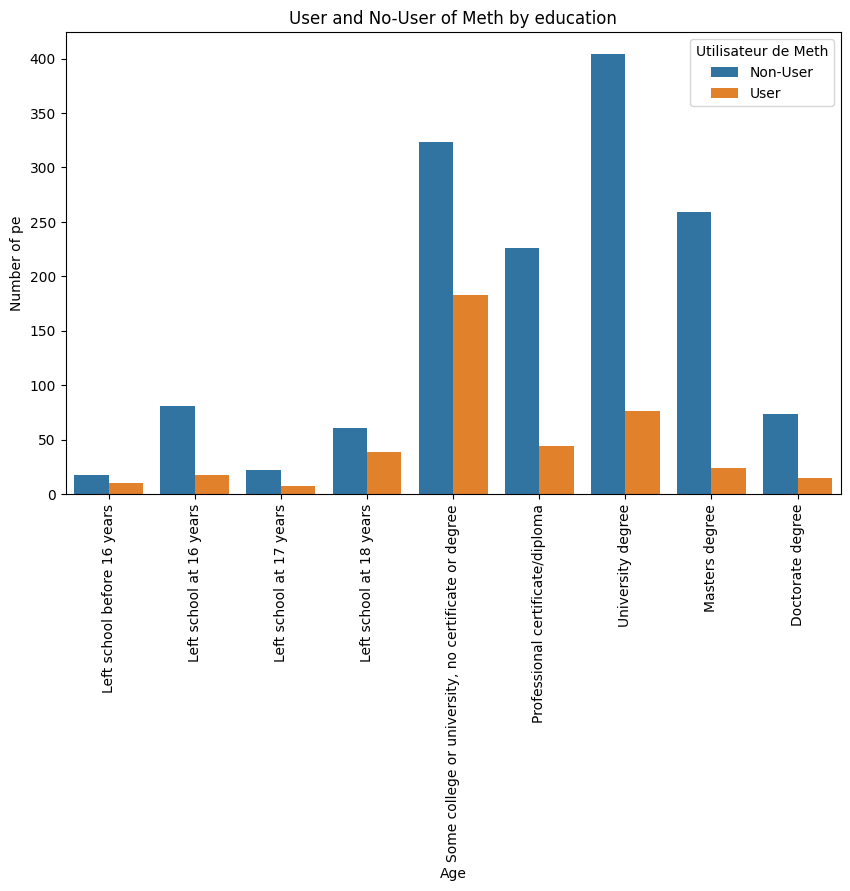

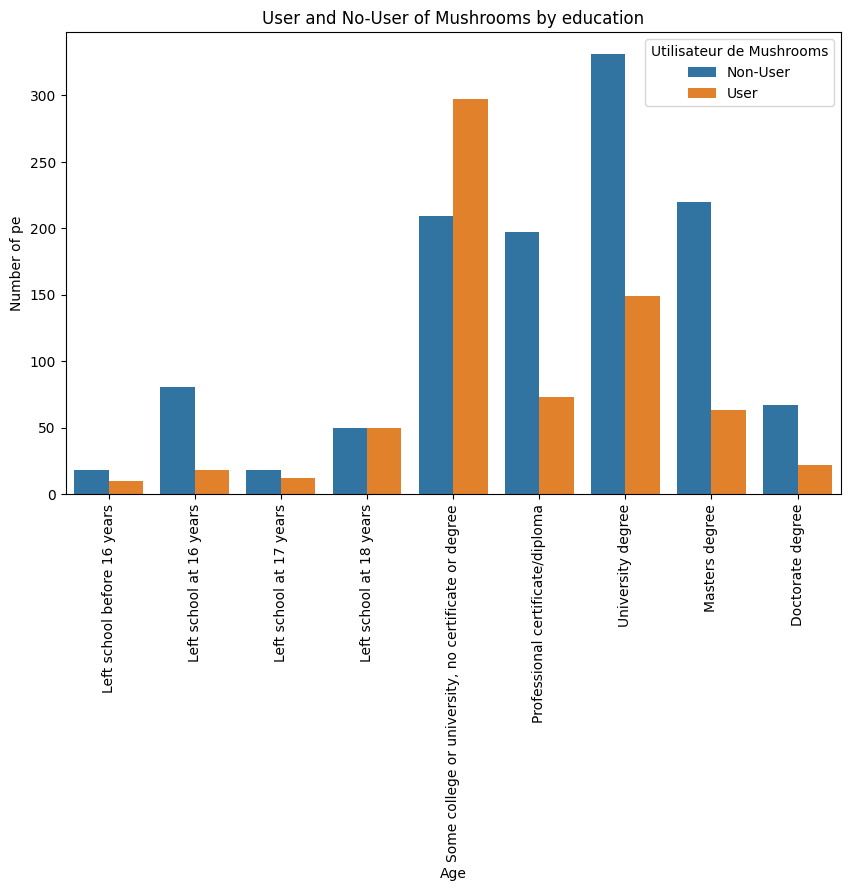

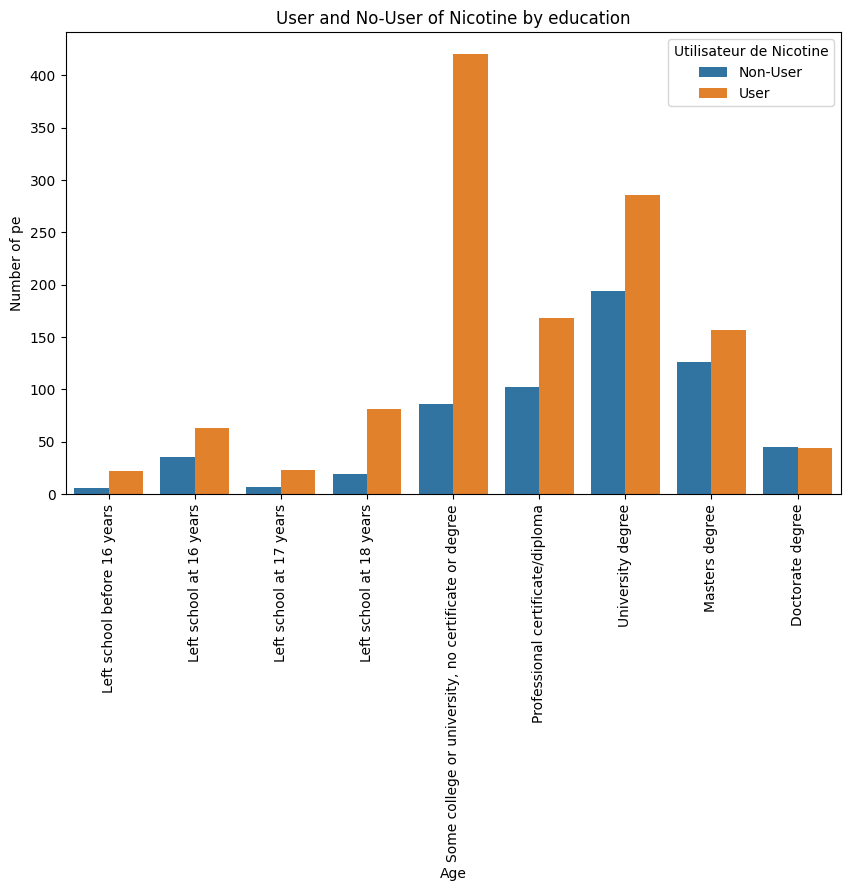

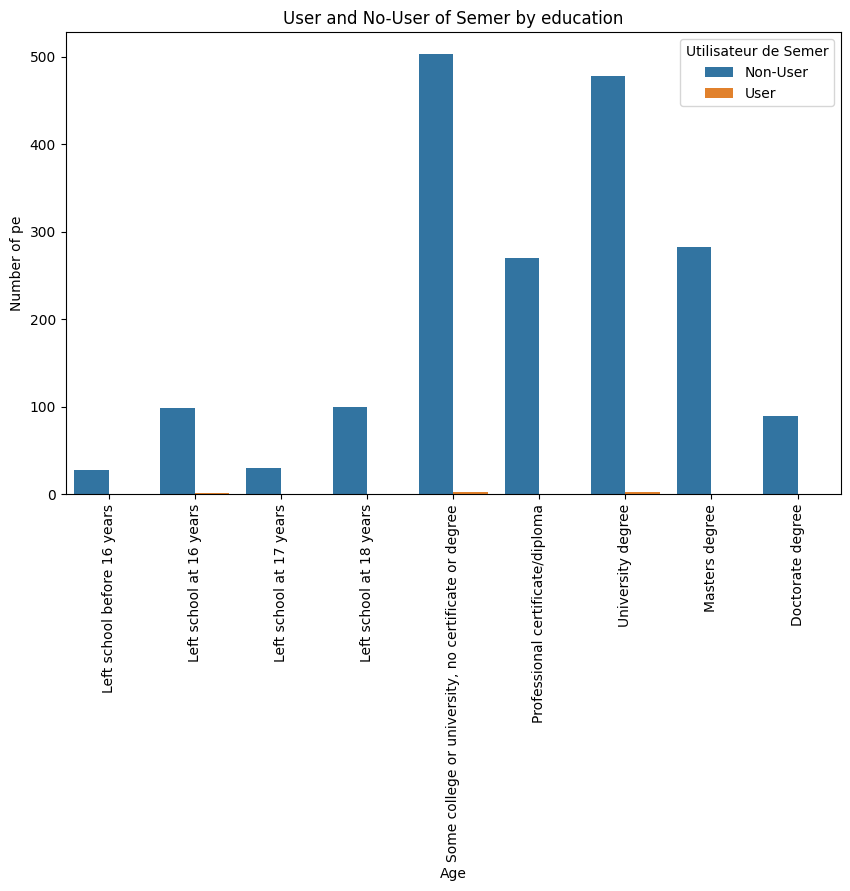

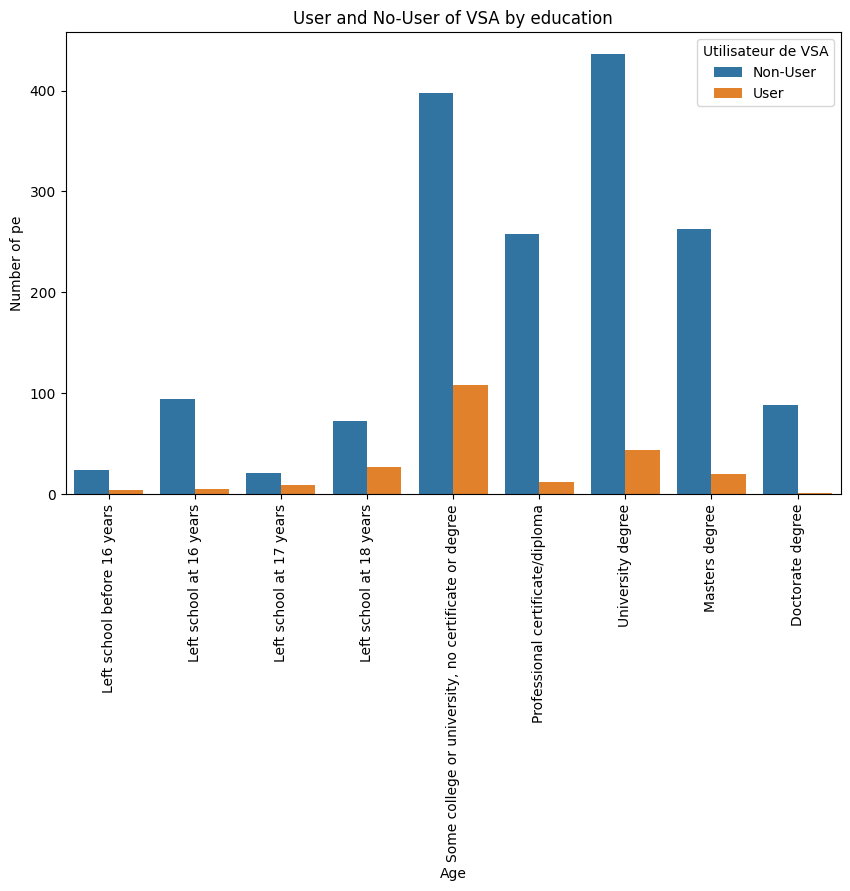

In [72]:
substances = [
    'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke',
    'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth',
    'Mushrooms', 'Nicotine', 'Semer', 'VSA']
    
education_order = ["Left school before 16 years", "Left school at 16 years","Left school at 17 years", 
                        "Left school at 18 years","Some college or university, no certificate or degree",
                        "Professional certificate/diploma","University degree","Masters degree","Doctorate degree"]
for substance in substances:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_uu, x='Education', hue=substance,order=education_order)
    plt.xlabel('Age')
    plt.ylabel('Number of pe')
    plt.title(f'User and No-User of {substance} by education')
    plt.legend(title=f'Utilisateur de {substance}', labels=['Non-User', 'User'])
    plt.xticks(rotation=90)
    plt.show()


We observe that the distribution between each category in the dataset is too disproportionate, making these plots unusable. Now let's look at the scores.

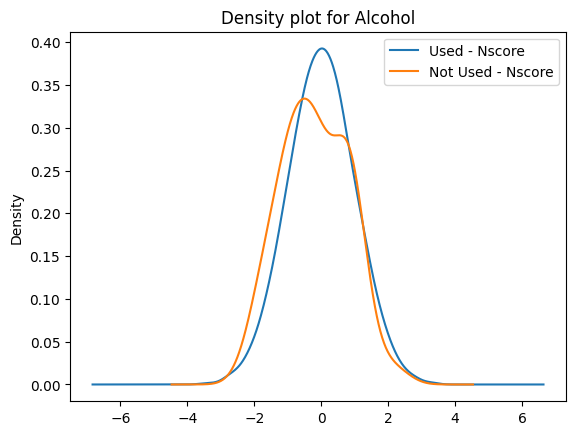

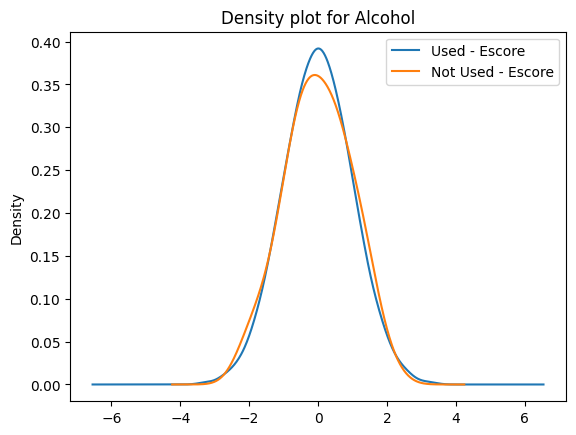

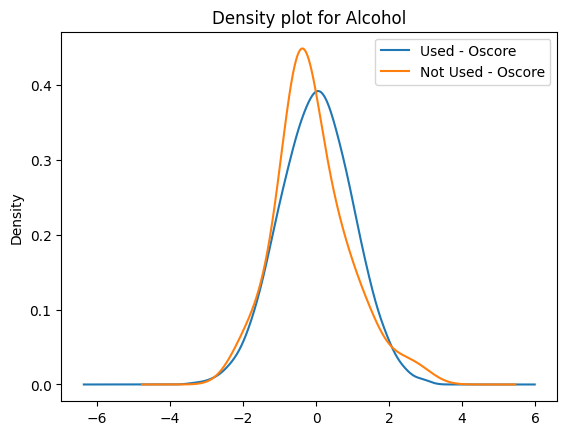

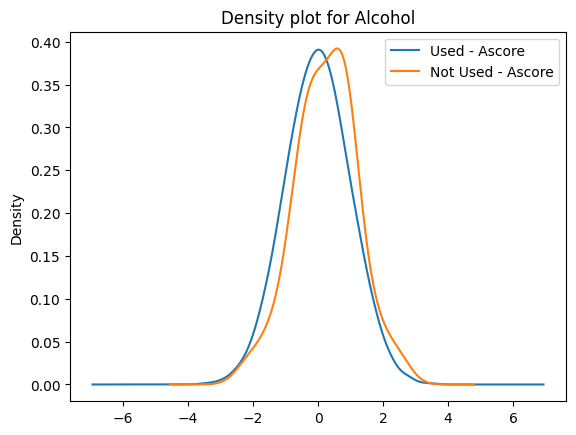

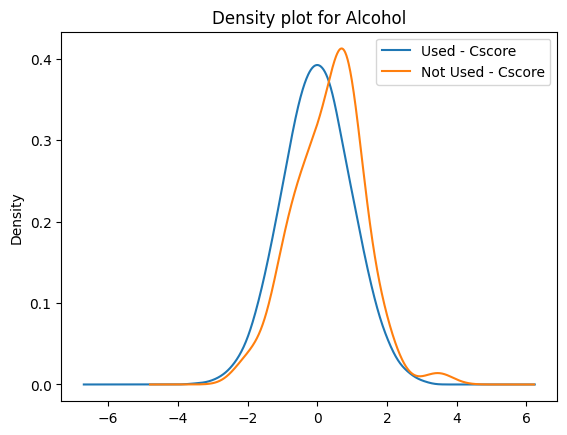

...

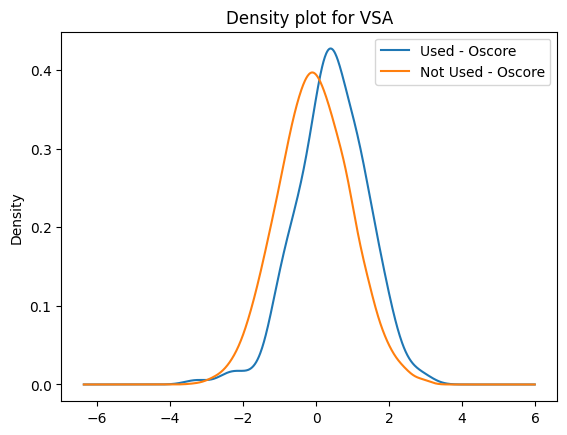

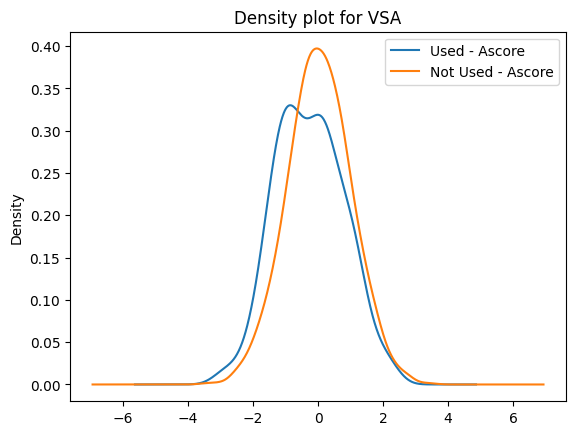

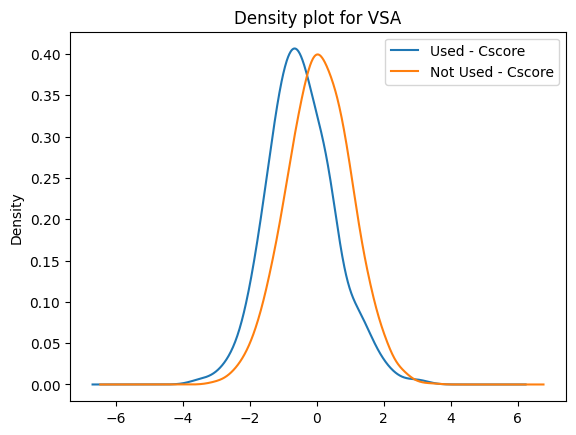

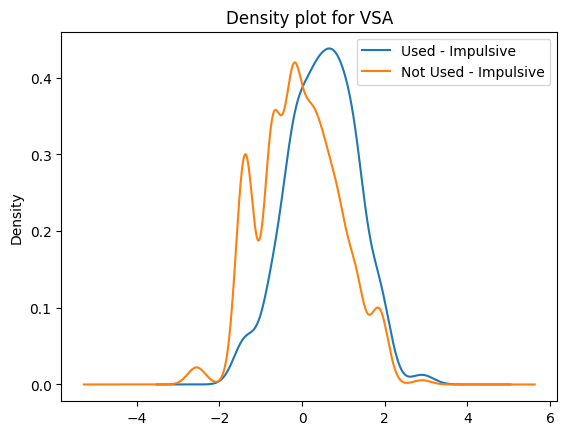

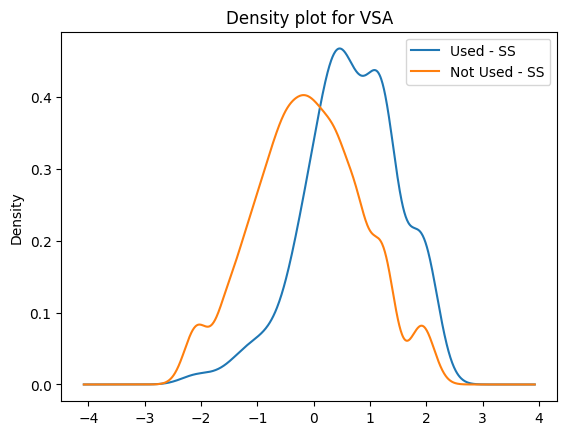

In [73]:
drugs = ['Alcohol','Amphet','Amyl','Benzos','Caff','Canabis','Choc','Coke','Crack','Ecstasy','Heroin','Ketamin','Legalh','LSD','Meth','Mushrooms','Nicotine','Semer','VSA']

for drug in drugs:
    k = 6
    NotUsed = df_users1.loc[df_users1[drug] == 0]
    Used = df_users1.loc[df_users1[drug] == 1]
    while k < 13:
        fig, ax = plt.subplots(1, 1)
        Used.iloc[:, k].plot(kind='density', label="Used - " + Used.columns.values[k])
        NotUsed.iloc[:, k].plot(kind='density', label="Not Used - " + NotUsed.columns.values[k])
        k += 1
        plt.legend()
        plt.title(f"Density plot for {drug}")
        plt.show()


### Let's analyze if the type of drugs consumed has an impact on score between Users and Non-users
(scroll to next chart)

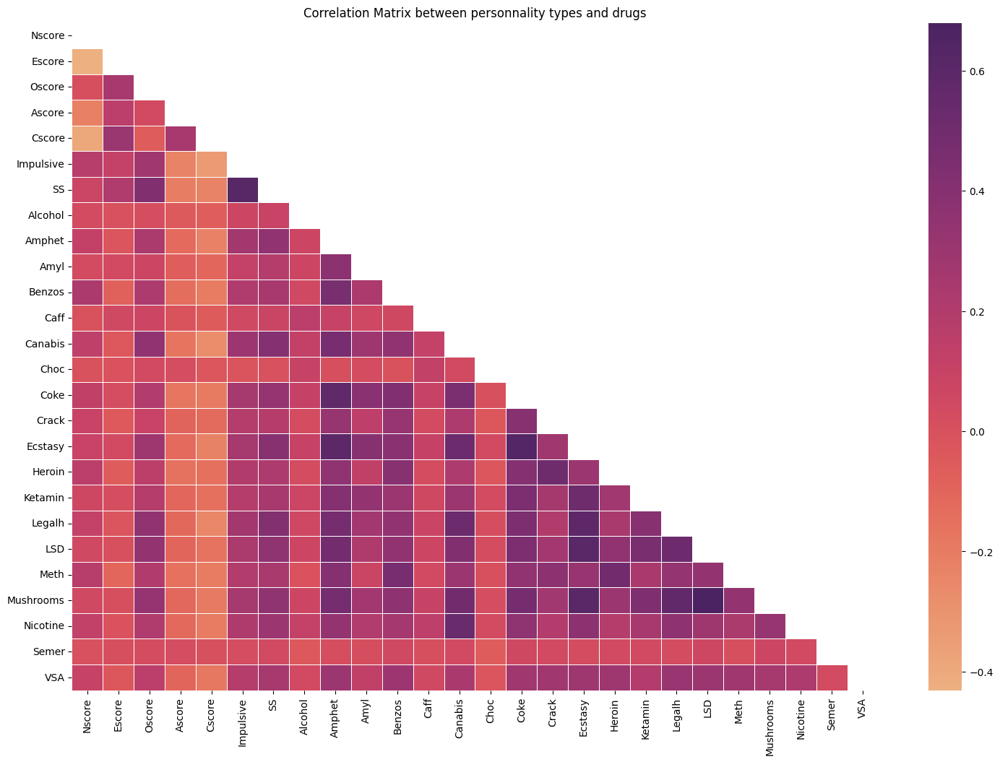

In [75]:
personality_columns = ['Nscore','Escore', 'Oscore', 'Ascore', 'Cscore', 'Impulsive', 'SS']
drug_columns = ['Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack','Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms','Nicotine', 'Semer', 'VSA']

selected_columns = personality_columns + drug_columns
selected_data = df_users_base[selected_columns]

correlation_matrix = selected_data.corr()

fig, ax = plt.subplots(figsize=(18, 12))
mask = np.triu(correlation_matrix)
sns.heatmap(correlation_matrix, cmap='flare', fmt=".2f", linewidths=.5, mask = mask)

plt.title('Correlation Matrix between personnality types and drugs')
plt.show()

We clearly observe that each time, the distribution of each score is not the same depending on whether it is a consumer or not.
So the scores give us important information.

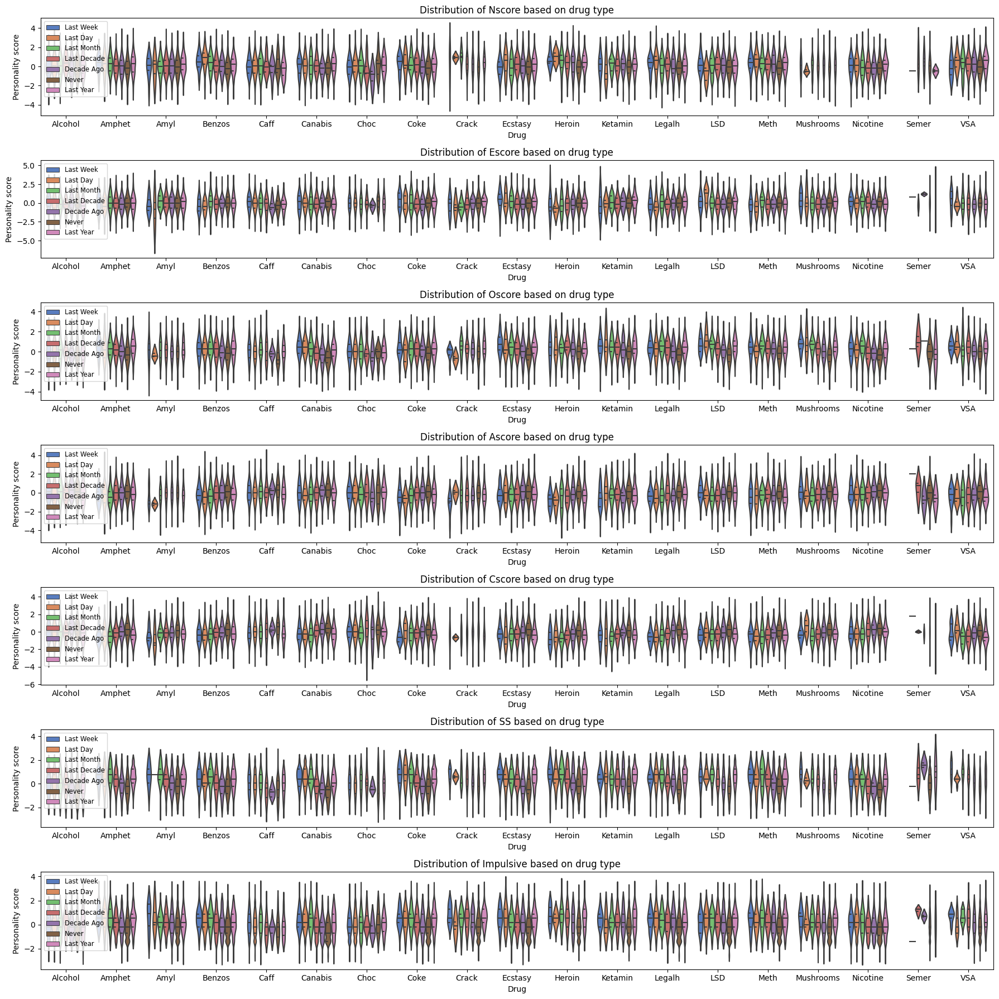

In [76]:
selected_columns = ['Nscore', 'Escore', 'Oscore', 'Ascore', 'Cscore', 'SS', 'Impulsive', 'Alcohol', 'Amphet', 'Amyl', 'Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack',
           'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
df_selected = df[selected_columns]

df_melted = pd.melt(df_selected, id_vars=['Nscore', 'Escore', 'Oscore', 'Ascore', 'Cscore', 'SS', 'Impulsive'], var_name='Drogue', value_name='Consommation')


plt.figure(figsize=(18, 18))

personality_types = ['Nscore', 'Escore', 'Oscore', 'Ascore', 'Cscore', 'SS', 'Impulsive']

for i, personality_type in enumerate(personality_types, 1):
    plt.subplot(7, 1, i)
    ax = sns.violinplot(x='Drogue', y=personality_type, hue='Consommation', data=df_melted, inner='quart', palette='muted')
    plt.title(f'Distribution of {personality_type} based on drug type')
    plt.xlabel('Drug')
    plt.ylabel('Personality score')
    ax.legend(loc='upper left', fontsize='small')
    
plt.tight_layout()
plt.show()

These plots provides us many observations, for example :
Amphematine significantly increases impulsivity. 
Heroin significantly raises neuroticism in individuals who have recently taken it. 
LSD enhances sensation seeking in individuals who have taken it the previous day.
Individuals who regularly consume crack tend to be particularly neurotic. 
Amyl and Crack have an impact on openness in individuals who regularly use them. People who take crack experience a sense of agreeableness that diminishes after a week.
Semeron appears to have an effect on all individuals who have previously taken it, but it is a special case since it's a fictitious drug.

For better visualization, we can observe the personnality types for each drugs. Enter a drug name, for example crack : 

Enter a drug name to display the associated plot: Crack


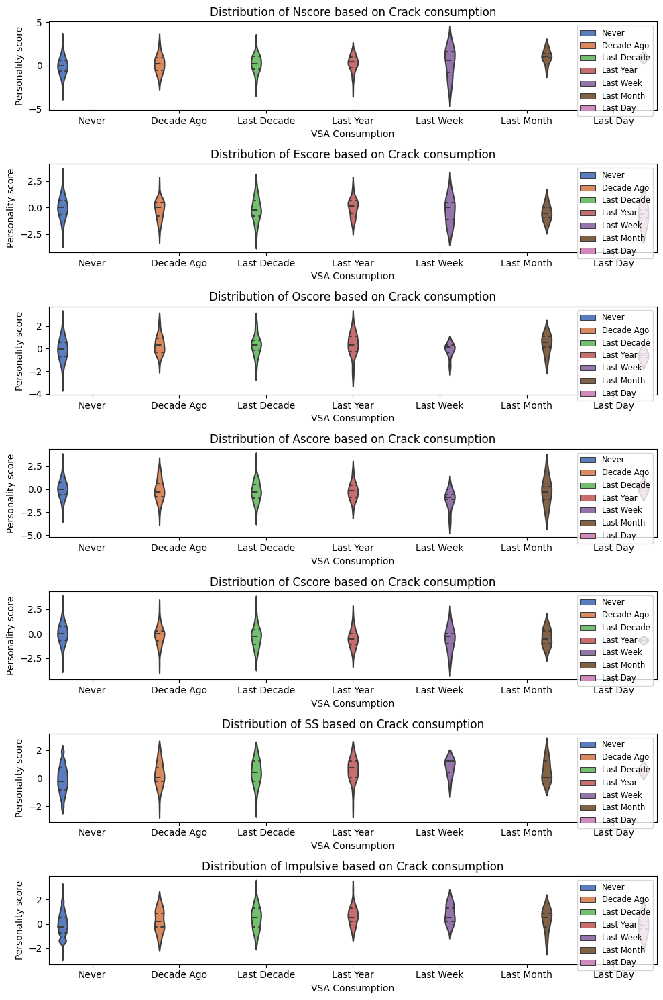

In [77]:
plt.figure(figsize=(10, 15))

personality_types = ['Nscore', 'Escore', 'Oscore', 'Ascore', 'Cscore', 'SS', 'Impulsive']

user_input = 'Crack'
user_input = input("Enter a drug name to display the associated plot: ")

for i, personality_type in enumerate(personality_types, 1):
    plt.subplot(7, 1, i)
    ax = sns.violinplot(x=user_input, y=personality_type, hue=df_selected[user_input], data=df_selected, inner='quart', palette='muted')
    plt.title(f'Distribution of {personality_type} based on {user_input} consumption')
    plt.xlabel(f'{drug} Consumption')
    plt.ylabel('Personality score')
    ax.legend(loc='upper right', fontsize='small')

plt.tight_layout()
plt.show()

<Axes: >

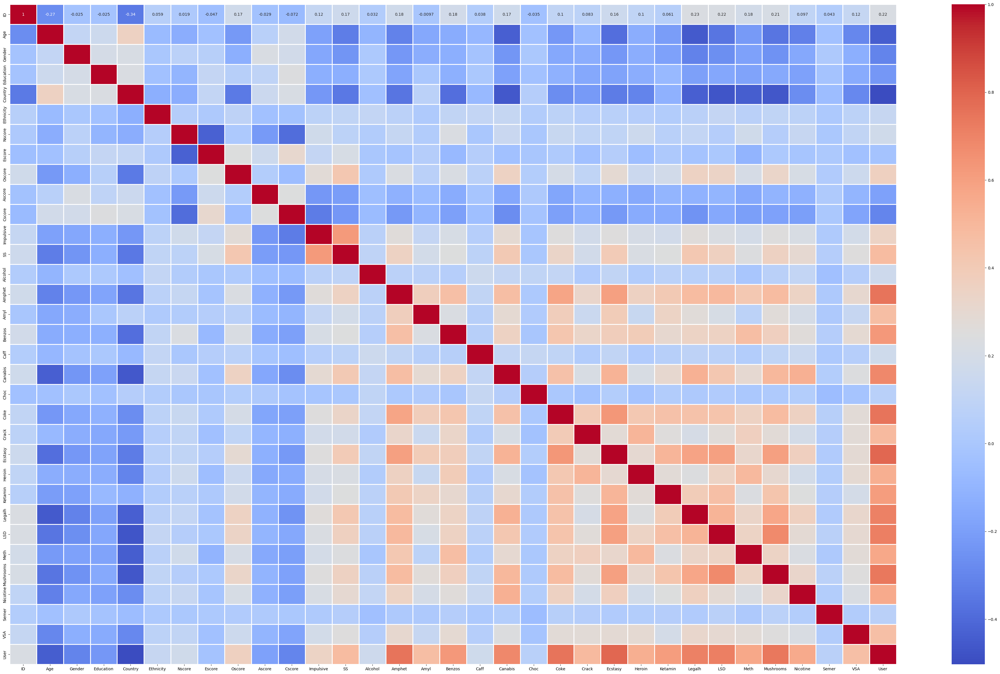

In [78]:
corr = df_users1.corr()
plt.subplots(figsize=(50,30))
sns.heatmap(df_users1.corr(),annot=True,lw=2,cmap='coolwarm')


We observe that:
   If we use a certain drug we are more likely to use another, including coke and Amphet, Ecstassy and Amphet, Mushrooms and LSD.

## Modeling

In [79]:

#Logistic regression
list_accuracy=[]
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50) #Séparation des données
    model=LogisticRegression() #Initialisation
    model.fit(X_train, y_train) #Training
    y_pred = model.predict(X_test) #Prédiction
    accuracy=accuracy_score(y_test, y_pred) #Evaluation
    list_accuracy.append(accuracy)
    report=classification_report(y_test, y_pred)
    

In [166]:
for i in range(len(drugs_columns)):
    print(str(drugs_columns[i])+" : "+str(list_accuracy[i]))

Alcohol : 0.9734748010610079
Amphet : 0.7320954907161804
Amyl : 0.8143236074270557
Benzos : 0.6923076923076923
Caff : 0.9734748010610079
Canabis : 0.7161803713527851
Choc : 0.9814323607427056
Coke : 0.6896551724137931
Crack : 0.896551724137931
Ecstasy : 0.7029177718832891
Heroin : 0.8938992042440318
Ketamin : 0.830238726790451
Legalh : 0.7427055702917772
LSD : 0.753315649867374
Meth : 0.8010610079575596
Mushrooms : 0.7241379310344828
Nicotine : 0.649867374005305
Semer : 0.9946949602122016
VSA : 0.8938992042440318


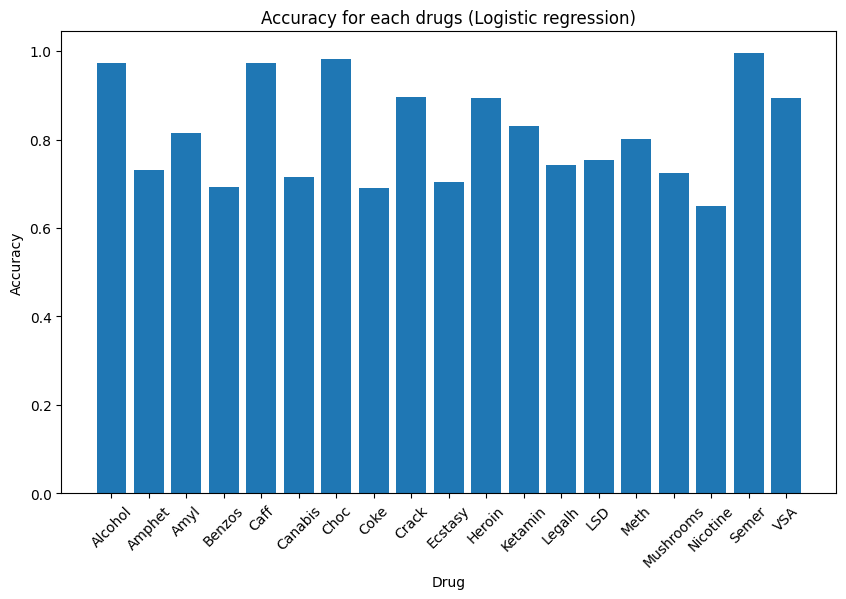

In [167]:
plt.figure(figsize=(10, 6))
plt.bar(drugs_columns, list_accuracy)
plt.title('Accuracy for each drugs (Logistic regression)')
plt.xlabel('Drug')
plt.ylabel('Accuracy')
plt.xticks(rotation=45)
plt.show()


In [80]:
#RF
list_accuracy1=[]
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50) #Data separation
    model = RandomForestClassifier(n_estimators=100, random_state=42) #Initialization
    model.fit(X_train, y_train) #Training
    y_pred = model.predict(X_test) #Prediction
    accuracy=accuracy_score(y_test, y_pred)#Evaluation
    list_accuracy1.append(accuracy)
    report=classification_report(y_test, y_pred)


In [169]:
for i in range(len(drugs_columns)):
    print(str(drugs_columns[i])+" : "+str(list_accuracy1[i]))

Alcohol : 0.9734748010610079
Amphet : 0.636604774535809
Amyl : 0.8063660477453581
Benzos : 0.623342175066313
Caff : 0.9734748010610079
Canabis : 0.7241379310344828
Choc : 0.9814323607427056
Coke : 0.6631299734748011
Crack : 0.896551724137931
Ecstasy : 0.6816976127320955
Heroin : 0.8912466843501327
Ketamin : 0.8275862068965517
Legalh : 0.7214854111405835
LSD : 0.7294429708222812
Meth : 0.7612732095490716
Mushrooms : 0.6710875331564987
Nicotine : 0.6127320954907162
Semer : 0.9946949602122016
VSA : 0.883289124668435


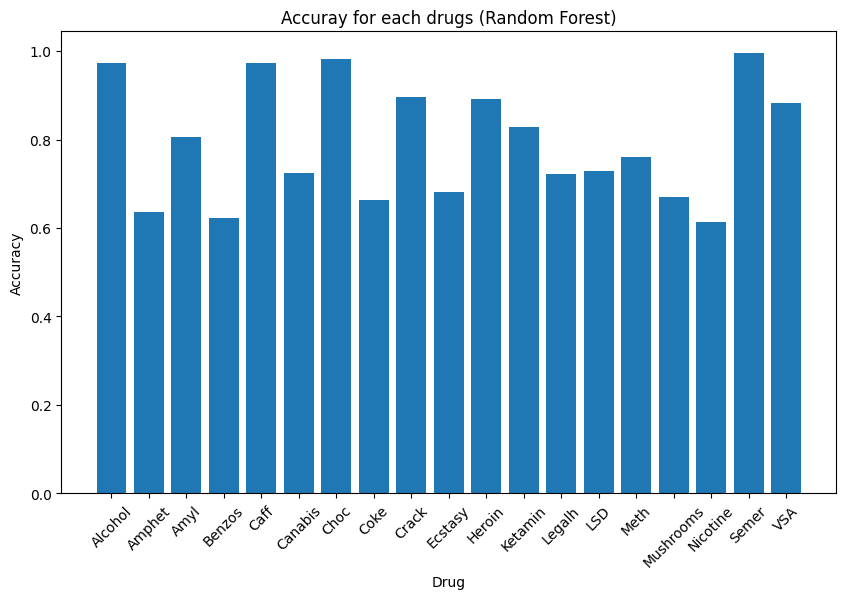

In [170]:
plt.figure(figsize=(10, 6))
plt.bar(drugs_columns,list_accuracy1)
plt.title('Accuray for each drugs (Random Forest)')
plt.xlabel('Drug')
plt.ylabel('Accuracy')
plt.xticks(rotation=45)
plt.show()

In [171]:
#Neural network
list_accuracy2=[]
drugs_columns =['Alcohol','Amphet','Amyl','Benzos','Caff','Canabis','Choc','Coke','Crack','Ecstasy','Heroin','Ketamin','Legalh','LSD', 'Meth','Mushrooms','Nicotine','Semer','VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    label_encoder = LabelEncoder()
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50)#Séparation 
    model=Sequential()#Initialisation
    model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
    model.add(Dense(32, activation='relu'))#Ccache
    model.add(Dense(1, activation='sigmoid'))#csortie
    #Compilation
    model.compile(loss='binary_crossentropy',optimizer='adam',metrics=['accuracy'])
    model.fit(X_train,y_train, epochs=10, batch_size=32,validation_data=(X_test,y_test))
    accuracy=model.evaluate(X_test, y_test)[1]#Evaluation
    list_accuracy2.append(accuracy)


Epoch 1/10
48/48 [==============================] - 1s 4ms/step - loss: 0.4575 - accuracy: 0.8336 - val_loss: 0.2093 - val_accuracy: 0.9735
Epoch 2/10
48/48 [==============================] - 0s 2ms/step - loss: 0.1894 - accuracy: 0.9615 - val_loss: 0.1471 - val_accuracy: 0.9735
Epoch 3/10
48/48 [==============================] - 0s 2ms/step - loss: 0.1726 - accuracy: 0.9615 - val_loss: 0.1424 - val_accuracy: 0.9735
Epoch 4/10
48/48 [==============================] - 0s 2ms/step - loss: 0.1692 - accuracy: 0.9615 - val_loss: 0.1419 - val_accuracy: 0.9735
Epoch 5/10
48/48 [==============================] - 0s 2ms/step - loss: 0.1659 - accuracy: 0.9615 - val_loss: 0.1392 - val_accuracy: 0.9735
Epoch 6/10
48/48 [==============================] - 0s 2ms/step - loss: 0.1632 - accuracy: 0.9615 - val_loss: 0.1367 - val_accuracy: 0.9735
Epoch 7/10
48/48 [==============================] - 0s 2ms/step - loss: 0.1620 - accuracy: 0.9615 - val_loss: 0.1366 - val_accuracy: 0.9735
Epoch 8/10
48/48 [==

12/12 [==============================] - 0s 2ms/step - loss: 0.2904 - accuracy: 0.8939
Epoch 1/10
48/48 [==============================] - 1s 4ms/step - loss: 0.5531 - accuracy: 0.7520 - val_loss: 0.4499 - val_accuracy: 0.8382
Epoch 2/10
48/48 [==============================] - 0s 2ms/step - loss: 0.4681 - accuracy: 0.8084 - val_loss: 0.4416 - val_accuracy: 0.8382
Epoch 3/10
48/48 [==============================] - 0s 2ms/step - loss: 0.4577 - accuracy: 0.8077 - val_loss: 0.4377 - val_accuracy: 0.8382
Epoch 4/10
48/48 [==============================] - 0s 2ms/step - loss: 0.4552 - accuracy: 0.8084 - val_loss: 0.4359 - val_accuracy: 0.8382
Epoch 5/10
48/48 [==============================] - 0s 2ms/step - loss: 0.4548 - accuracy: 0.8084 - val_loss: 0.4356 - val_accuracy: 0.8382
Epoch 6/10
48/48 [==============================] - 0s 2ms/step - loss: 0.4520 - accuracy: 0.8084 - val_loss: 0.4355 - val_accuracy: 0.8382
Epoch 7/10
48/48 [==============================] - 0s 2ms/step - loss: 0

Epoch 6/10
48/48 [==============================] - 0s 2ms/step - loss: 0.5776 - accuracy: 0.6996 - val_loss: 0.6177 - val_accuracy: 0.6552
Epoch 7/10
48/48 [==============================] - 0s 2ms/step - loss: 0.5758 - accuracy: 0.7029 - val_loss: 0.6149 - val_accuracy: 0.6631
Epoch 8/10
48/48 [==============================] - 0s 2ms/step - loss: 0.5746 - accuracy: 0.7049 - val_loss: 0.6185 - val_accuracy: 0.6525
Epoch 9/10
48/48 [==============================] - 0s 2ms/step - loss: 0.5725 - accuracy: 0.7049 - val_loss: 0.6182 - val_accuracy: 0.6525
Epoch 10/10
12/12 [==============================] - 0s 2ms/step - loss: 0.6149 - accuracy: 0.6578
Epoch 1/10
48/48 [==============================] - 1s 4ms/step - loss: 0.3561 - accuracy: 0.9556 - val_loss: 0.1332 - val_accuracy: 0.9947
Epoch 2/10
48/48 [==============================] - 0s 2ms/step - loss: 0.0712 - accuracy: 0.9973 - val_loss: 0.0468 - val_accuracy: 0.9947
Epoch 3/10
48/48 [==============================] - 0s 2ms/st

In [172]:
for i in range(len(drugs_columns)):
    print(str(drugs_columns[i])+" : "+str(list_accuracy2[i]))

Alcohol : 0.9734748005867004
Amphet : 0.721485435962677
Amyl : 0.8143236041069031
Benzos : 0.7082228064537048
Caff : 0.9734748005867004
Canabis : 0.7374005317687988
Choc : 0.9814323782920837
Coke : 0.6790450811386108
Crack : 0.8965517282485962
Ecstasy : 0.702917754650116
Heroin : 0.8938992023468018
Ketamin : 0.8381962776184082
Legalh : 0.7427055835723877
LSD : 0.7586206793785095
Meth : 0.7824933528900146
Mushrooms : 0.7347480058670044
Nicotine : 0.6578249335289001
Semer : 0.9946949481964111
VSA : 0.8938992023468018


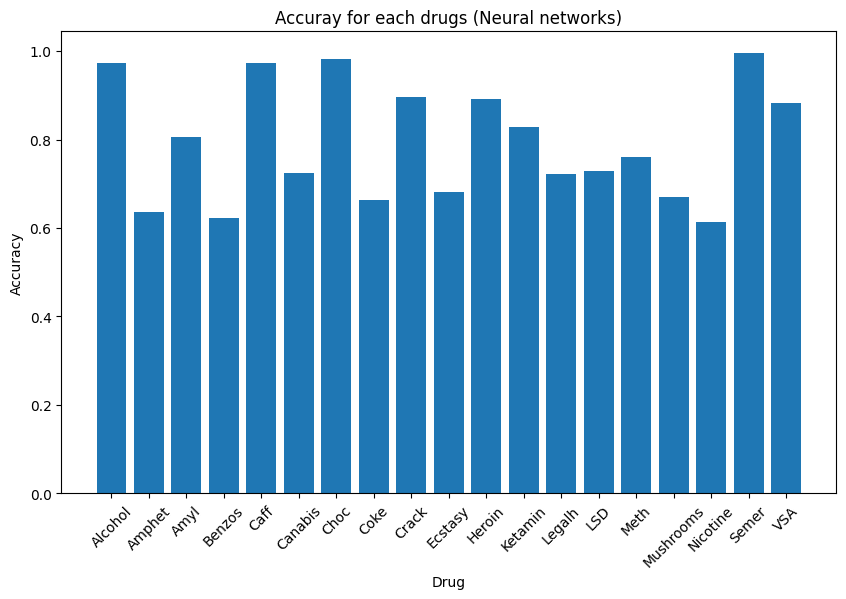

In [173]:
plt.figure(figsize=(10,6))
plt.bar(drugs_columns,list_accuracy1)
plt.title('Accuray for each drugs (Neural networks)')
plt.xlabel('Drug')
plt.ylabel('Accuracy')
plt.xticks(rotation=45)
plt.show()

In [81]:
#Knn
list_accuracy3=[]
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50) #Data separation
    knn = KNeighborsClassifier(n_neighbors=3)
    knn.fit(X_train, y_train)
    y_pred=knn.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    list_accuracy3.append(accuracy)
    report=classification_report(y_test, y_pred)

In [175]:
for i in range(len(drugs_columns)):
    print(str(drugs_columns[i])+" : "+str(list_accuracy3[i]))

Alcohol : 0.9681697612732095
Amphet : 0.623342175066313
Amyl : 0.76657824933687
Benzos : 0.6339522546419099
Caff : 0.9734748010610079
Canabis : 0.6790450928381963
Choc : 0.9814323607427056
Coke : 0.6074270557029178
Crack : 0.8753315649867374
Ecstasy : 0.6259946949602122
Heroin : 0.870026525198939
Ketamin : 0.7612732095490716
Legalh : 0.7029177718832891
LSD : 0.7161803713527851
Meth : 0.7745358090185677
Mushrooms : 0.6737400530503979
Nicotine : 0.610079575596817
Semer : 0.9946949602122016
VSA : 0.8461538461538461


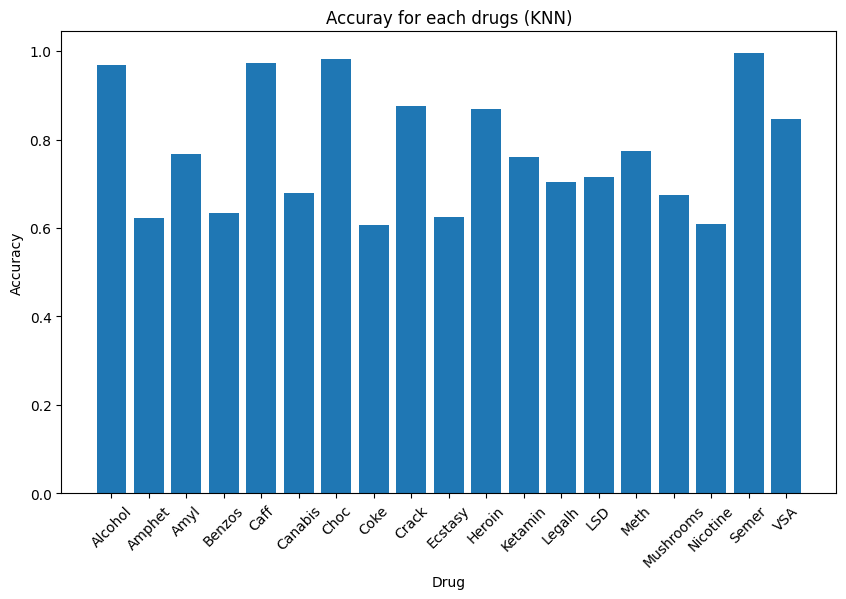

In [176]:
plt.figure(figsize=(10,6))
plt.bar(drugs_columns,list_accuracy3)
plt.title('Accuray for each drugs (KNN)')
plt.xlabel('Drug')
plt.ylabel('Accuracy')
plt.xticks(rotation=45)
plt.show()

In [82]:
param_grid_rf = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10, 15],
}

param_grid_nn = {
    'hidden_layer_sizes': [(50,), (100,), (50, 50), (100, 50)],
    'activation': ['relu', 'tanh'],
    'max_iter': [500, 1000],
}

param_grid_reg = {
    'C': [0.1, 1, 10],
    'solver': ['liblinear', 'lbfgs'],
}

param_grid_neur = {
    'hidden_layer_sizes': [(50,), (100,), (50, 50), (100, 50)],
    'activation': ['relu', 'tanh'],
    'max_iter': [500, 1000],
}

param_grid = {'n_neighbors': range(1, 40)}
# Création des modèles
rf = RandomForestClassifier(random_state=42)
nn = MLPClassifier(random_state=42)
reg = LogisticRegression(random_state=42)
knn = KNeighborsClassifier()
neur = MLPClassifier(random_state=42)

In [83]:
#RandomForestClassifier
grid_search_rf = GridSearchCV(rf, param_grid_rf, cv=5)
grid_search_rf.fit(X_train, y_train)
best_rf = grid_search_rf.best_estimator_

In [84]:
#MLPClassifier
grid_search_nn = GridSearchCV(nn, param_grid_nn, cv=5)
grid_search_nn.fit(X_train, y_train)
best_nn = grid_search_nn.best_estimator_

In [85]:
#LogisticRegression
grid_search_reg = GridSearchCV(reg, param_grid_reg, cv=5)
grid_search_reg.fit(X_train, y_train)
best_reg = grid_search_reg.best_estimator_

In [86]:
#ReseauNeu
grid_search_neur = GridSearchCV(neur, param_grid_neur, cv=5)
grid_search_neur.fit(X_train, y_train)
best_neur = grid_search_neur.best_estimator_

In [87]:
grid_search_knn = GridSearchCV(knn, param_grid, cv=5, scoring='accuracy')
grid_search_knn.fit(X_train, y_train)
best_knn = grid_search_knn.best_estimator_

In [88]:
# Évaluation des modèles sur les données de test
y_pred_rf = best_rf.predict(X_test)
accuracy_rf = accuracy_score(y_test, y_pred_rf)

y_pred_nn = best_nn.predict(X_test)
accuracy_nn = accuracy_score(y_test, y_pred_nn)

y_pred_reg = best_reg.predict(X_test)
accuracy_reg = accuracy_score(y_test, y_pred_reg)

y_pred_knn = best_knn.predict(X_test)
accuracy_knn = accuracy_score(y_test, y_pred_reg)

y_pred_neur = best_neur.predict(X_test)
accuracy_neur = accuracy_score(y_test, y_pred_neur)


In [89]:
print("Meilleurs paramètres RandomForestClassifier :", grid_search_rf.best_params_)
print("Meilleur score RandomForestClassifier :", grid_search_rf.best_score_)
print("Meilleur modèle RandomForestClassifier :", grid_search_rf.best_estimator_)

print("\nMeilleurs paramètres MLPClassifier :", grid_search_nn.best_params_)
print("Meilleur score MLPClassifier :", grid_search_nn.best_score_)
print("Meilleur modèle MLPClassifier :", grid_search_nn.best_estimator_)

print("\nMeilleurs paramètres LogisticRegression :", grid_search_reg.best_params_)
print("Meilleur score LogisticRegression :", grid_search_reg.best_score_)
print("Meilleur modèle LogisticRegression :", grid_search_reg.best_estimator_)

print("\nMeilleurs paramètres KNN :", grid_search_knn.best_params_)
print("Meilleur score KNN :", grid_search_knn.best_score_)
print("Meilleur modèle KNN :", grid_search_knn.best_estimator_)

print("Meilleurs paramètres MLPClassifier :", grid_search_neur.best_params_)
print("Meilleur score MLPClassifier :", grid_search_neur.best_score_)
print("Meilleur modèle MLPClassifier :", grid_search_neur.best_estimator_)


Meilleurs paramètres RandomForestClassifier : {'max_depth': 10, 'n_estimators': 100}
Meilleur score RandomForestClassifier : 0.8733471210754438
Meilleur modèle RandomForestClassifier : RandomForestClassifier(max_depth=10, random_state=42)

Meilleurs paramètres MLPClassifier : {'activation': 'relu', 'hidden_layer_sizes': (100,), 'max_iter': 500}
Meilleur score MLPClassifier : 0.8740049723878462
Meilleur modèle MLPClassifier : MLPClassifier(max_iter=500, random_state=42)

Meilleurs paramètres LogisticRegression : {'C': 0.1, 'solver': 'liblinear'}
Meilleur score LogisticRegression : 0.8726826692482014
Meilleur modèle LogisticRegression : LogisticRegression(C=0.1, random_state=42, solver='liblinear')

Meilleurs paramètres KNN : {'n_neighbors': 20}
Meilleur score KNN : 0.8733449209038305
Meilleur modèle KNN : KNeighborsClassifier(n_neighbors=20)
Meilleurs paramètres MLPClassifier : {'activation': 'relu', 'hidden_layer_sizes': (100,), 'max_iter': 500}
Meilleur score MLPClassifier : 0.8740049

In [90]:
best_accuracy = max(accuracy_rf,accuracy_nn, accuracy_reg,accuracy_knn,accuracy_neur)
best_model = None
if best_accuracy == accuracy_rf:
    best_model= "Random Forest"
elif best_accuracy == accuracy_nn:
    best_model="MLP Classifier"
elif best_accuracy==accuracy_reg:
    best_model="Logistic Regression"
elif best_accuracy==accuracy_knn:
    best_model="KNN"
elif best_accuracy==accuracy_neur:
    best_model=="Neural Network"


print(f"Best model : {best_model} with a precision of {best_accuracy:.4f}")

Best model : Logistic Regression with a precision of 0.8966


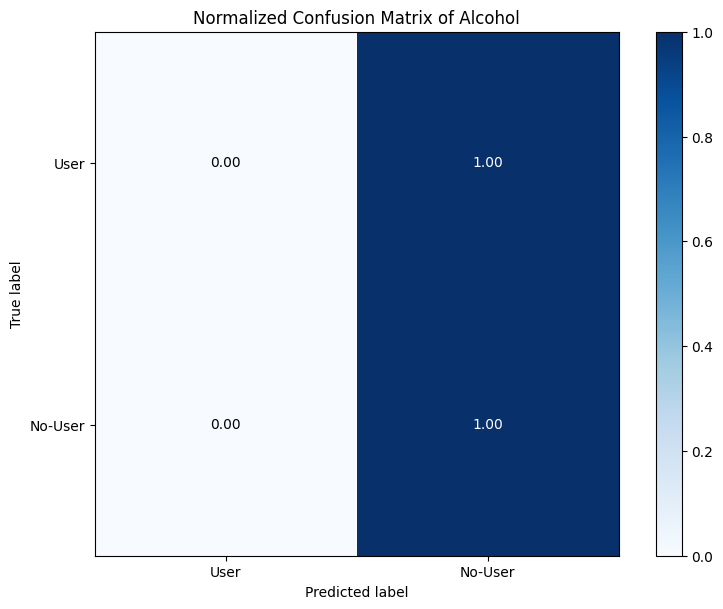

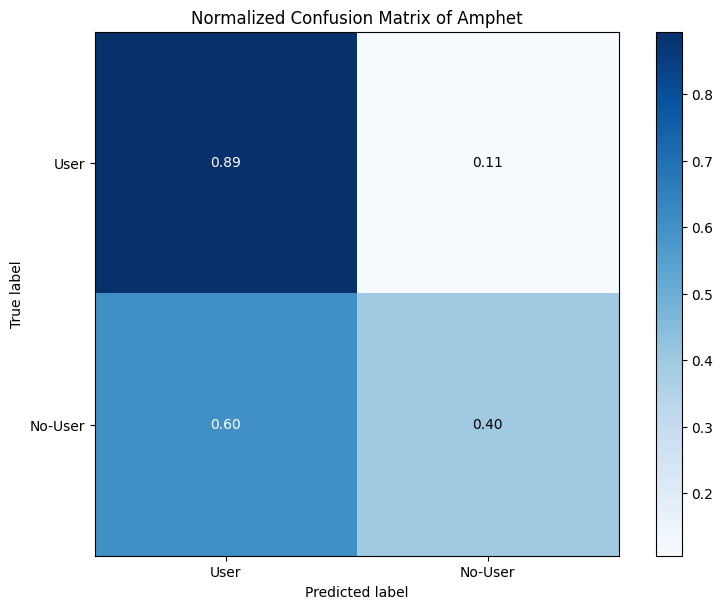

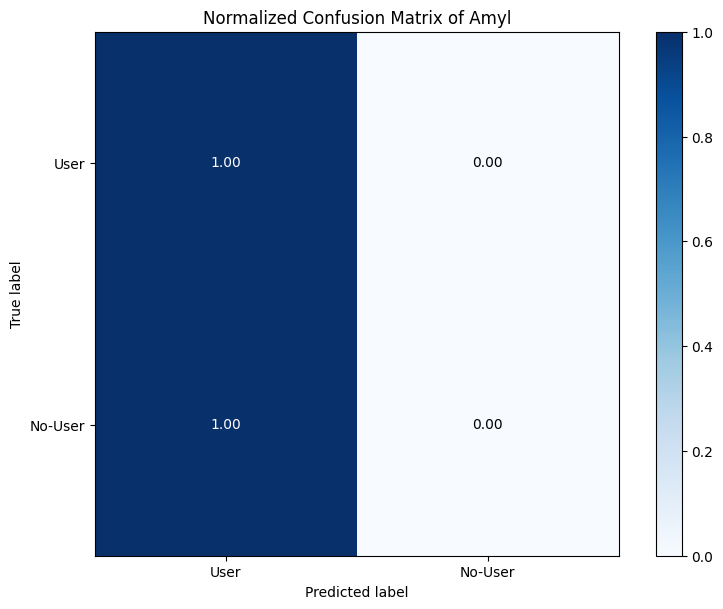

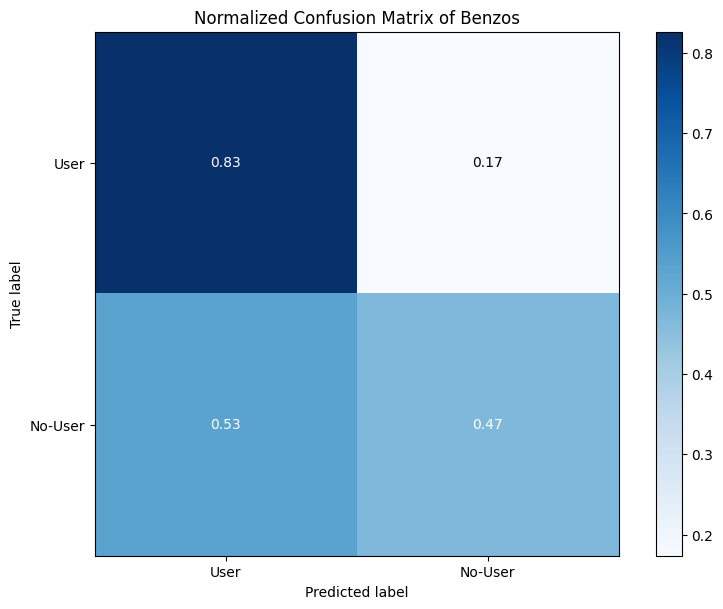

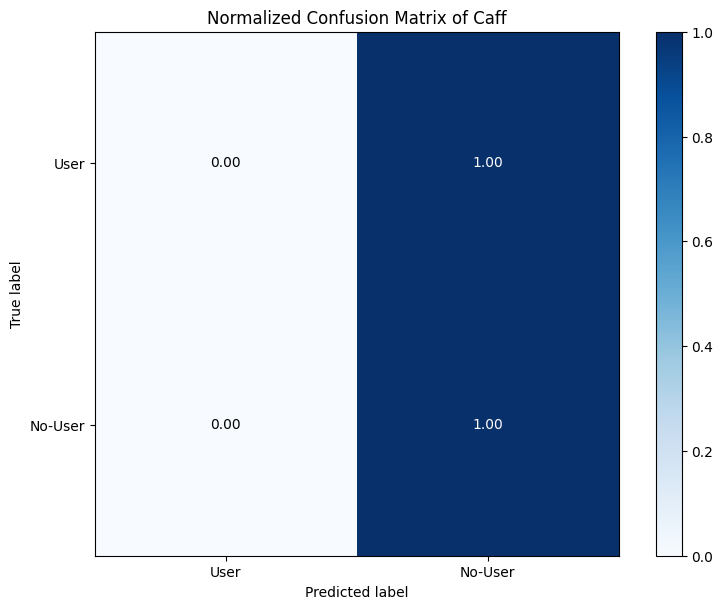

...

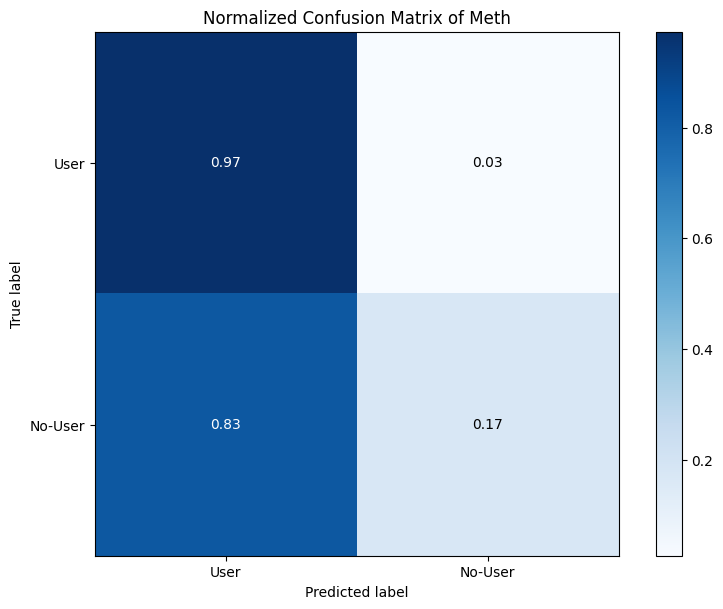

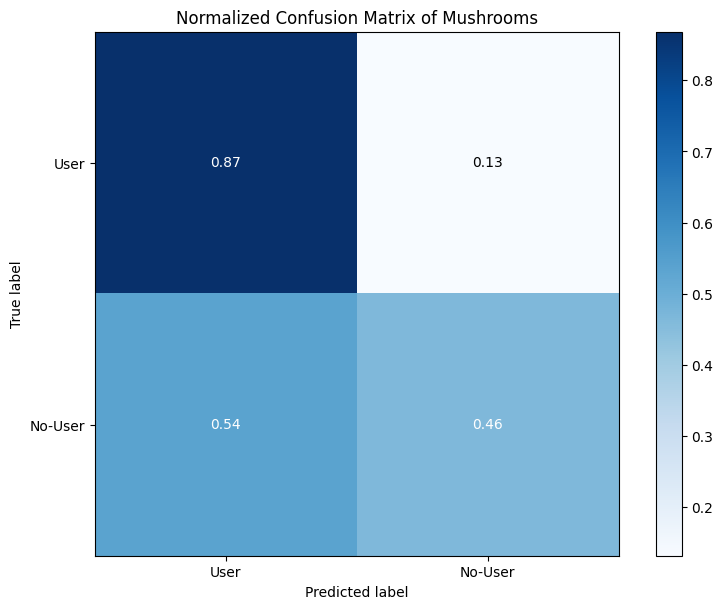

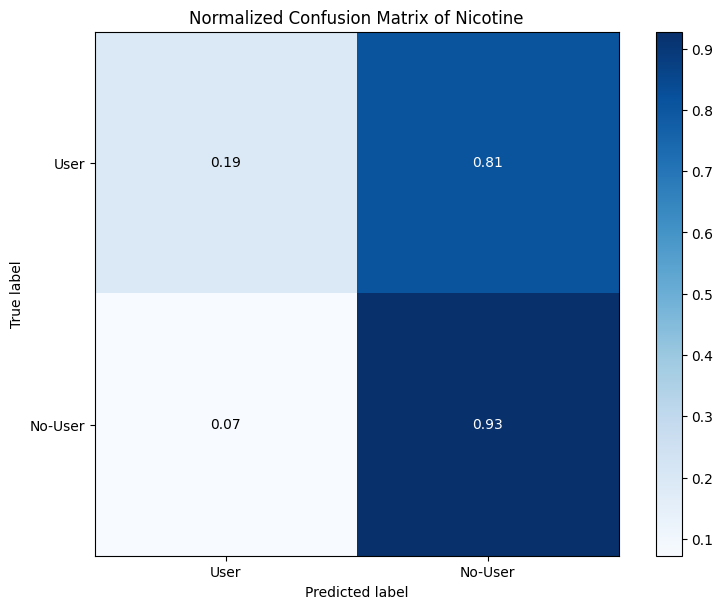

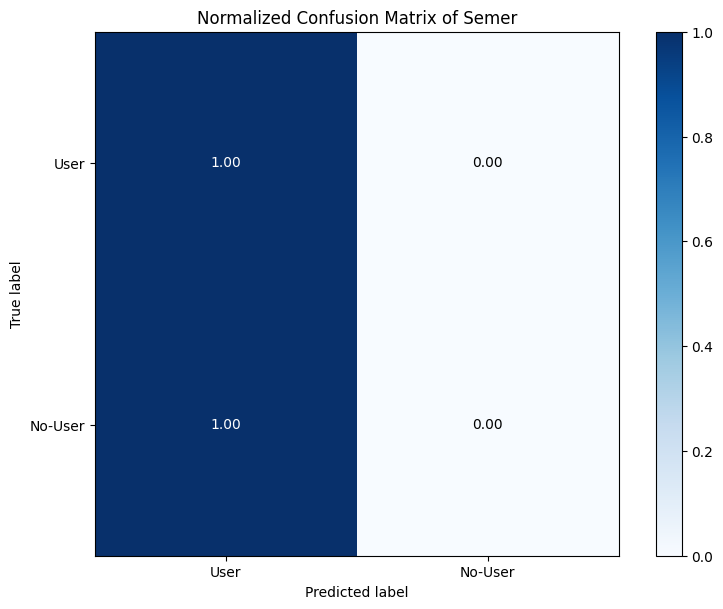

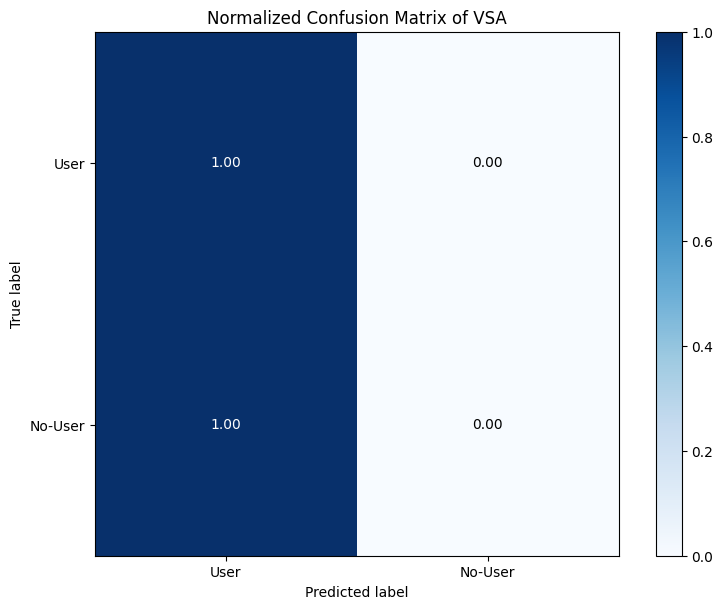

In [91]:
#Logistic regression
list_accuracy=[]
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50) #Séparation des données
    model=LogisticRegression()
    model.fit(X_train, y_train) 
    y_pred = model.predict(X_test)
    accuracy=accuracy_score(y_test, y_pred) 
    list_accuracy.append(accuracy)
    report=classification_report(y_test, y_pred)   
    conf_matrix = confusion_matrix(y_test, y_pred)
    conf_matrix_norm = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(8, 6))
    plt.imshow(conf_matrix_norm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title('Normalized Confusion Matrix of '+ str(drug))
    plt.colorbar()
    
    classes = ['User', 'No-User']
    plt.xticks(np.arange(len(classes)), classes)
    plt.yticks(np.arange(len(classes)), classes)
    
    thresh = conf_matrix_norm.max() / 2. 
    for i in range(conf_matrix_norm.shape[0]):
        for j in range(conf_matrix_norm.shape[1]):
            plt.text(j, i, format(conf_matrix_norm[i, j], '.2f'),
                     ha="center", va="center",
                     color="white" if conf_matrix_norm[i, j] > thresh else "black")
    
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
    plt.show()

User" is predicted as "User" in x% of cases (True Positive).

“User” is predicted as “No-User” in x% of cases (False Negative).

“No-User” is predicted as “User” in x% of cases (False Positive).

“No-User” is predicted as “No-User” in x% of cases (True Negative).

The ROC curve is created by plotting the TPR (True Positive Rate) against the FPR (False Positive Rate) at different classification thresholds.

The AUC gives an overall idea of the model's discrimination ability: a value close to 1 indicates better performance, while a value close to 0.5 suggests performance similar to chance.

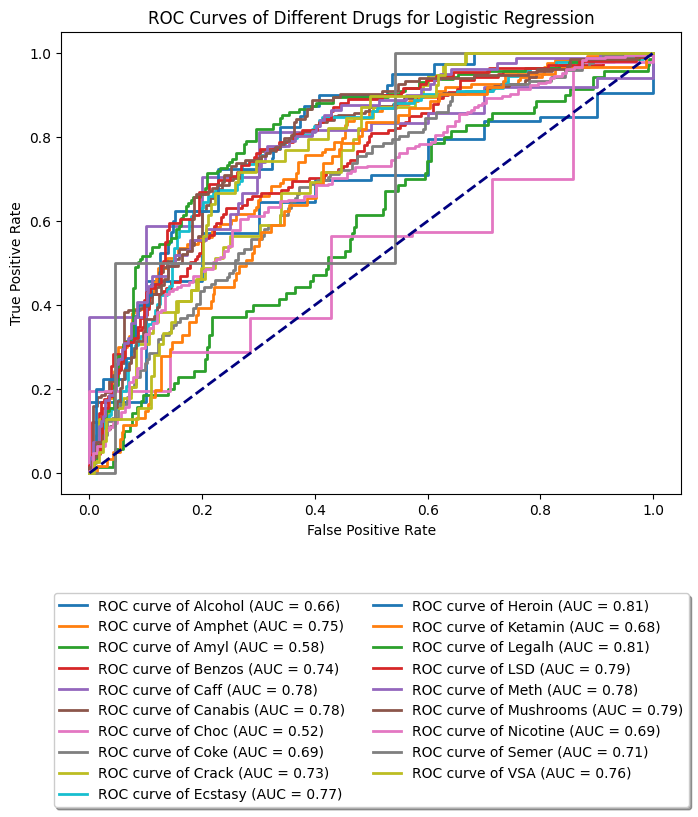

In [223]:
#LogisticRegression
list_auc1 = []
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']

plt.figure(figsize=(8, 6))
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=50)
    
    model = LogisticRegression()
    model.fit(X_train, y_train) 
    
    y_pred_proba = model.predict_proba(X_test)[:, 1] 
    
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba) 
    auc_score = auc(fpr, tpr)
    
    list_auc1.append(auc_score)  
    plt.plot(fpr, tpr, lw=2, label='ROC curve of ' + str(drug) + ' (AUC = %0.2f)' % auc_score)

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')  
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves of Different Drugs for Logistic Regression')
plt.legend(loc='lower right')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), shadow=True, ncol=2)
plt.show()


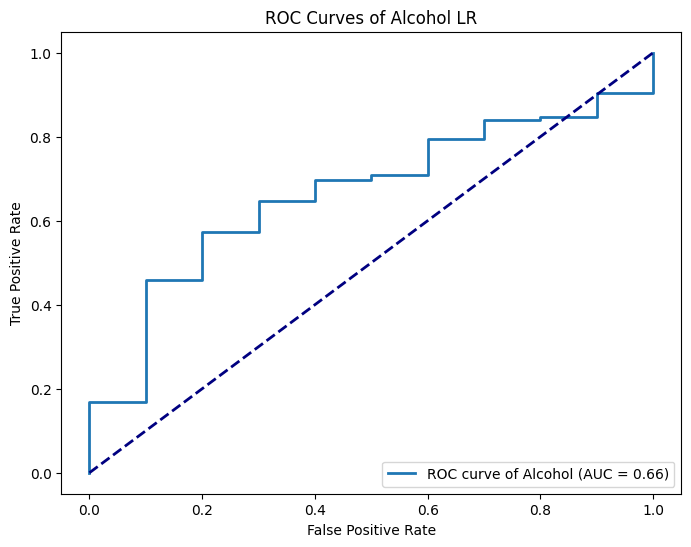

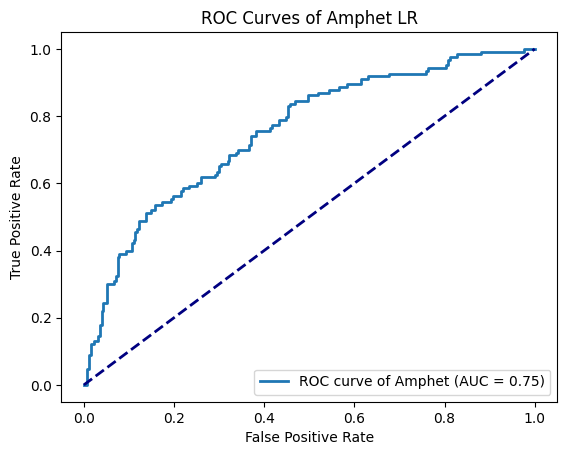

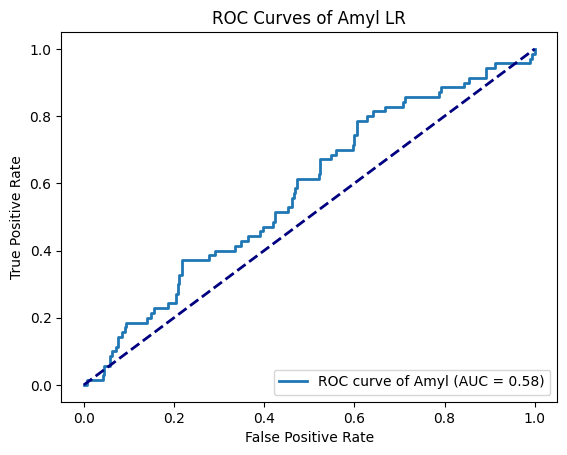

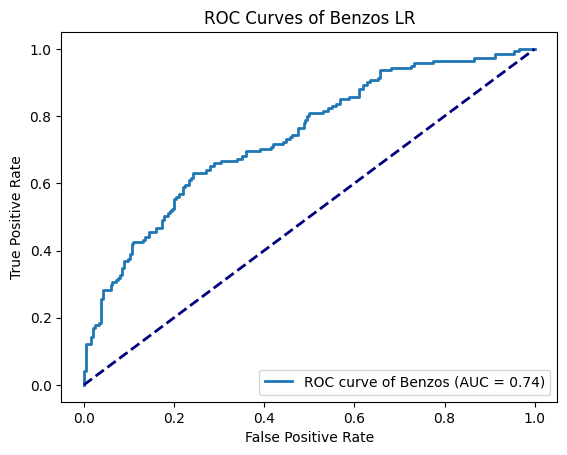

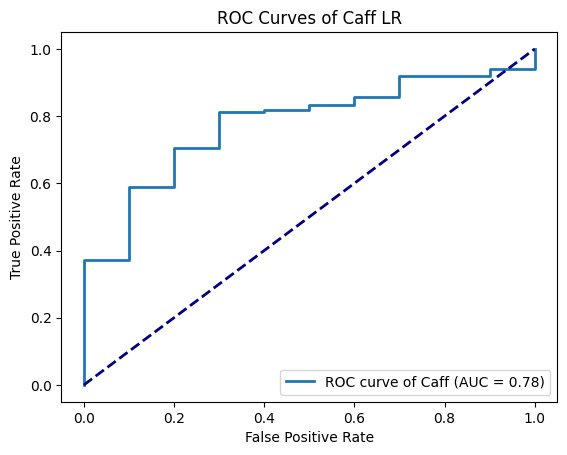

...

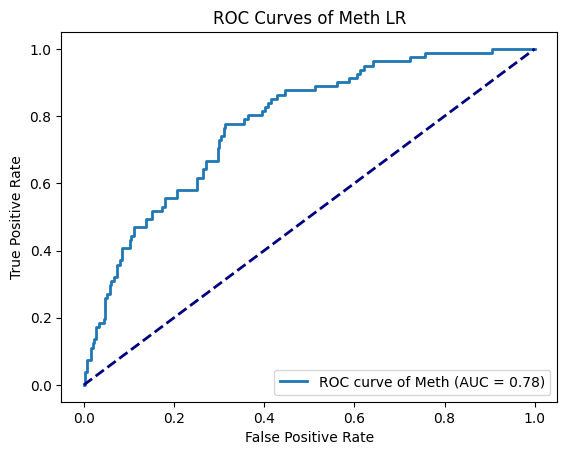

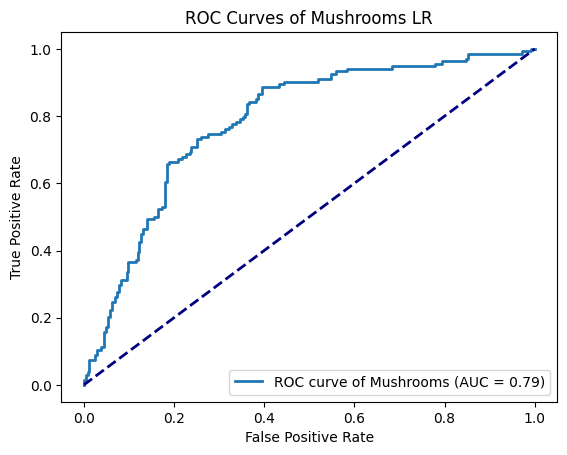

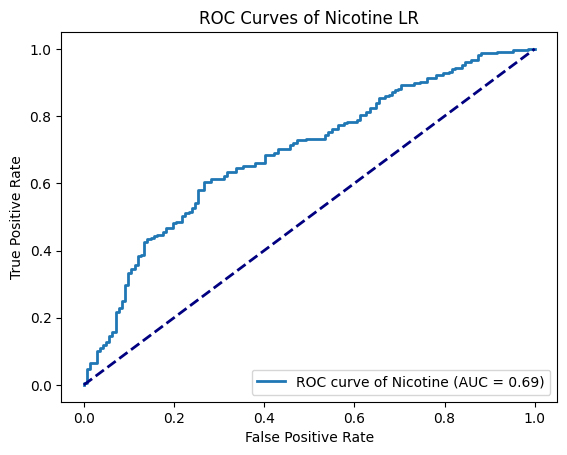

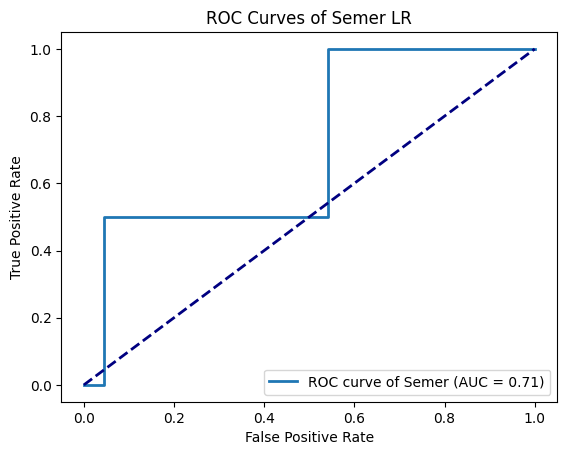

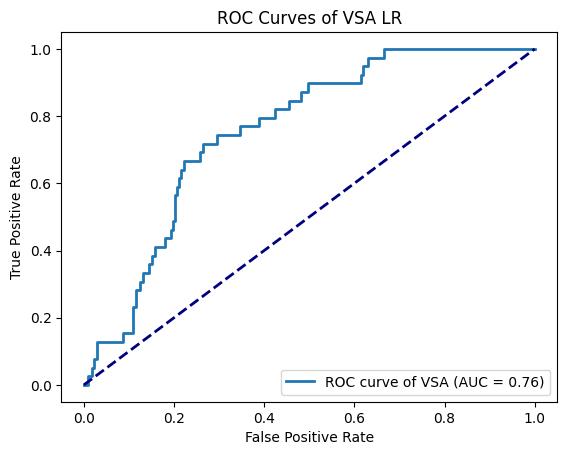

In [208]:
list_auc1 = []
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']

plt.figure(figsize=(8, 6))
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=50)
    
    model = LogisticRegression()
    model.fit(X_train, y_train)  
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc_score = auc(fpr, tpr)   
    list_auc1.append(auc_score)
    plt.plot(fpr, tpr, lw=2, label='ROC curve of ' + str(drug) + ' (AUC = %0.2f)' % auc_score)

    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves of '+str(drug)+ ' LR')
    plt.legend(loc='lower right')
    plt.show()


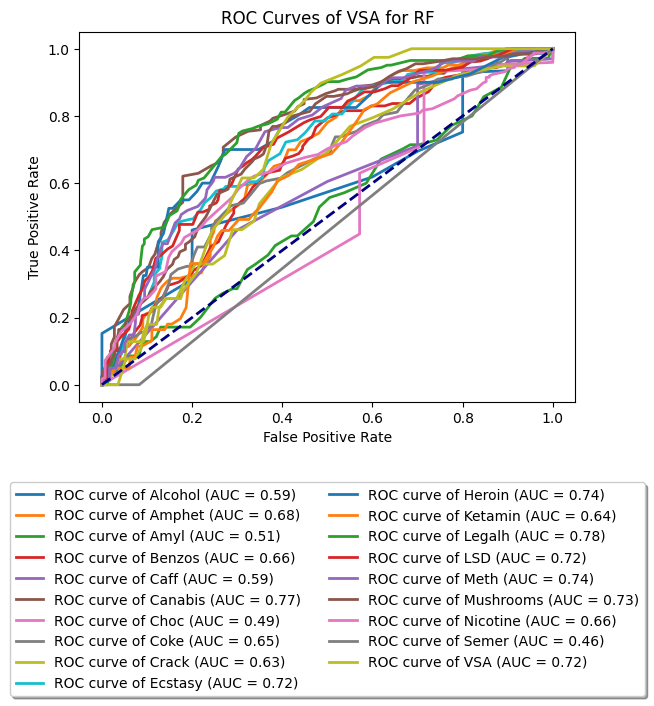

In [209]:
list_auc2 = []
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']

for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=50)
    
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc_score = auc(fpr, tpr)   
    list_auc2.append(auc_score)
    plt.plot(fpr, tpr, lw=2, label='ROC curve of ' + str(drug) + ' (AUC = %0.2f)' % auc_score)
    
    report = classification_report(y_test, y_pred)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves of '+str(drug)+' for RF')
plt.legend(loc='lower right')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), shadow=True, ncol=2)
plt.show()

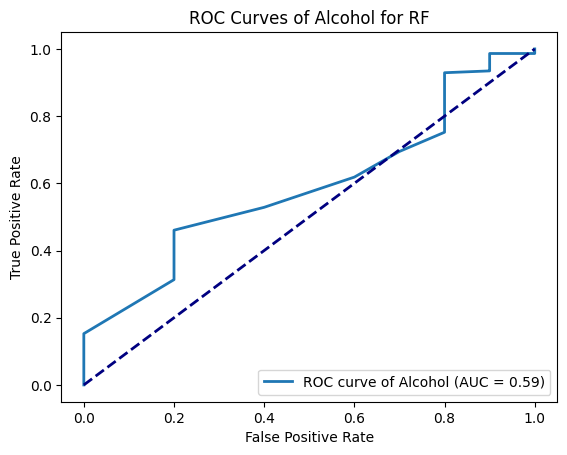

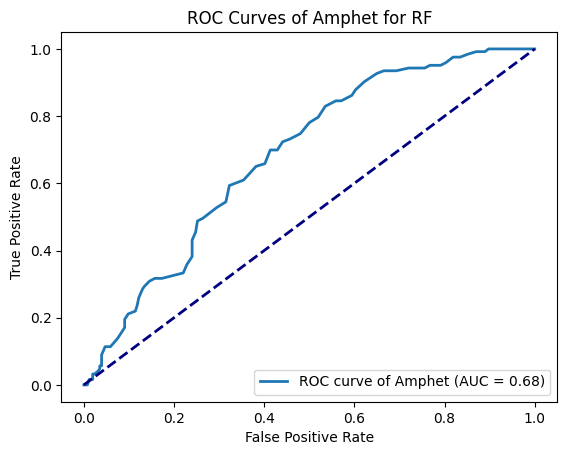

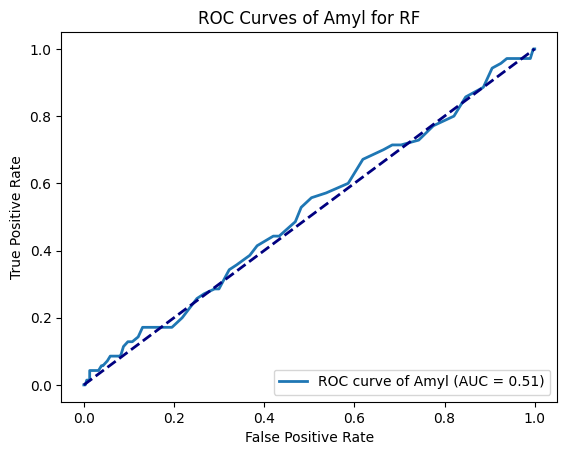

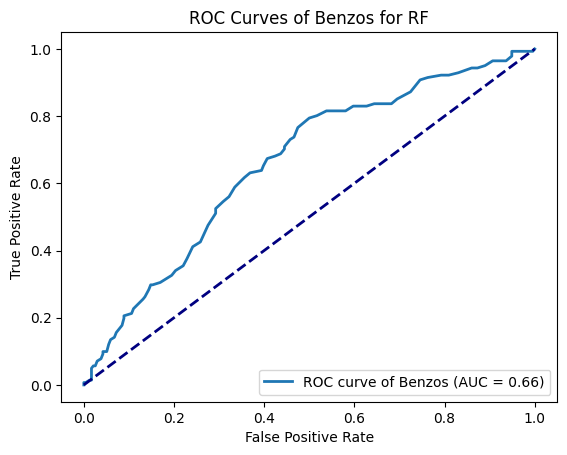

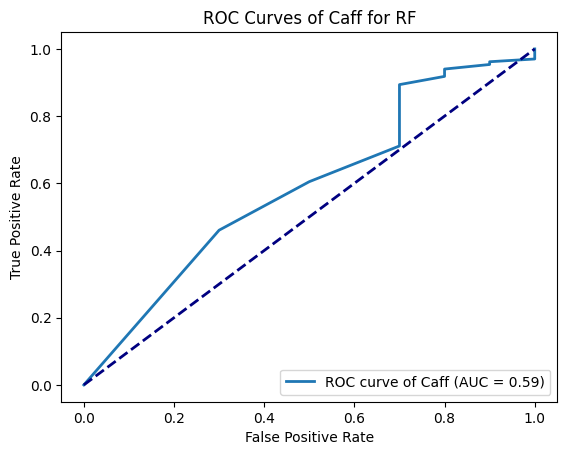

...

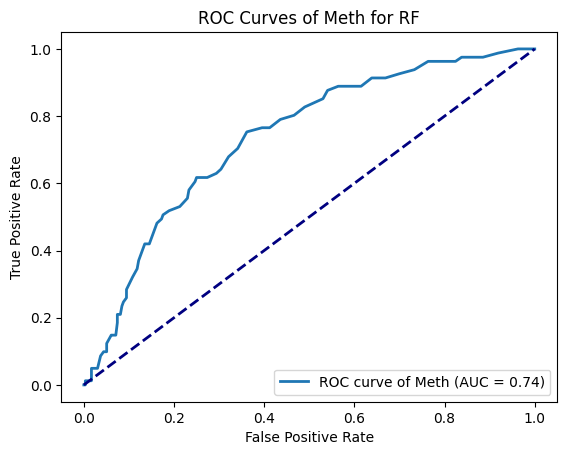

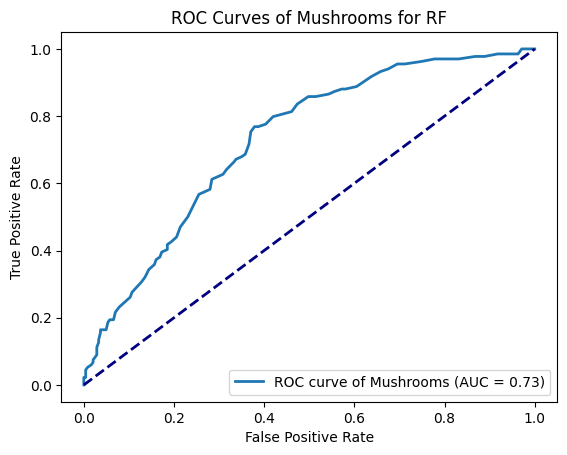

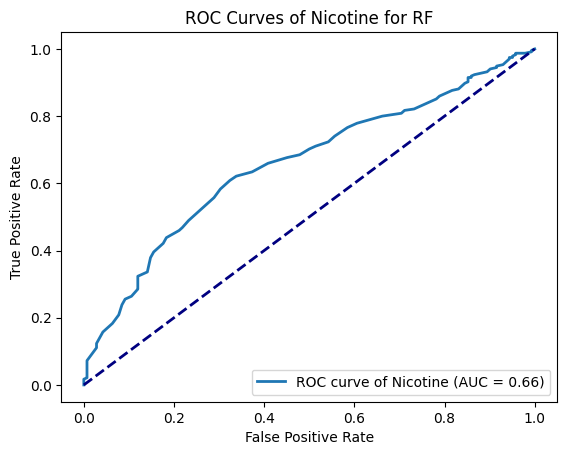

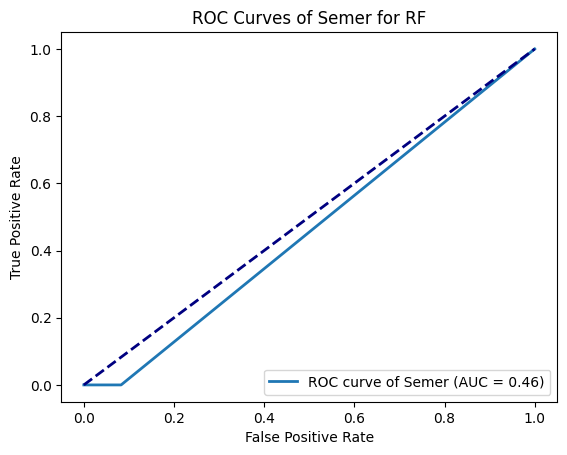

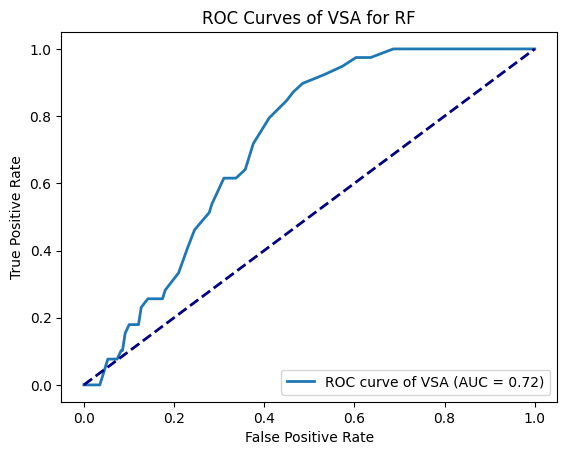

In [210]:
list_auc2 = []
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']

for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=50)
    
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc_score = auc(fpr, tpr)   
    list_auc2.append(auc_score)
    plt.plot(fpr, tpr, lw=2, label='ROC curve of ' + str(drug) + ' (AUC = %0.2f)' % auc_score)
    
    report = classification_report(y_test, y_pred)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves of '+str(drug)+' for RF')
    plt.legend(loc='lower right')
    plt.show()

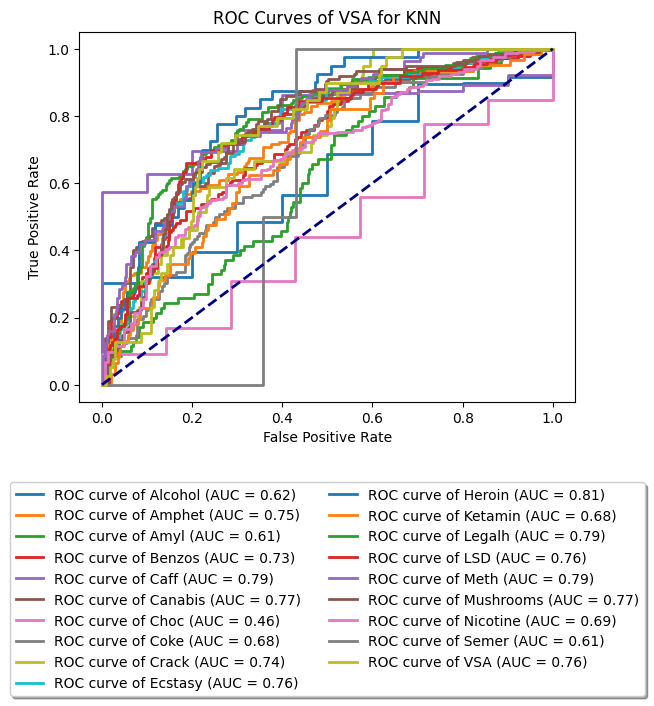

In [92]:
#Knn
list_auc3=[]
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50) #Data separation
    knn = KNeighborsClassifier(n_neighbors=3)
    knn.fit(X_train, y_train)
    y_pred=knn.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    list_accuracy3.append(accuracy)
    report=classification_report(y_test, y_pred)
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc_score = auc(fpr, tpr)   
    list_auc3.append(auc_score)
    plt.plot(fpr, tpr, lw=2, label='ROC curve of ' + str(drug) + ' (AUC = %0.2f)' % auc_score)
    
    report = classification_report(y_test, y_pred)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves of '+str(drug)+' for KNN')
plt.legend(loc='lower right')
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), shadow=True, ncol=2)
plt.show()

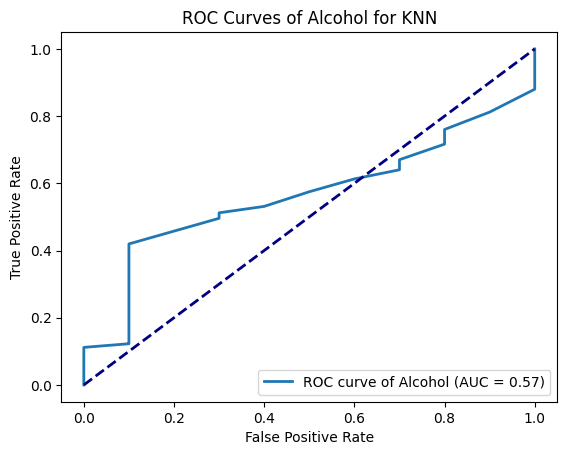

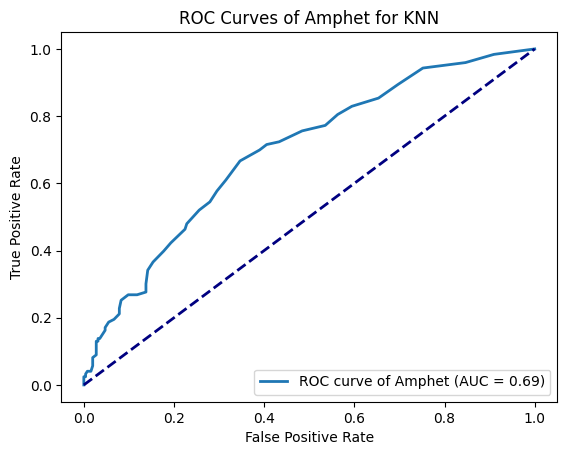

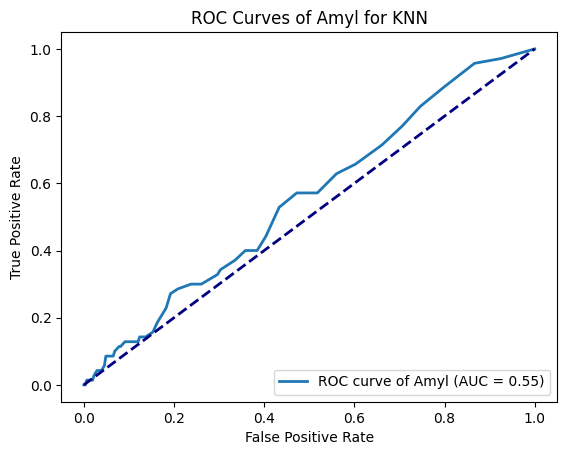

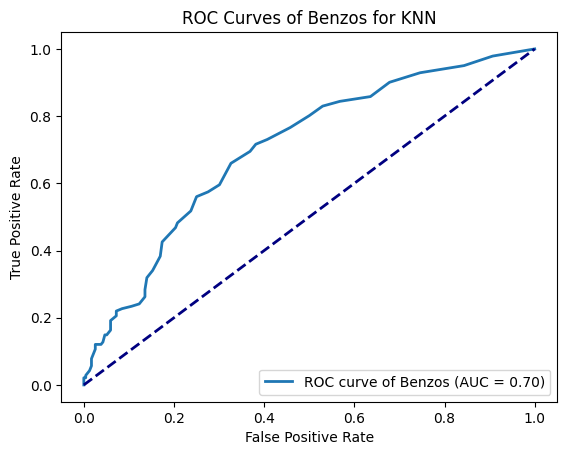

C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metr

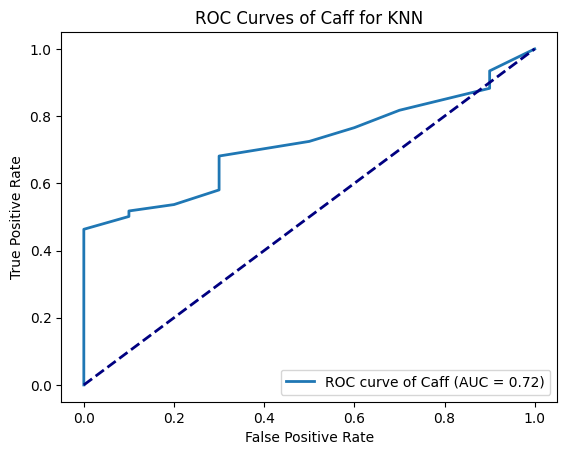

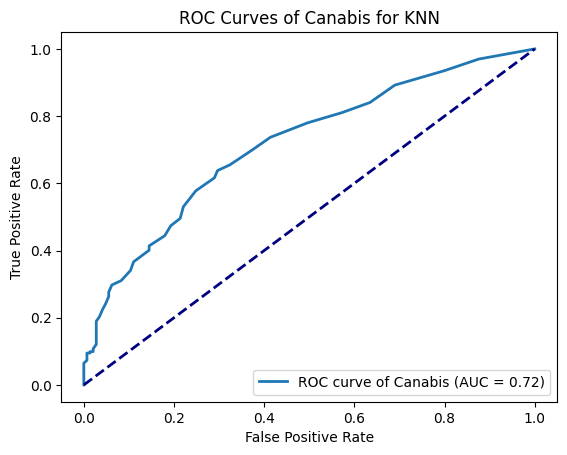

C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metr

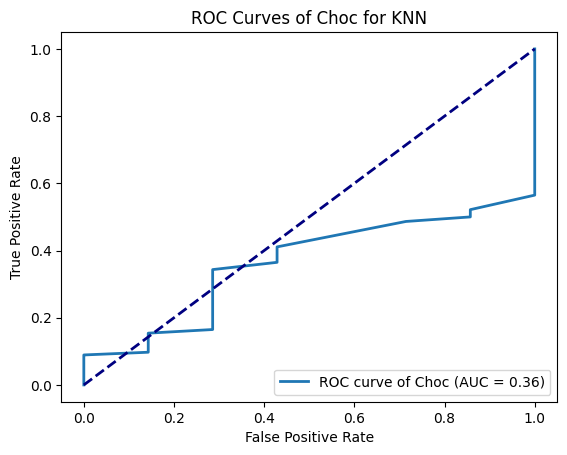

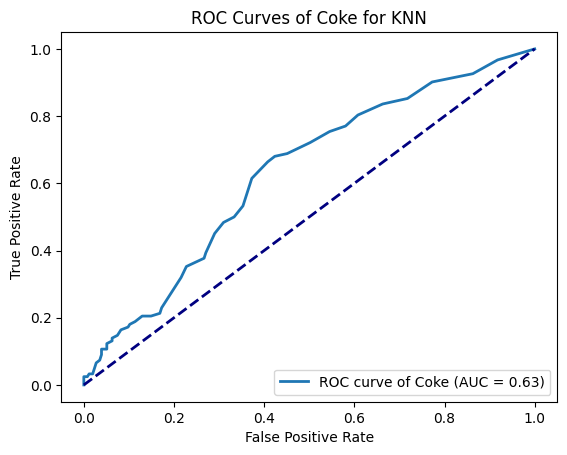

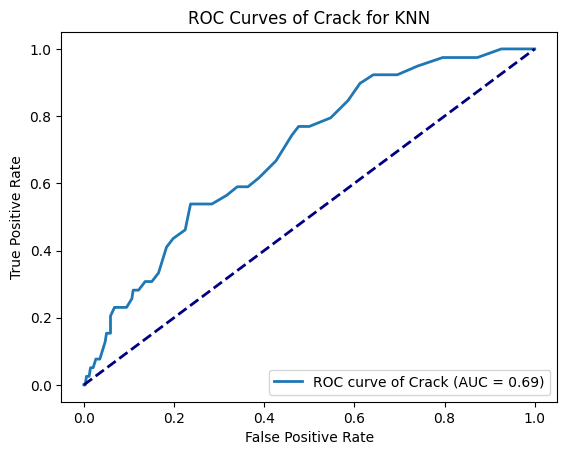

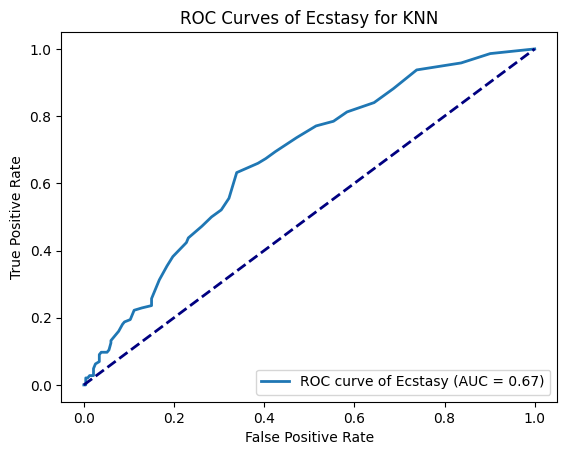

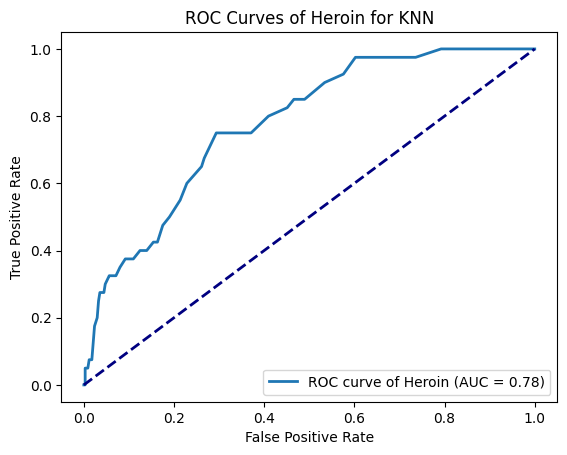

...

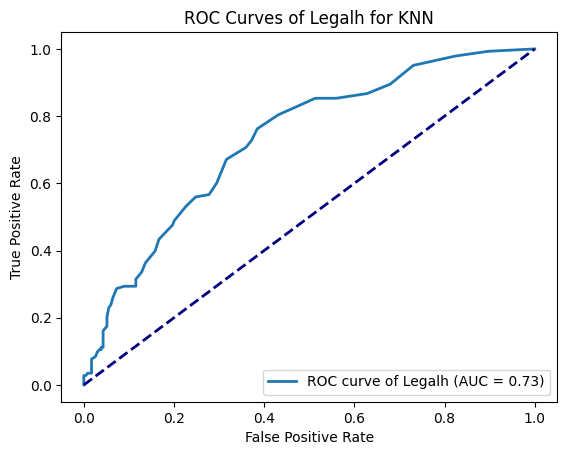

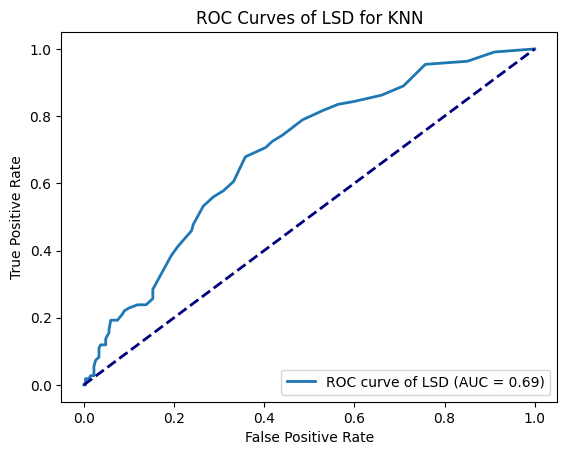

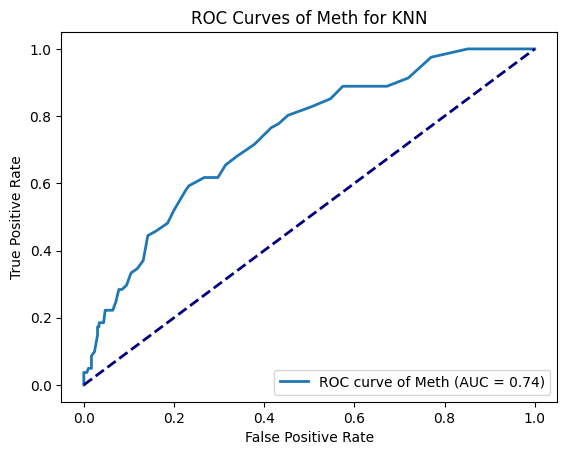

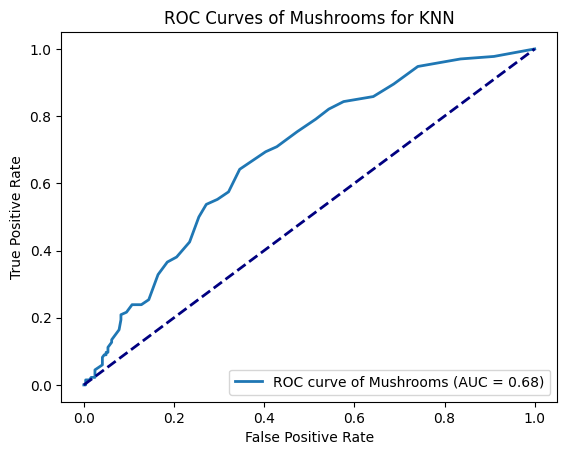

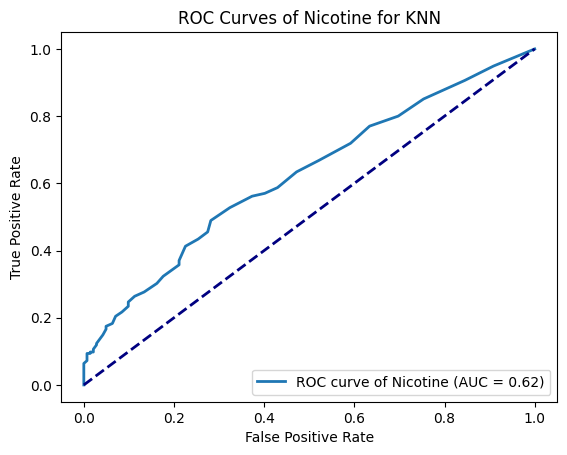

C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elies\anaconda3\lib\site-packages\sklearn\metr

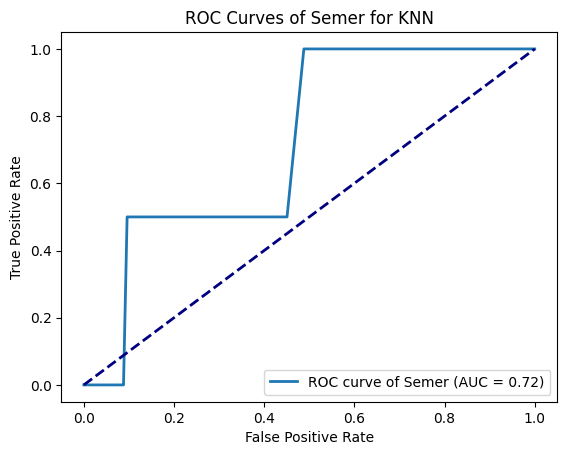

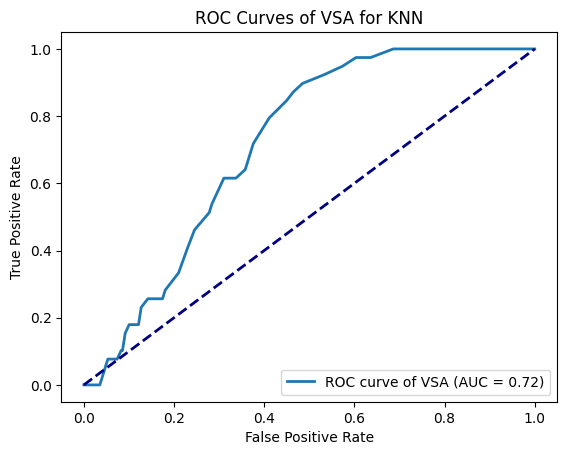

In [212]:
#Knn
list_auc3=[]
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
for drug in drugs_columns:
    df_users1[drug] = df_users1[drug].astype(int)
    X = df_users1[['Nscore','Escore','Oscore','Ascore','Cscore']]
    y = df_users1[drug]
    X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=50) #Data separation
    knn = KNeighborsClassifier(n_neighbors=3)
    knn.fit(X_train, y_train)
    y_pred=knn.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    list_accuracy3.append(accuracy)
    report=classification_report(y_test, y_pred)
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    auc_score = auc(fpr, tpr)   
    list_auc3.append(auc_score)
    plt.plot(fpr, tpr, lw=2, label='ROC curve of ' + str(drug) + ' (AUC = %0.2f)' % auc_score)
    
    report = classification_report(y_test, y_pred)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves of '+str(drug)+' for KNN')
    plt.legend(loc='lower right')
    plt.show()

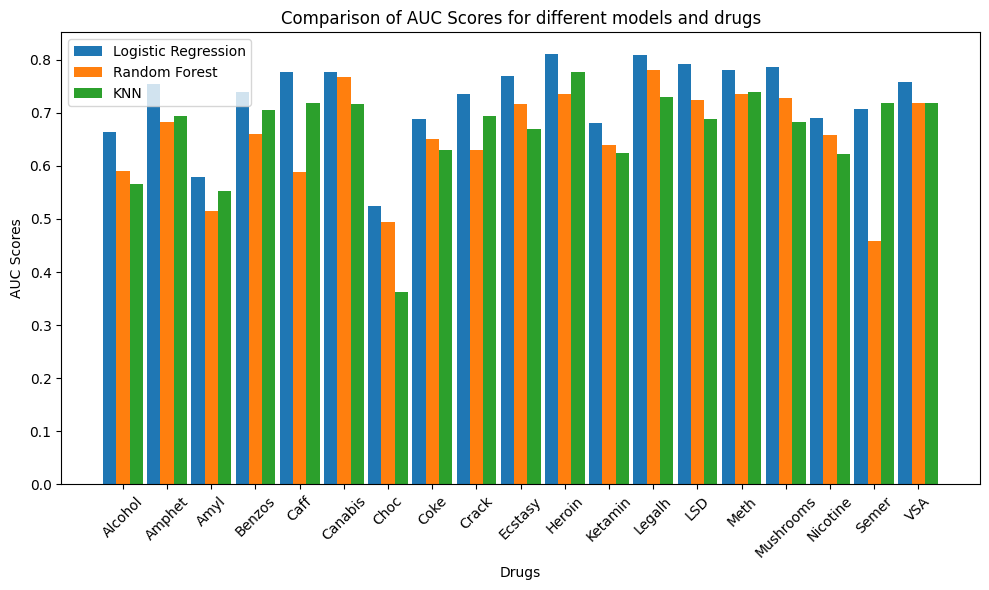

In [224]:
drugs_columns = ['Alcohol', 'Amphet', 'Amyl','Benzos', 'Caff', 'Canabis', 'Choc', 'Coke', 'Crack', 'Ecstasy', 'Heroin', 'Ketamin', 'Legalh', 'LSD', 'Meth', 'Mushrooms', 'Nicotine', 'Semer', 'VSA']
plt.figure(figsize=(10, 6))

bar_width = 0.3
index = range(len(drugs_columns))

plt.bar(index, list_auc1, width=bar_width, label='Logistic Regression')
plt.bar([i + bar_width for i in index], list_auc2, width=bar_width, label='Random Forest')
plt.bar([i + 2 * bar_width for i in index], list_auc3, width=bar_width, label='KNN')

plt.xlabel('Drugs')
plt.ylabel('AUC Scores')
plt.title('Comparison of AUC Scores for different models and drugs')
plt.xticks([i + bar_width for i in index], drugs_columns,rotation=45)
plt.legend()
plt.tight_layout()

plt.show()

To conclude on the models, we observe that Logistic regression is indeed a better model than Random Forest and KNN, because it has a higher AUC score, FOR OUR DATASET. On the other hand, between Random Forest and KNN, we cannot choose the car that depends on drugs.

It should also be noted that each of its models have their own strengths and weaknesses and are adapted to different types of data and prediction tasks. For example, logistic regression is a simple and quick model that works well when the relationship between features and the target variable is approximately linear. On the other hand, Random Forest is a more complex model that can capture nonlinear relationships and interactions between entities, but it is more complex.